# Reading Data

In [ ]:
# conda install -c conda-forge dython

In [ ]:
pip install dash

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.4/10.4 MB 66.3 MB/s eta 0:00:00


In [ ]:
pip install shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 532.9/532.9 kB 5.8 MB/s eta 0:00:00


In [ ]:
pip install catboost

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.7/98.7 MB 3.0 MB/s eta 0:00:00


In [ ]:
# pip install dython

In [ ]:
# pip install lazypredict

In [ ]:
pip install -c conda-forge imbalanced-learn

ERROR: Could not open requirements file: [Errno 2] No such file or directory: 'conda-forge'


In [ ]:
# pip install ipywidgets

In [ ]:
# conda install -c conda-forge ipywidgets

In [ ]:
# pip install pylib

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import datetime as dt
from datetime import datetime
import matplotlib.pyplot as plt
from dateutil.relativedelta import relativedelta
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import SelectKBest, SelectPercentile,mutual_info_classif
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.preprocessing import LabelEncoder
from sklearn import preprocessing
from sklearn.metrics import confusion_matrix,ConfusionMatrixDisplay,accuracy_score,classification_report
from imblearn.over_sampling import SMOTE
from scipy import stats
import random
from scipy.stats import norm
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import RobustScaler
from sklearn.manifold import TSNE
import pandas as pd
import xgboost as xgb

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#Read the data
credit_data_=pd.read_excel('/content/drive/MyDrive/Datasets/SBAnational.xlsx')

In [ ]:
pd.set_option('display.max_columns', None)

In [ ]:
pd.set_option('display.max_rows', None)

In [ ]:
#data types of columns
credit_data_.dtypes

LoanNr_ChkDgt                 int64
Name                         object
City                         object
State                        object
Zip                           int64
Bank                         object
BankState                    object
NAICS                         int64
ApprovalDate         datetime64[ns]
ApprovalFY                   object
Term                          int64
NoEmp                         int64
NewExist                    float64
CreateJob                     int64
RetainedJob                   int64
FranchiseCode                 int64
UrbanRural                    int64
RevLineCr                    object
LowDoc                       object
ChgOffDate           datetime64[ns]
DisbursementDate     datetime64[ns]
DisbursementGross             int64
BalanceGross                  int64
MIS_Status                   object
ChgOffPrinGr                  int64
GrAppv                        int64
SBA_Appv                      int64
dtype: object

In [ ]:
credit_data_['City'].unique().shape

(32582,)

In [ ]:
credit_data_.head()

,LoanNr_ChkDgt,Name,City,State,Zip,Bank,BankState,NAICS,ApprovalDate,ApprovalFY,Term,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,ChgOffDate,DisbursementDate,DisbursementGross,BalanceGross,MIS_Status,ChgOffPrinGr,GrAppv,SBA_Appv
0,1000014003,ABC HOBBYCRAFT,EVANSVILLE,IN,47711,FIFTH THIRD BANK,OH,451120,1997-02-28,1997,84,4,2.0,0,0,1,0,N,Y,NaT,1999-02-28,60000,0,P I F,0,60000,48000
1,1000024006,LANDMARK BAR & GRILLE (THE),NEW PARIS,IN,46526,1ST SOURCE BANK,IN,722410,1997-02-28,1997,60,2,2.0,0,0,1,0,N,Y,NaT,1997-05-31,40000,0,P I F,0,40000,32000
2,1000034009,"WHITLOCK DDS, TODD M.",BLOOMINGTON,IN,47401,GRANT COUNTY STATE BANK,IN,621210,1997-02-28,1997,180,7,1.0,0,0,1,0,N,N,NaT,1997-12-31,287000,0,P I F,0,287000,215250
3,1000044001,"BIG BUCKS PAWN & JEWELRY, LLC",BROKEN ARROW,OK,74012,1ST NATL BK & TR CO OF BROKEN,OK,0,1997-02-28,1997,60,2,1.0,0,0,1,0,N,Y,NaT,1997-06-30,35000,0,P I F,0,35000,28000
4,1000054004,"ANASTASIA CONFECTIONS, INC.",ORLANDO,FL,32801,FLORIDA BUS. DEVEL CORP,FL,0,1997-02-28,1997,240,14,1.0,7,7,1,0,N,N,NaT,1997-05-14,229000,0,P I F,0,229000,229000


In [ ]:
# To make sure that all values in the columns are uppercase
credit_data_['Name']=credit_data_['Name'].str.upper()
credit_data_['City']=credit_data_['City'].str.upper()
credit_data_['State']=credit_data_['State'].str.upper()
credit_data_['Bank']=credit_data_['Bank'].str.upper()
credit_data_['BankState']=credit_data_['BankState'].str.upper()

In [ ]:
replica_data=credit_data_.copy()

In [ ]:
# replica_data.head()

In [ ]:
credit_data_original=credit_data_.copy(deep=True)

In [ ]:
credit_data_original['DisbursementGross']=credit_data_original['DisbursementGross'].replace('$', "")
credit_data_original['BalanceGross']=credit_data_original['BalanceGross'].replace('$', "")
credit_data_original['ChgOffPrinGr']=credit_data_original['ChgOffPrinGr'].replace('$', "")
credit_data_original['GrAppv']=credit_data_original['GrAppv'].replace('$', "")
credit_data_original['SBA_Appv']=credit_data_original['SBA_Appv'].replace('$', "")

In [ ]:
credit_data_original['LoanNr_ChkDgt']=credit_data_original['LoanNr_ChkDgt'].astype('str')
credit_data_original['Zip']=credit_data_original['Zip'].astype('str')
credit_data_original['NAICS']=credit_data_original['NAICS'].astype('str')
credit_data_original['NewExist']=credit_data_original['NewExist'].astype('str')
credit_data_original['FranchiseCode']=credit_data_original['FranchiseCode'].astype('str')
credit_data_original['UrbanRural']=credit_data_original['UrbanRural'].astype('str')
credit_data_original['RevLineCr']=credit_data_original['RevLineCr'].astype('str')
credit_data_original['LowDoc']=credit_data_original['LowDoc'].astype('str')
credit_data_original['MIS_Status']=credit_data_original['MIS_Status'].astype('str')

In [ ]:
credit_data_original.head(5)

,LoanNr_ChkDgt,Name,City,State,Zip,Bank,BankState,NAICS,ApprovalDate,ApprovalFY,Term,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,ChgOffDate,DisbursementDate,DisbursementGross,BalanceGross,MIS_Status,ChgOffPrinGr,GrAppv,SBA_Appv
0,1000014003,ABC HOBBYCRAFT,EVANSVILLE,IN,47711,FIFTH THIRD BANK,OH,451120,1997-02-28,1997,84,4,2.0,0,0,1,0,N,Y,NaT,1999-02-28,60000,0,P I F,0,60000,48000
1,1000024006,LANDMARK BAR & GRILLE (THE),NEW PARIS,IN,46526,1ST SOURCE BANK,IN,722410,1997-02-28,1997,60,2,2.0,0,0,1,0,N,Y,NaT,1997-05-31,40000,0,P I F,0,40000,32000
2,1000034009,"WHITLOCK DDS, TODD M.",BLOOMINGTON,IN,47401,GRANT COUNTY STATE BANK,IN,621210,1997-02-28,1997,180,7,1.0,0,0,1,0,N,N,NaT,1997-12-31,287000,0,P I F,0,287000,215250
3,1000044001,"BIG BUCKS PAWN & JEWELRY, LLC",BROKEN ARROW,OK,74012,1ST NATL BK & TR CO OF BROKEN,OK,0,1997-02-28,1997,60,2,1.0,0,0,1,0,N,Y,NaT,1997-06-30,35000,0,P I F,0,35000,28000
4,1000054004,"ANASTASIA CONFECTIONS, INC.",ORLANDO,FL,32801,FLORIDA BUS. DEVEL CORP,FL,0,1997-02-28,1997,240,14,1.0,7,7,1,0,N,N,NaT,1997-05-14,229000,0,P I F,0,229000,229000


In [ ]:
credit_data_original['DisbursementGross']=credit_data_original['DisbursementGross'].astype('int')
credit_data_original['BalanceGross']=credit_data_original['BalanceGross'].astype('int')
credit_data_original['ChgOffPrinGr']=credit_data_original['ChgOffPrinGr'].astype('int')
credit_data_original['GrAppv']=credit_data_original['GrAppv'].astype('int')
credit_data_original['SBA_Appv']=credit_data_original['SBA_Appv'].astype('int')

In [ ]:
credit_data_original['MIS_Status'].unique()

array(['P I F', 'CHGOFF', 'nan'], dtype=object)

In [ ]:
credit_data_original['MIS_Status'].value_counts()

P I F     739609
CHGOFF    157558
nan         1997
Name: MIS_Status, dtype: int64

In [ ]:
credit_data_original['LowDoc'].unique()

array(['Y', 'N', 'C', '1', 'nan', 'S', 'R', 'A', '0'], dtype=object)

In [ ]:
credit_data_original['RevLineCr'].unique()

array(['N', '0', 'Y', 'T', 'nan', '`', ',', '1', 'C', '3', '2', 'R', '7',
       'A', '5', '.', '4', '-', 'Q'], dtype=object)

# Data Cleaning & Data Transformation

In [ ]:
# credit_data_original=credit_data_original.groupby('State', group_keys=False).apply(lambda x: x.sample(frac=0.3))

In [ ]:
credit_data_original.shape

(899164, 27)

In [ ]:
credit_data_original.isnull().sum()

LoanNr_ChkDgt             0
Name                     25
City                     33
State                    14
Zip                       0
Bank                   1559
BankState              1566
NAICS                     0
ApprovalDate              0
ApprovalFY                0
Term                      0
NoEmp                     0
NewExist                  0
CreateJob                 0
RetainedJob               0
FranchiseCode             0
UrbanRural                0
RevLineCr                 0
LowDoc                    0
ChgOffDate           736465
DisbursementDate       2368
DisbursementGross         0
BalanceGross              0
MIS_Status                0
ChgOffPrinGr              0
GrAppv                    0
SBA_Appv                  0
dtype: int64

In [ ]:
credit_data_original.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 899164 entries, 0 to 899163
Data columns (total 27 columns):
 #   Column             Non-Null Count   Dtype         
---  ------             --------------   -----         
 0   LoanNr_ChkDgt      899164 non-null  object        
 1   Name               899139 non-null  object        
 2   City               899131 non-null  object        
 3   State              899150 non-null  object        
 4   Zip                899164 non-null  object        
 5   Bank               897605 non-null  object        
 6   BankState          897598 non-null  object        
 7   NAICS              899164 non-null  object        
 8   ApprovalDate       899164 non-null  datetime64[ns]
 9   ApprovalFY         899164 non-null  object        
 10  Term               899164 non-null  int64         
 11  NoEmp              899164 non-null  int64         
 12  NewExist           899164 non-null  object        
 13  CreateJob          899164 non-null  int64   

In [ ]:
credit_data_original.describe()

,Term,NoEmp,CreateJob,RetainedJob,DisbursementGross,BalanceGross,ChgOffPrinGr,GrAppv,SBA_Appv
count,899164.000000,899164.000000,899164.000000,899164.000000,8.991640e+05,899164.000000,8.991640e+05,8.991640e+05,8.991640e+05
mean,110.773078,11.411353,8.430376,10.797257,2.011540e+05,2.989349,1.350330e+04,1.926870e+05,1.494888e+05
std,78.857305,74.108196,236.688165,237.120600,2.876408e+05,1442.161912,6.515229e+04,2.832634e+05,2.284146e+05
min,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00,2.000000e+02,1.000000e+02
25%,60.000000,2.000000,0.000000,0.000000,4.200000e+04,0.000000,0.000000e+00,3.500000e+04,2.125000e+04
50%,84.000000,4.000000,0.000000,1.000000,1.000000e+05,0.000000,0.000000e+00,9.000000e+04,6.125000e+04
75%,120.000000,10.000000,1.000000,4.000000,2.380000e+05,0.000000,0.000000e+00,2.250000e+05,1.750000e+05
max,569.000000,9999.000000,8800.000000,9500.000000,1.144632e+07,996262.000000,3.512596e+06,5.472000e+06,5.472000e+06


In [ ]:
#check duplication
credit_data_original.duplicated().sum()

0

In [ ]:
credit_data_original.drop(columns=['ApprovalFY','ChgOffDate','Zip'],inplace=True)

In [ ]:
credit_data_original.isnull().sum()

LoanNr_ChkDgt           0
Name                   25
City                   33
State                  14
Bank                 1559
BankState            1566
NAICS                   0
ApprovalDate            0
Term                    0
NoEmp                   0
NewExist                0
CreateJob               0
RetainedJob             0
FranchiseCode           0
UrbanRural              0
RevLineCr               0
LowDoc                  0
DisbursementDate     2368
DisbursementGross       0
BalanceGross            0
MIS_Status              0
ChgOffPrinGr            0
GrAppv                  0
SBA_Appv                0
dtype: int64

In [ ]:
columns=credit_data_original.loc[:,['Name','City','State','Bank','BankState']]

In [ ]:
for i in columns:
    credit_data_original[i]=credit_data_original[i].str.replace(r"\([^()]*\)", "") # Remove any parentheses and their contents
    credit_data_original[i]=credit_data_original[i].str.replace(r"[.\-/\&]", "")

<ipython-input-35-57c674965a92>:2: FutureWarning: The default value of regex will change from True to False in a future version.
  credit_data_original[i]=credit_data_original[i].str.replace(r"\([^()]*\)", "") # Remove any parentheses and their contents
<ipython-input-35-57c674965a92>:3: FutureWarning: The default value of regex will change from True to False in a future version.
  credit_data_original[i]=credit_data_original[i].str.replace(r"[.\-/\&]", "")


In [ ]:
credit_data_original.shape

(899164, 24)

In [ ]:
credit_data_original.isnull().sum()

LoanNr_ChkDgt           0
Name                   25
City                   33
State                  14
Bank                 1559
BankState            1566
NAICS                   0
ApprovalDate            0
Term                    0
NoEmp                   0
NewExist                0
CreateJob               0
RetainedJob             0
FranchiseCode           0
UrbanRural              0
RevLineCr               0
LowDoc                  0
DisbursementDate     2368
DisbursementGross       0
BalanceGross            0
MIS_Status              0
ChgOffPrinGr            0
GrAppv                  0
SBA_Appv                0
dtype: int64

In [ ]:
'''the maximum loan amount is $5 million. For certain energy projects, the borrower can receive a 504 loan for up to $5.5 million per project, for up to three projects not to exceed $16.5 million total.
based on NAICS, the industry isn't energy. it industry is Professional, scientific, and technical services'''
credit_data_original.loc[credit_data_original['SBA_Appv']>5000000.00,:]

,LoanNr_ChkDgt,Name,City,State,Bank,BankState,NAICS,ApprovalDate,Term,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,DisbursementDate,DisbursementGross,BalanceGross,MIS_Status,ChgOffPrinGr,GrAppv,SBA_Appv
452398,4386445005,SIMON PLC ATTORNEYS COUNSELO,BLOOMFIELD HILLS,MI,SBA DENVER FINANCE CENTER,CO,541110,2010-11-24,240,30,1.0,15,0,0,1,nan,N,2013-06-12,5472000,0,P I F,0,5472000,5472000


In [ ]:
credit_data_original.drop('DisbursementGross',inplace=True,axis=1)

In [ ]:
credit_data_original.loc[credit_data_original['Term']==0.0,:].shape

(810, 23)

In [ ]:
Term_zero=credit_data_original.loc[credit_data_original['Term']==0.0,:]

In [ ]:
Term_zero['MIS_Status'].value_counts()

CHGOFF    734
P I F      72
nan         4
Name: MIS_Status, dtype: int64

In [ ]:
credit_data_original.drop(credit_data_original[credit_data_original.Term==0.0].index,inplace=True)

In [ ]:
credit_data_original.shape

(898354, 23)

In [ ]:
Noemp_zero=credit_data_original.loc[credit_data_original['NoEmp']==0.0,:]

In [ ]:
Noemp_zero.shape

(6623, 23)

In [ ]:
Noemp_zero['MIS_Status'].value_counts()

P I F     5058
CHGOFF    1555
nan         10
Name: MIS_Status, dtype: int64

In [ ]:
Noemp_zero[['NewExist','CreateJob','RetainedJob']][:100]

,NewExist,CreateJob,RetainedJob
1089,2.0,0,0
1092,2.0,0,0
1463,2.0,0,0
1517,2.0,0,0
1590,2.0,0,0
1624,2.0,0,0
1718,2.0,0,0
1817,2.0,0,0
2320,2.0,0,0
2387,2.0,0,0


In [ ]:
RetainedJob_zero=credit_data_original.loc[credit_data_original['RetainedJob']==0.0,:]

In [ ]:
RetainedJob_zero.shape

(440175, 23)

In [ ]:
RetainedJob_zero[['NewExist','CreateJob']][:50]

,NewExist,CreateJob
0,2.0,0
1,2.0,0
2,1.0,0
3,1.0,0
5,1.0,0
6,2.0,0
7,2.0,0
8,2.0,0
9,2.0,0
10,2.0,0


In [ ]:
RetainedJob_zero['MIS_Status'].value_counts()

P I F     397629
CHGOFF     42118
nan          428
Name: MIS_Status, dtype: int64

In [ ]:
credit_data_original['Total_jobs']=credit_data_original['CreateJob']+credit_data_original['RetainedJob']

In [ ]:
credit_data_original.loc[credit_data_original['Total_jobs']==0.0,:].shape

(387158, 24)

In [ ]:
Total_jobs_zero=credit_data_original.loc[credit_data_original['Total_jobs']==0.0,:]

In [ ]:
Total_jobs_zero['MIS_Status'].value_counts()

P I F     348917
CHGOFF     37835
nan          406
Name: MIS_Status, dtype: int64

In [ ]:
Total_jobs_zero['NewExist'].value_counts()

1.0    263359
2.0    122982
0.0       813
nan         4
Name: NewExist, dtype: int64

In [ ]:
Total_jobs_zero.head()

,LoanNr_ChkDgt,Name,City,State,Bank,BankState,NAICS,ApprovalDate,Term,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,DisbursementDate,BalanceGross,MIS_Status,ChgOffPrinGr,GrAppv,SBA_Appv,Total_jobs
0,1000014003,ABC HOBBYCRAFT,EVANSVILLE,IN,FIFTH THIRD BANK,OH,451120,1997-02-28,84,4,2.0,0,0,1,0,N,Y,1999-02-28,0,P I F,0,60000,48000,0
1,1000024006,LANDMARK BAR GRILLE,NEW PARIS,IN,1ST SOURCE BANK,IN,722410,1997-02-28,60,2,2.0,0,0,1,0,N,Y,1997-05-31,0,P I F,0,40000,32000,0
2,1000034009,"WHITLOCK DDS, TODD M",BLOOMINGTON,IN,GRANT COUNTY STATE BANK,IN,621210,1997-02-28,180,7,1.0,0,0,1,0,N,N,1997-12-31,0,P I F,0,287000,215250,0
3,1000044001,"BIG BUCKS PAWN JEWELRY, LLC",BROKEN ARROW,OK,1ST NATL BK TR CO OF BROKEN,OK,0,1997-02-28,60,2,1.0,0,0,1,0,N,Y,1997-06-30,0,P I F,0,35000,28000,0
5,1000084002,"BT SCREW MACHINE COMPANY, INC",PLAINVILLE,CT,"TD BANK, NATIONAL ASSOCIATION",DE,332721,1997-02-28,120,19,1.0,0,0,1,0,N,N,1997-06-30,0,P I F,0,517000,387750,0


In [ ]:
credit_data_original.head()

,LoanNr_ChkDgt,Name,City,State,Bank,BankState,NAICS,ApprovalDate,Term,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,DisbursementDate,BalanceGross,MIS_Status,ChgOffPrinGr,GrAppv,SBA_Appv,Total_jobs
0,1000014003,ABC HOBBYCRAFT,EVANSVILLE,IN,FIFTH THIRD BANK,OH,451120,1997-02-28,84,4,2.0,0,0,1,0,N,Y,1999-02-28,0,P I F,0,60000,48000,0
1,1000024006,LANDMARK BAR GRILLE,NEW PARIS,IN,1ST SOURCE BANK,IN,722410,1997-02-28,60,2,2.0,0,0,1,0,N,Y,1997-05-31,0,P I F,0,40000,32000,0
2,1000034009,"WHITLOCK DDS, TODD M",BLOOMINGTON,IN,GRANT COUNTY STATE BANK,IN,621210,1997-02-28,180,7,1.0,0,0,1,0,N,N,1997-12-31,0,P I F,0,287000,215250,0
3,1000044001,"BIG BUCKS PAWN JEWELRY, LLC",BROKEN ARROW,OK,1ST NATL BK TR CO OF BROKEN,OK,0,1997-02-28,60,2,1.0,0,0,1,0,N,Y,1997-06-30,0,P I F,0,35000,28000,0
4,1000054004,"ANASTASIA CONFECTIONS, INC",ORLANDO,FL,FLORIDA BUS DEVEL CORP,FL,0,1997-02-28,240,14,1.0,7,7,1,0,N,N,1997-05-14,0,P I F,0,229000,229000,14


In [ ]:
credit_data_original['Industry']=credit_data_original['NAICS'].astype('str').apply(lambda x: x[:2])

In [ ]:
credit_data_original['Industry']=credit_data_original['Industry'].map({
    '11':	'Agriculture, forestry, fishing and hunting',
'21':	'Mining, quarrying, and oil and gas extraction',
'22':'Utilities',
'23':	'Construction',
'31':'Manufacturing',
'32':	'Manufacturing',
'33':'Manufacturing',
'42':'Wholesale trade',
'44':	'Retail trade',
'45':'Retail trade',
'48':'Transportation and warehousing',
'49':	'Transportation and warehousing',
'51':	'Information',
'52':	'Finance and insurance',
'53':	'Real estate and rental and leasing',
'54':	'Professional, scientific, and technical services',
'55':	'Management of companies and enterprises',
'56':	'Administrative and support and waste management and remediation services',
'61':	'Educational services',
'62':	'Health care and social assistance',
'71':	'Arts, entertainment, and recreation',
'72':	'Accommodation and food services',
'81':	'Other services (except public administration)' ,
'92': 'Public administration'
})

In [ ]:
credit_data_original['Industry'].unique()

array(['Retail trade', 'Accommodation and food services',
       'Health care and social assistance', nan, 'Manufacturing',
       'Other services (except public administration)', 'Construction',
       'Wholesale trade', 'Educational services',
       'Real estate and rental and leasing',
       'Professional, scientific, and technical services', 'Information',
       'Arts, entertainment, and recreation', 'Finance and insurance',
       'Mining, quarrying, and oil and gas extraction',
       'Administrative and support and waste management and remediation services',
       'Transportation and warehousing',
       'Agriculture, forestry, fishing and hunting',
       'Public administration', 'Utilities',
       'Management of companies and enterprises'], dtype=object)

In [ ]:
credit_data_original.shape

(898354, 25)

In [ ]:
credit_data_original['LowDoc'].value_counts()

N      782085
Y      110265
nan      2580
0        1491
C         757
S         603
A         497
R          75
1           1
Name: LowDoc, dtype: int64

In [ ]:
credit_data_original['LowDoc']=credit_data_original['LowDoc'].astype(str)

In [ ]:
credit_data_original['MIS_Status'].unique()

array(['P I F', 'CHGOFF', 'nan'], dtype=object)

In [ ]:
credit_data_original['RevLineCr'].unique()

array(['N', '0', 'Y', 'T', 'nan', '`', ',', '1', 'C', '3', '2', 'R', '7',
       'A', '5', '.', '4', '-', 'Q'], dtype=object)

In [ ]:
credit_data_original['portion SBA/GrAppv']=credit_data_original['SBA_Appv']/credit_data_original['GrAppv']

In [ ]:
credit_data_original.loc[credit_data_original['portion SBA/GrAppv']==0,:].shape

(0, 26)

In [ ]:
credit_data_original.shape

(898354, 26)

In [ ]:
credit_data_original['ApprovalDate']=credit_data_original['ApprovalDate'].dt.date
credit_data_original['DisbursementDate']=credit_data_original['DisbursementDate'].dt.date

In [ ]:
credit_data_original['duration_between_approval_date_and_disbursement_date']=((credit_data_original['DisbursementDate']-credit_data_original['ApprovalDate']).dt.days)

In [ ]:
credit_data_original.head()

,LoanNr_ChkDgt,Name,City,State,Bank,BankState,NAICS,ApprovalDate,Term,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,DisbursementDate,BalanceGross,MIS_Status,ChgOffPrinGr,GrAppv,SBA_Appv,Total_jobs,Industry,portion SBA/GrAppv,duration_between_approval_date_and_disbursement_date
0,1000014003,ABC HOBBYCRAFT,EVANSVILLE,IN,FIFTH THIRD BANK,OH,451120,1997-02-28,84,4,2.0,0,0,1,0,N,Y,1999-02-28,0,P I F,0,60000,48000,0,Retail trade,0.80,730.0
1,1000024006,LANDMARK BAR GRILLE,NEW PARIS,IN,1ST SOURCE BANK,IN,722410,1997-02-28,60,2,2.0,0,0,1,0,N,Y,1997-05-31,0,P I F,0,40000,32000,0,Accommodation and food services,0.80,92.0
2,1000034009,"WHITLOCK DDS, TODD M",BLOOMINGTON,IN,GRANT COUNTY STATE BANK,IN,621210,1997-02-28,180,7,1.0,0,0,1,0,N,N,1997-12-31,0,P I F,0,287000,215250,0,Health care and social assistance,0.75,306.0
3,1000044001,"BIG BUCKS PAWN JEWELRY, LLC",BROKEN ARROW,OK,1ST NATL BK TR CO OF BROKEN,OK,0,1997-02-28,60,2,1.0,0,0,1,0,N,Y,1997-06-30,0,P I F,0,35000,28000,0,NaN,0.80,122.0
4,1000054004,"ANASTASIA CONFECTIONS, INC",ORLANDO,FL,FLORIDA BUS DEVEL CORP,FL,0,1997-02-28,240,14,1.0,7,7,1,0,N,N,1997-05-14,0,P I F,0,229000,229000,14,NaN,1.00,75.0


In [ ]:
credit_data_original.loc[credit_data_original['duration_between_approval_date_and_disbursement_date']<0,:].shape

(808, 27)

In [ ]:
firms_loans=credit_data_original.loc[credit_data_original['duration_between_approval_date_and_disbursement_date']<0,:]

In [ ]:
firms_loans['Name'].unique().shape

(802,)

In [ ]:
credit_data_original.drop(credit_data_original[credit_data_original.duration_between_approval_date_and_disbursement_date <0].index,inplace=True)

In [ ]:
firms_loans[['Name','MIS_Status']][:5]

,Name,MIS_Status
481,"AQUA BELLA ENTERPRISES, INC",CHGOFF
1548,EARL'S MACHINE SHOP,P I F
1655,MACHINE SHOP SERVICES INC,P I F
6907,ADVANTAGE ASIA,P I F
13804,LANSING CONSTRUCTION,P I F


In [ ]:
firms_loans['MIS_Status'].value_counts()

P I F     739
CHGOFF     68
nan         1
Name: MIS_Status, dtype: int64

In [ ]:
firms_loans.loc[firms_loans['MIS_Status']=='nan',:]

,LoanNr_ChkDgt,Name,City,State,Bank,BankState,NAICS,ApprovalDate,Term,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,DisbursementDate,BalanceGross,MIS_Status,ChgOffPrinGr,GrAppv,SBA_Appv,Total_jobs,Industry,portion SBA/GrAppv,duration_between_approval_date_and_disbursement_date
784531,8321543005,EXPLORER GRAPHICS,KANSAS CITY,MO,BANK OF AMERICA NATL ASSOC,NC,0,1995-05-08,36,1,2.0,0,0,1,0,Y,N,1995-04-30,0,nan,0,3000,1500,0,NaN,0.5,-8.0


In [ ]:
credit_data_original = credit_data_original[pd.notnull(credit_data_original['DisbursementDate'])]

In [ ]:
credit_data_original.isnull().sum()

LoanNr_ChkDgt                                                0
Name                                                        25
City                                                        33
State                                                       13
Bank                                                      1502
BankState                                                 1509
NAICS                                                        0
ApprovalDate                                                 0
Term                                                         0
NoEmp                                                        0
NewExist                                                     0
CreateJob                                                    0
RetainedJob                                                  0
FranchiseCode                                                0
UrbanRural                                                   0
RevLineCr                                              

In [ ]:
credit_data_original.shape

(895179, 27)

In [ ]:
credit_data_original['my_date'] = list(map(lambda val: pd.to_datetime(val).date(), credit_data_original['DisbursementDate'].values))

credit_data_original['my_months'] = list(map(lambda val: relativedelta(months=val), credit_data_original['Term'].values))
credit_data_original['my_date_months'] = credit_data_original['my_date'] + credit_data_original['my_months']

In [ ]:
credit_data_original['my_date_months']=credit_data_original['my_date_months'].astype(str)
credit_data_original['Crisis']=np.where ((credit_data_original['my_date_months']>='2007-12-01') & (credit_data_original['my_date_months'] <='2009-06-30'),1,0)
credit_data_original['Crisis'].value_counts()

0    824373
1     70806
Name: Crisis, dtype: int64

In [ ]:
credit_data_original['Loans_Backed_by_Real_Estate']=np.where(credit_data_original['Term']>=240,1,0)

In [ ]:
credit_data_original.head()

,LoanNr_ChkDgt,Name,City,State,Bank,BankState,NAICS,ApprovalDate,Term,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,DisbursementDate,BalanceGross,MIS_Status,ChgOffPrinGr,GrAppv,SBA_Appv,Total_jobs,Industry,portion SBA/GrAppv,duration_between_approval_date_and_disbursement_date,my_date,my_months,my_date_months,Crisis,Loans_Backed_by_Real_Estate
0,1000014003,ABC HOBBYCRAFT,EVANSVILLE,IN,FIFTH THIRD BANK,OH,451120,1997-02-28,84,4,2.0,0,0,1,0,N,Y,1999-02-28,0,P I F,0,60000,48000,0,Retail trade,0.80,730.0,1999-02-28,relativedelta(years=+7),2006-02-28,0,0
1,1000024006,LANDMARK BAR GRILLE,NEW PARIS,IN,1ST SOURCE BANK,IN,722410,1997-02-28,60,2,2.0,0,0,1,0,N,Y,1997-05-31,0,P I F,0,40000,32000,0,Accommodation and food services,0.80,92.0,1997-05-31,relativedelta(years=+5),2002-05-31,0,0
2,1000034009,"WHITLOCK DDS, TODD M",BLOOMINGTON,IN,GRANT COUNTY STATE BANK,IN,621210,1997-02-28,180,7,1.0,0,0,1,0,N,N,1997-12-31,0,P I F,0,287000,215250,0,Health care and social assistance,0.75,306.0,1997-12-31,relativedelta(years=+15),2012-12-31,0,0
3,1000044001,"BIG BUCKS PAWN JEWELRY, LLC",BROKEN ARROW,OK,1ST NATL BK TR CO OF BROKEN,OK,0,1997-02-28,60,2,1.0,0,0,1,0,N,Y,1997-06-30,0,P I F,0,35000,28000,0,NaN,0.80,122.0,1997-06-30,relativedelta(years=+5),2002-06-30,0,0
4,1000054004,"ANASTASIA CONFECTIONS, INC",ORLANDO,FL,FLORIDA BUS DEVEL CORP,FL,0,1997-02-28,240,14,1.0,7,7,1,0,N,N,1997-05-14,0,P I F,0,229000,229000,14,NaN,1.00,75.0,1997-05-14,relativedelta(years=+20),2017-05-14,0,1


In [ ]:
credit_data_original.dtypes

LoanNr_ChkDgt                                            object
Name                                                     object
City                                                     object
State                                                    object
Bank                                                     object
BankState                                                object
NAICS                                                    object
ApprovalDate                                             object
Term                                                      int64
NoEmp                                                     int64
NewExist                                                 object
CreateJob                                                 int64
RetainedJob                                               int64
FranchiseCode                                            object
UrbanRural                                               object
RevLineCr                               

In [ ]:
credit_data_original['DisbursementFiscalYear']=credit_data_original['DisbursementDate'].map(lambda x : x.year)

In [ ]:
credit_data_original.drop(columns=['my_months','my_date_months','my_date','ApprovalDate','NAICS','SBA_Appv','DisbursementDate'],inplace=True)

In [ ]:
credit_data_original.isnull().sum()

LoanNr_ChkDgt                                                0
Name                                                        25
City                                                        33
State                                                       13
Bank                                                      1502
BankState                                                 1509
Term                                                         0
NoEmp                                                        0
NewExist                                                     0
CreateJob                                                    0
RetainedJob                                                  0
FranchiseCode                                                0
UrbanRural                                                   0
RevLineCr                                                    0
LowDoc                                                       0
BalanceGross                                           

In [ ]:
credit_data_original['Industry'].unique()

array(['Retail trade', 'Accommodation and food services',
       'Health care and social assistance', nan, 'Manufacturing',
       'Other services (except public administration)', 'Construction',
       'Wholesale trade', 'Educational services',
       'Real estate and rental and leasing',
       'Professional, scientific, and technical services', 'Information',
       'Arts, entertainment, and recreation', 'Finance and insurance',
       'Mining, quarrying, and oil and gas extraction',
       'Administrative and support and waste management and remediation services',
       'Transportation and warehousing',
       'Agriculture, forestry, fishing and hunting',
       'Public administration', 'Utilities',
       'Management of companies and enterprises'], dtype=object)

In [ ]:
credit_data_original.shape

(895179, 26)

In [ ]:
credit_data_original['Industry']=credit_data_original['Industry'].astype('str')

In [ ]:
credit_data_original['Crisis']=credit_data_original['Crisis'].astype('str')
credit_data_original['Loans_Backed_by_Real_Estate']=credit_data_original['Loans_Backed_by_Real_Estate'].astype('str')


In [ ]:
credit_data_original['The_same_state_or_not']=np.where(credit_data_original['State']==credit_data_original['BankState'],1,0)
credit_data_original['Has_Franchise_code?']=np.where((credit_data_original['FranchiseCode']=='0') | (credit_data_original['FranchiseCode']=='1'),0,1)

In [ ]:
credit_data_original.isnull().sum()

LoanNr_ChkDgt                                              0
Name                                                      25
City                                                      33
State                                                     13
Bank                                                    1502
BankState                                               1509
Term                                                       0
NoEmp                                                      0
NewExist                                                   0
CreateJob                                                  0
RetainedJob                                                0
FranchiseCode                                              0
UrbanRural                                                 0
RevLineCr                                                  0
LowDoc                                                     0
BalanceGross                                               0
MIS_Status              

In [ ]:
credit_data_original.dropna(inplace=True)

In [ ]:
credit_data_original.head()

,LoanNr_ChkDgt,Name,City,State,Bank,BankState,Term,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,BalanceGross,MIS_Status,ChgOffPrinGr,GrAppv,Total_jobs,Industry,portion SBA/GrAppv,duration_between_approval_date_and_disbursement_date,Crisis,Loans_Backed_by_Real_Estate,DisbursementFiscalYear,The_same_state_or_not,Has_Franchise_code?
0,1000014003,ABC HOBBYCRAFT,EVANSVILLE,IN,FIFTH THIRD BANK,OH,84,4,2.0,0,0,1,0,N,Y,0,P I F,0,60000,0,Retail trade,0.80,730.0,0,0,1999,0,0
1,1000024006,LANDMARK BAR GRILLE,NEW PARIS,IN,1ST SOURCE BANK,IN,60,2,2.0,0,0,1,0,N,Y,0,P I F,0,40000,0,Accommodation and food services,0.80,92.0,0,0,1997,1,0
2,1000034009,"WHITLOCK DDS, TODD M",BLOOMINGTON,IN,GRANT COUNTY STATE BANK,IN,180,7,1.0,0,0,1,0,N,N,0,P I F,0,287000,0,Health care and social assistance,0.75,306.0,0,0,1997,1,0
3,1000044001,"BIG BUCKS PAWN JEWELRY, LLC",BROKEN ARROW,OK,1ST NATL BK TR CO OF BROKEN,OK,60,2,1.0,0,0,1,0,N,Y,0,P I F,0,35000,0,nan,0.80,122.0,0,0,1997,1,0
4,1000054004,"ANASTASIA CONFECTIONS, INC",ORLANDO,FL,FLORIDA BUS DEVEL CORP,FL,240,14,1.0,7,7,1,0,N,N,0,P I F,0,229000,14,nan,1.00,75.0,0,1,1997,1,0


In [ ]:
credit_data_original['The_same_state_or_not']=credit_data_original['The_same_state_or_not'].astype('str')
credit_data_original['Has_Franchise_code?']=credit_data_original['Has_Franchise_code?'].astype('str')

In [ ]:
credit_data_original.drop('FranchiseCode',axis=1,inplace=True)

In [ ]:
credit_data_original['RevLineCr'].value_counts()

N      417524
0      257133
Y      199229
T       15153
nan      4497
1          23
R          14
`          11
2           6
C           2
5           1
-           1
4           1
.           1
3           1
A           1
7           1
,           1
Q           1
Name: RevLineCr, dtype: int64

In [ ]:
credit_data_original.dtypes

LoanNr_ChkDgt                                            object
Name                                                     object
City                                                     object
State                                                    object
Bank                                                     object
BankState                                                object
Term                                                      int64
NoEmp                                                     int64
NewExist                                                 object
CreateJob                                                 int64
RetainedJob                                               int64
UrbanRural                                               object
RevLineCr                                                object
LowDoc                                                   object
BalanceGross                                              int64
MIS_Status                              

In [ ]:
credit_data_original.shape

(893601, 27)

In [ ]:
# credit_data_original.dropna(inplace=True)

In [ ]:
# credit_data_original.shape

In [ ]:
numerical_features = credit_data_original.select_dtypes(include=np.number).columns.tolist()

categorical_features = credit_data_original.select_dtypes(include='object').columns.tolist()

In [ ]:
numerical_features

['Term',
 'NoEmp',
 'CreateJob',
 'RetainedJob',
 'BalanceGross',
 'ChgOffPrinGr',
 'GrAppv',
 'Total_jobs',
 'portion SBA/GrAppv',
 'duration_between_approval_date_and_disbursement_date',
 'DisbursementFiscalYear']

In [ ]:
categorical_features

['LoanNr_ChkDgt',
 'Name',
 'City',
 'State',
 'Bank',
 'BankState',
 'NewExist',
 'UrbanRural',
 'RevLineCr',
 'LowDoc',
 'MIS_Status',
 'Industry',
 'Crisis',
 'Loans_Backed_by_Real_Estate',
 'The_same_state_or_not',
 'Has_Franchise_code?']

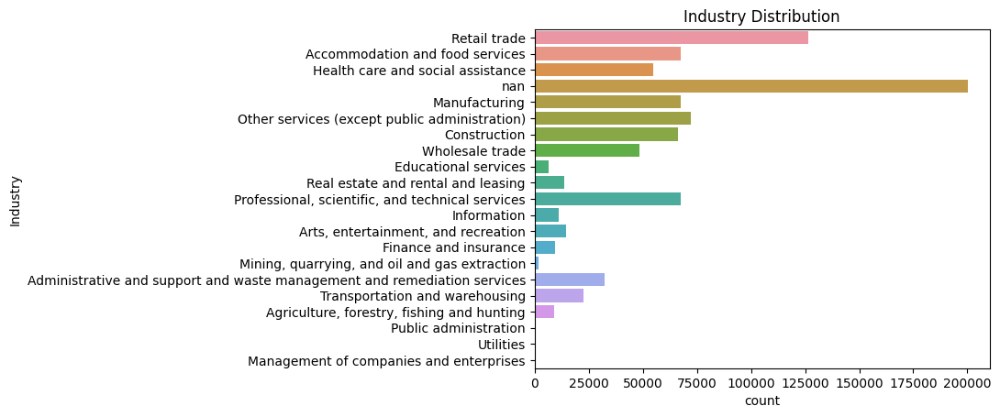

In [ ]:
sns.countplot(data=credit_data_original,y=credit_data_original['Industry'])
plt.title('Industry Distribution')
plt.show()

In [ ]:
categorical_features=['NewExist','UrbanRural','RevLineCr','LowDoc','MIS_Status','Crisis','Loans_Backed_by_Real_Estate','The_same_state_or_not','Has_Franchise_code?']

In [ ]:
type(categorical_features)

list

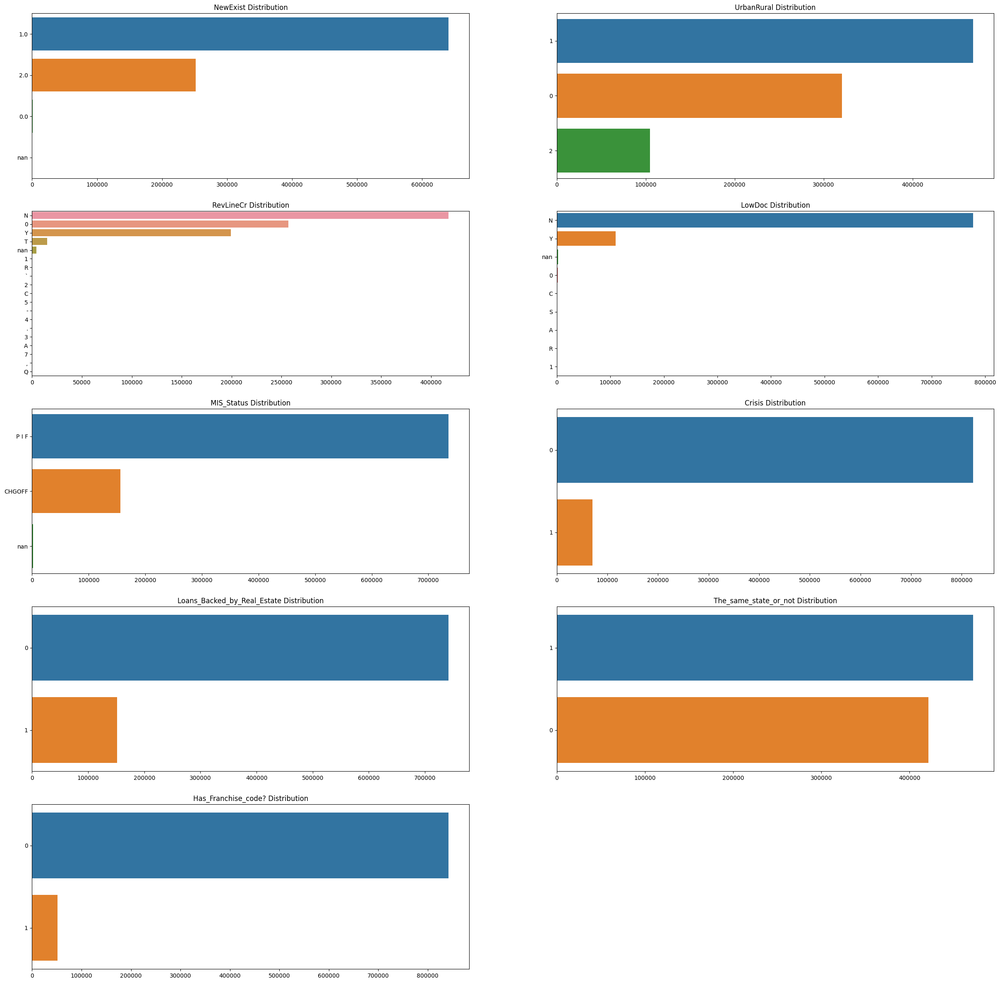

In [ ]:
k=1
plt.figure(figsize=(30,30))

for feature in categorical_features:
    x = credit_data_original[feature].value_counts().index
    y = list(map(lambda value:value, credit_data_original[feature].value_counts()))
    plt.subplot(5,2,k)

    sns.barplot(data=credit_data_original, x=y, y=x)
    plt.title(f'{feature} Distribution')
    k+=1


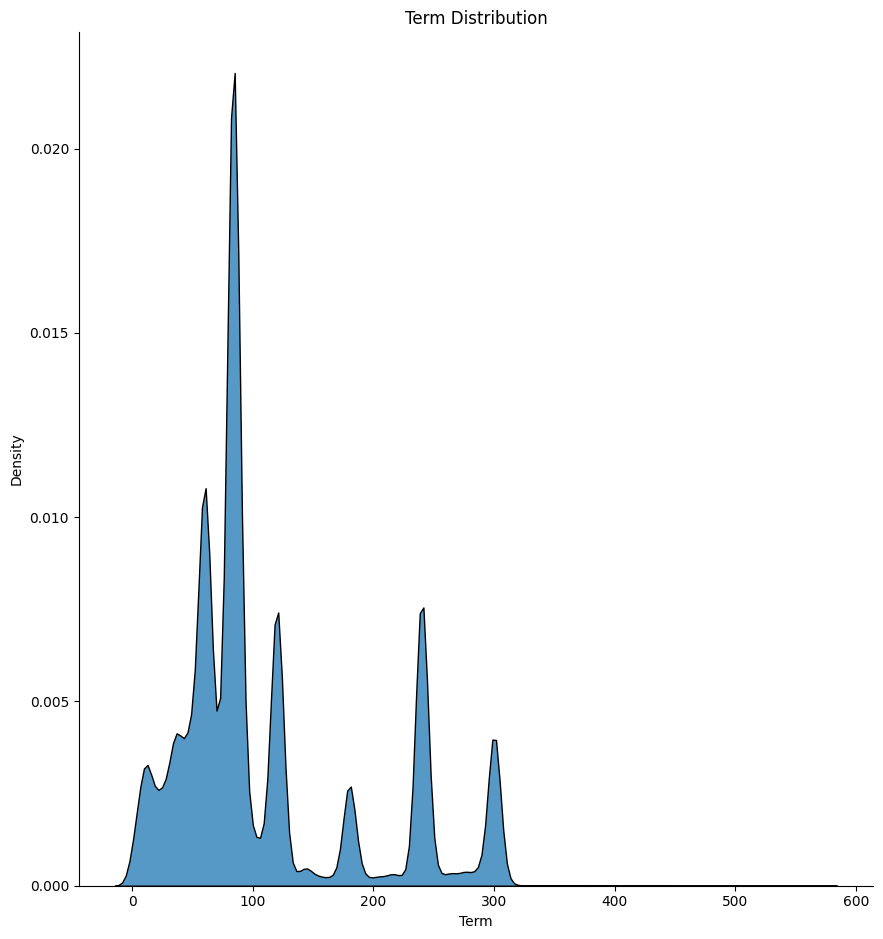

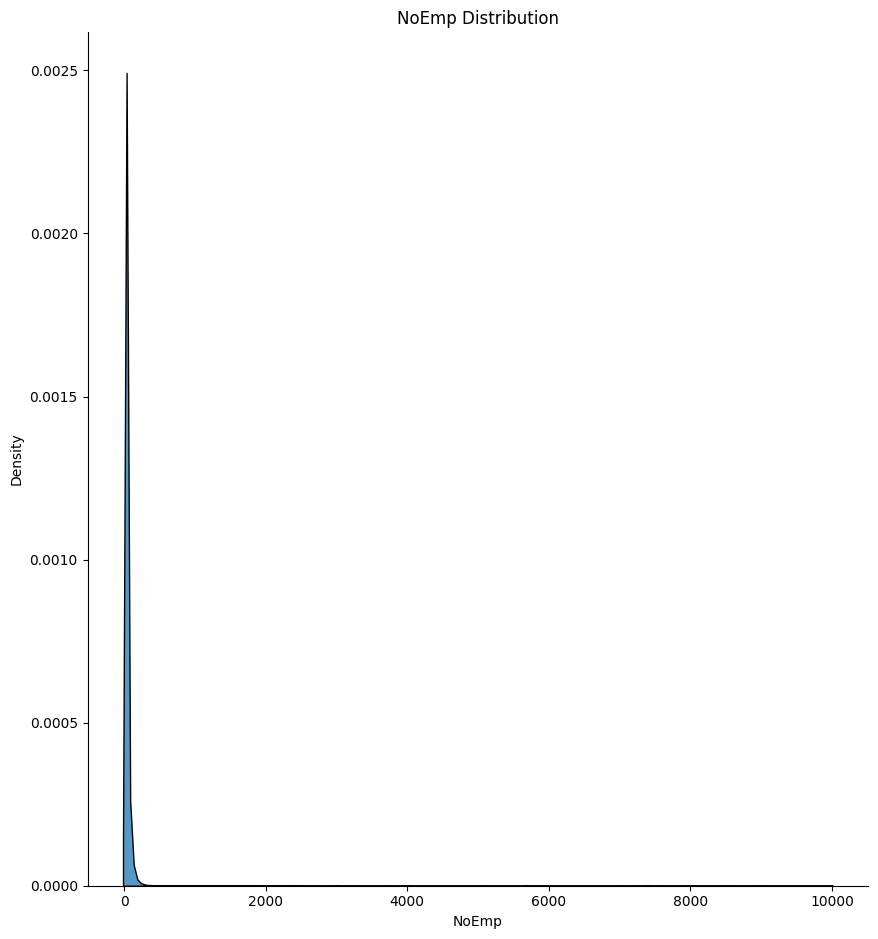

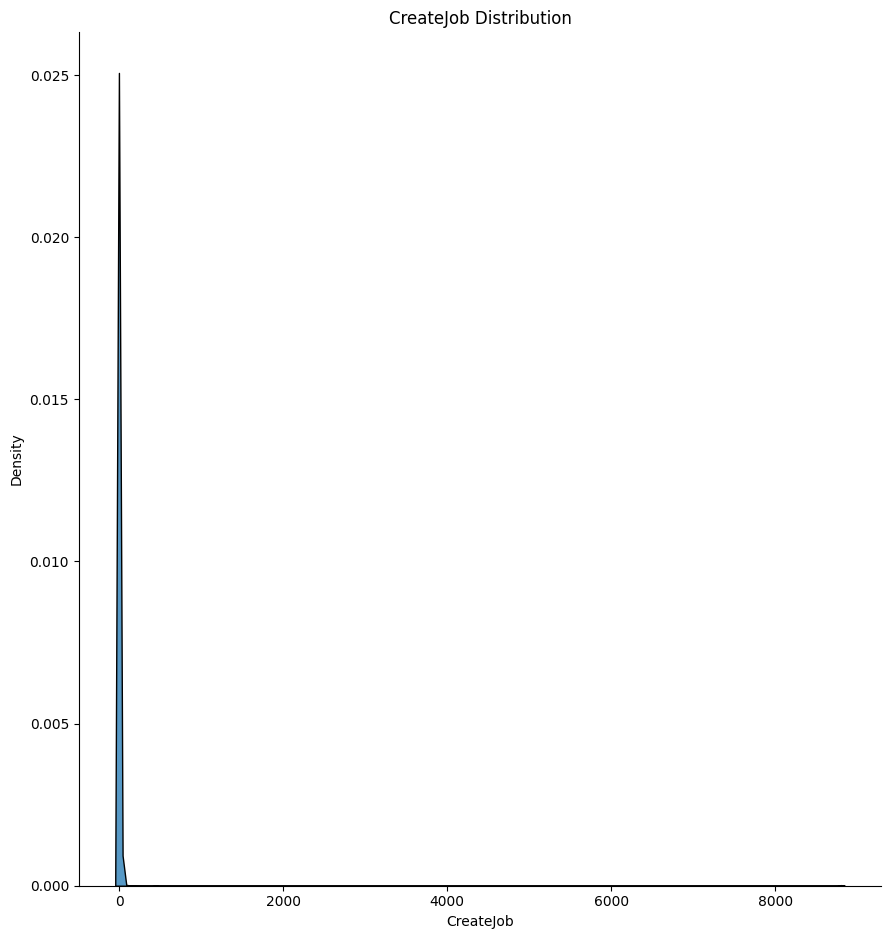

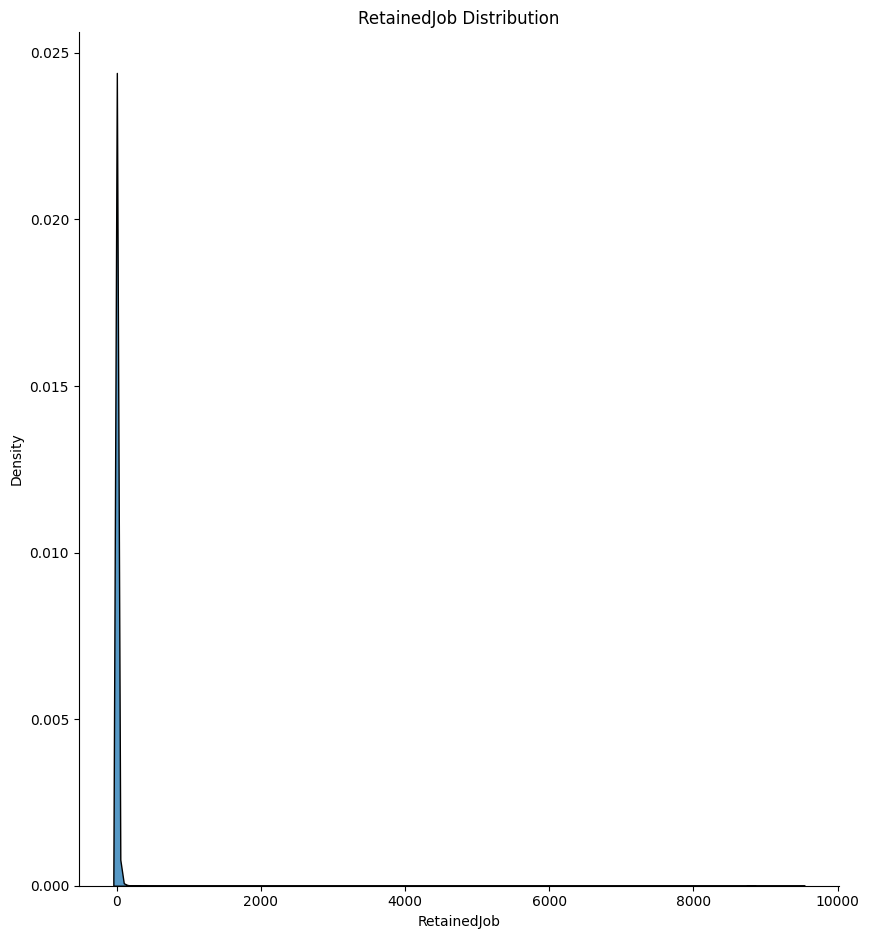

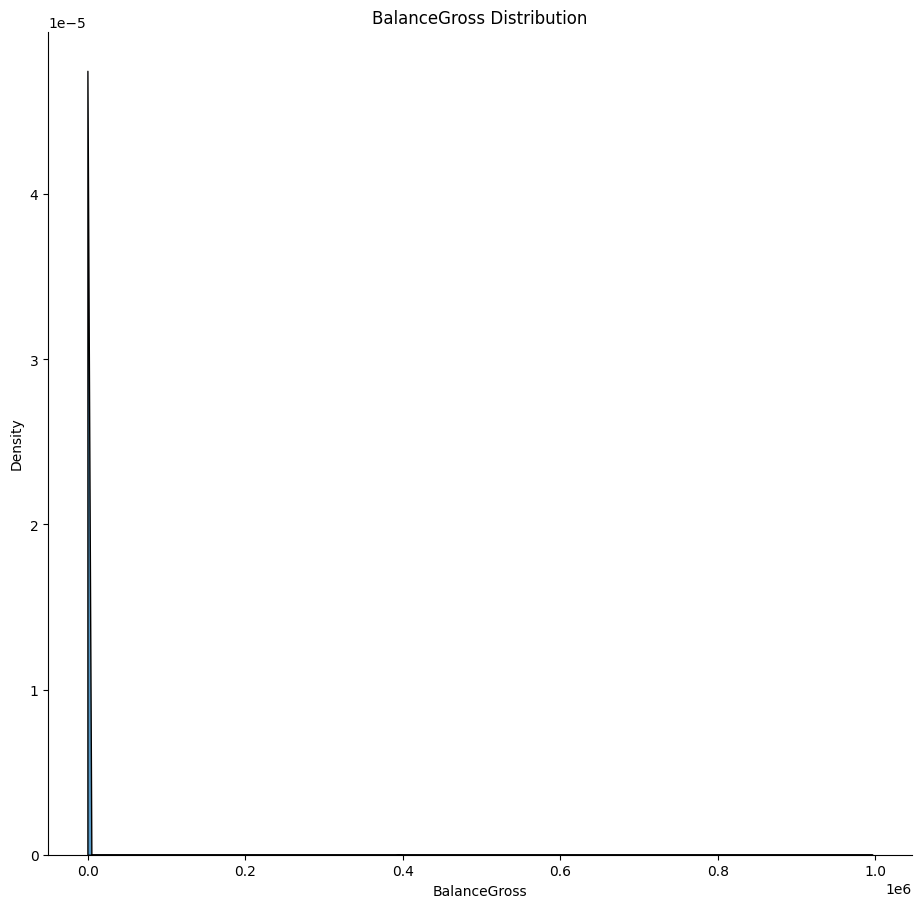

...

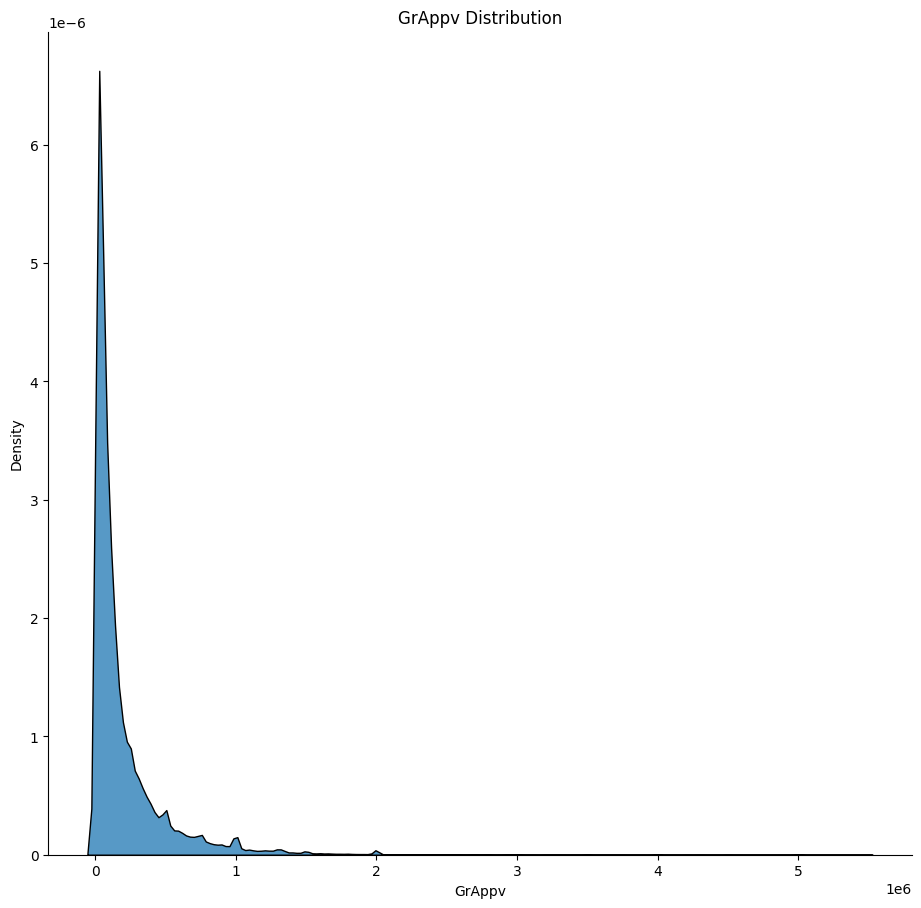

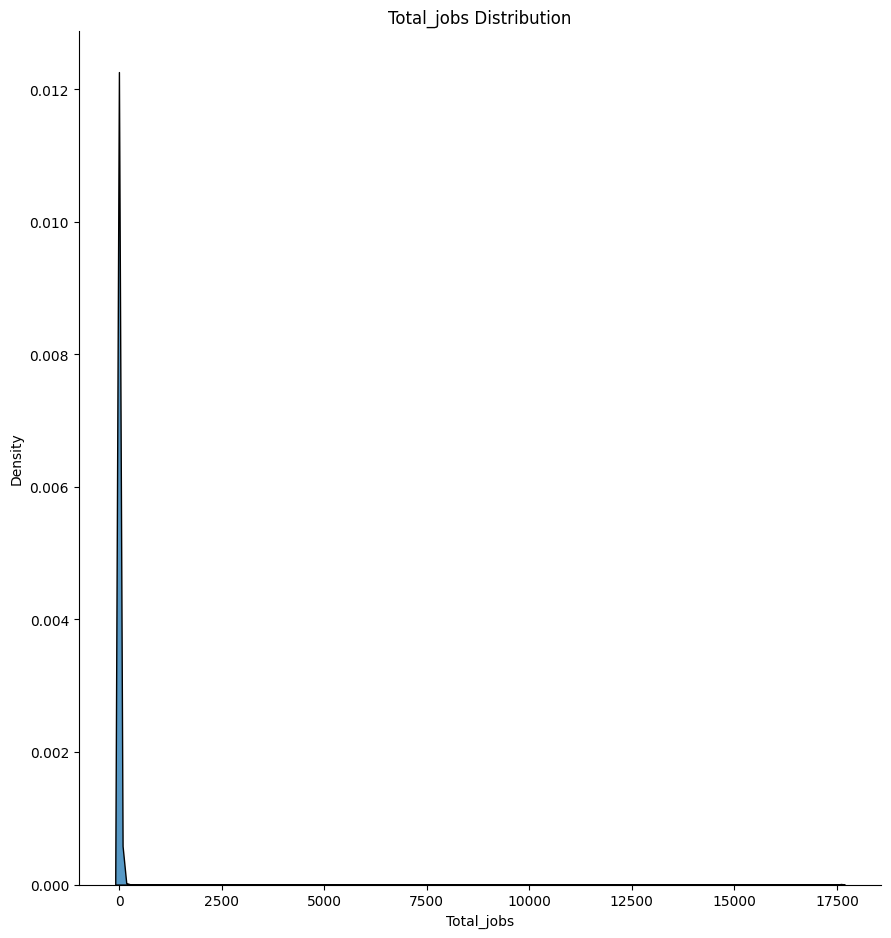

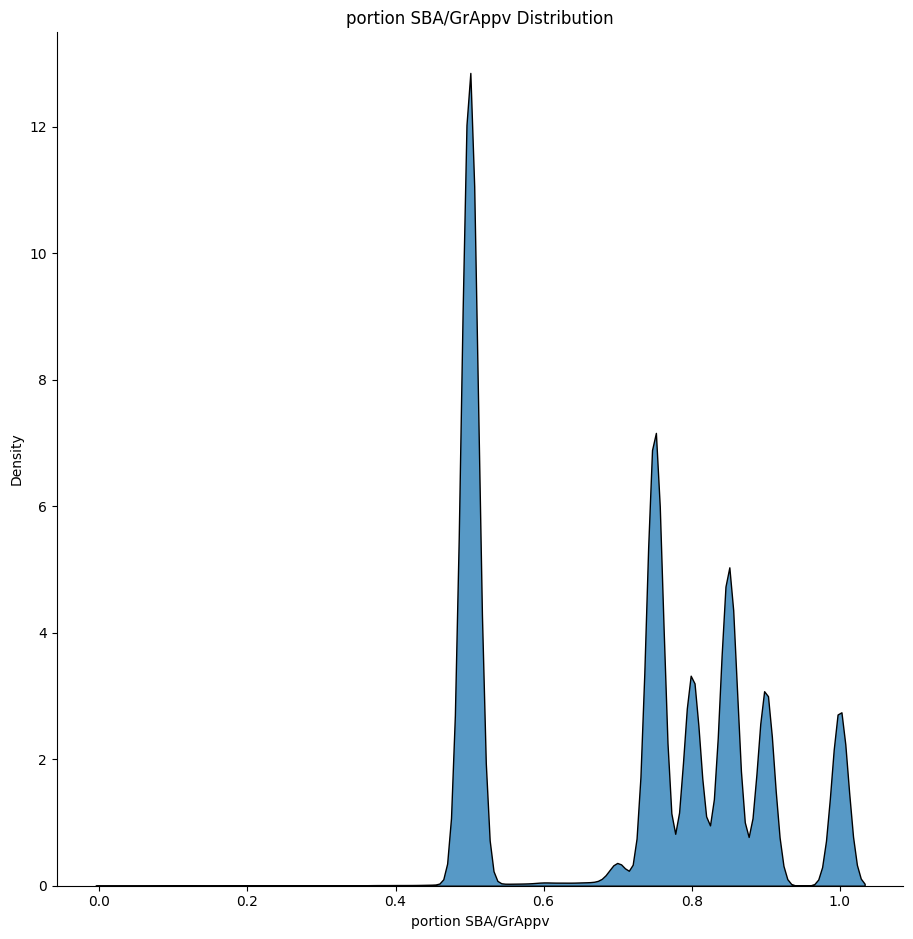

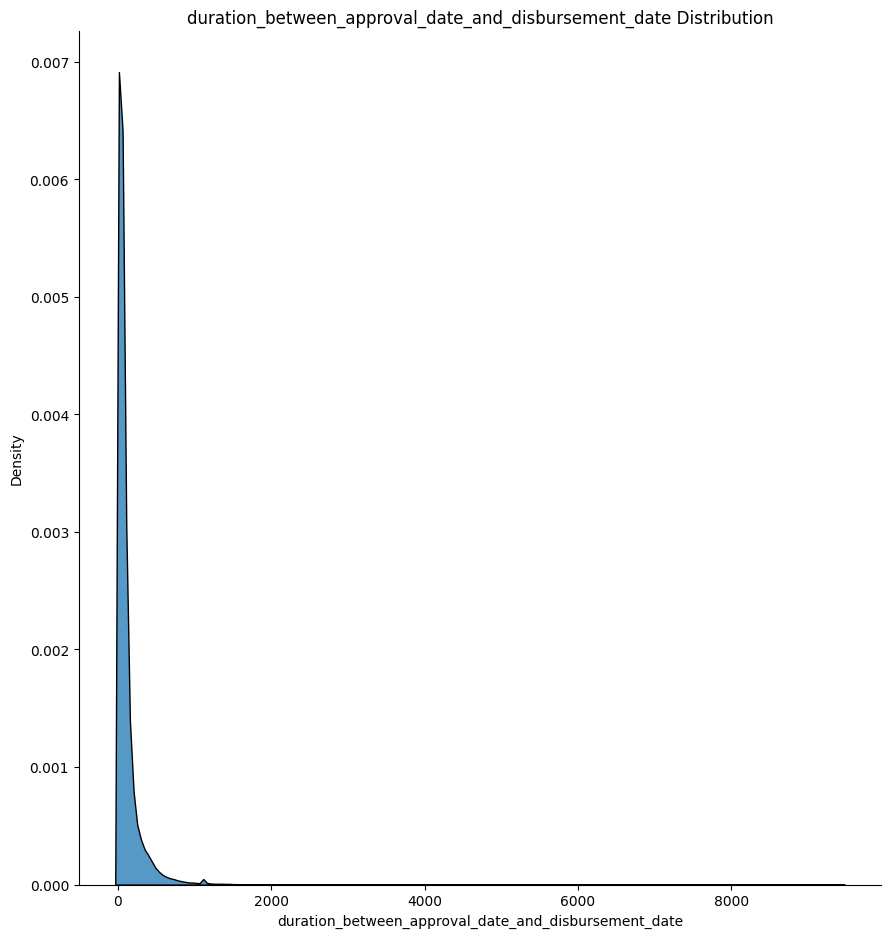

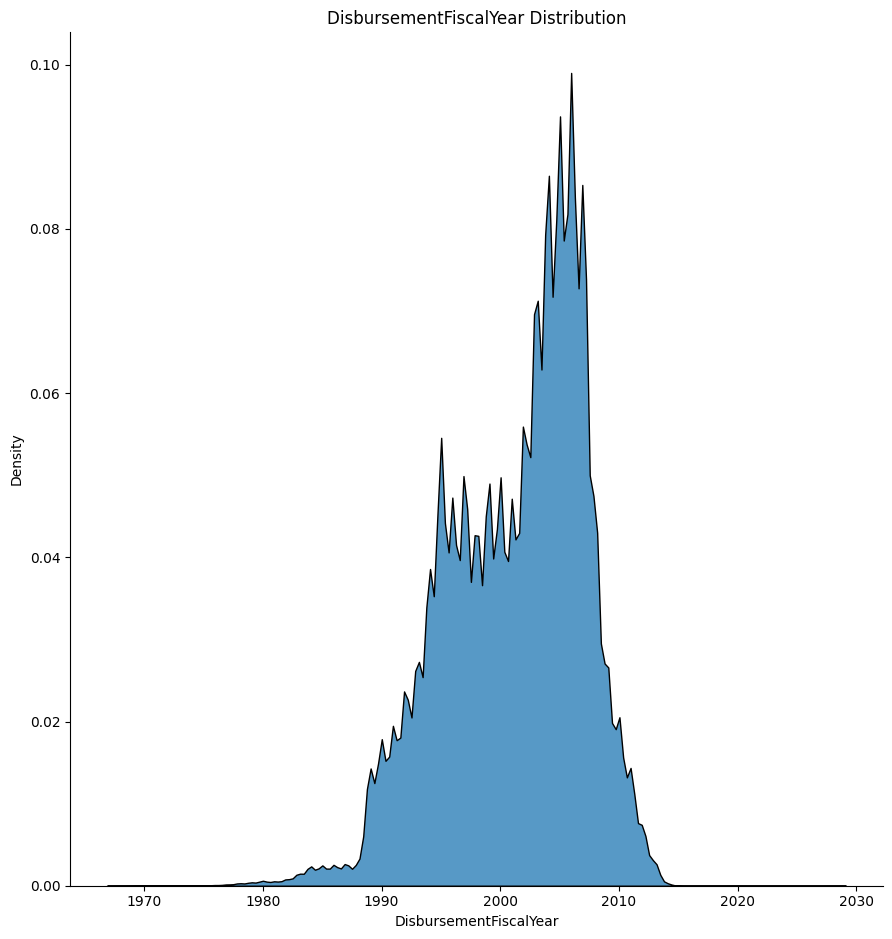

In [ ]:

for feature in numerical_features:

    sns.displot(credit_data_original, x=credit_data_original[feature], kind="kde", multiple="stack")
    plt.gcf().set_size_inches(10, 10)
    plt.title(f'{feature} Distribution')

In [ ]:
credit_data_original.describe()

,Term,NoEmp,CreateJob,RetainedJob,BalanceGross,ChgOffPrinGr,GrAppv,Total_jobs,portion SBA/GrAppv,duration_between_approval_date_and_disbursement_date,DisbursementFiscalYear
count,893601.000000,893601.000000,893601.000000,893601.000000,893601.000000,8.936010e+05,8.936010e+05,893601.000000,893601.000000,893601.000000,893601.000000
mean,110.957971,11.411655,8.405448,10.773276,3.007959,1.350128e+04,1.930316e+05,19.178724,0.709518,113.982551,2001.216194
std,78.844670,74.134094,236.142765,236.579966,1446.643932,6.522347e+04,2.836265e+05,472.001116,0.173727,182.328197,5.815307
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,2.000000e+02,0.000000,0.028140,0.000000,1968.000000
25%,60.000000,2.000000,0.000000,0.000000,0.000000,0.000000e+00,3.500000e+04,0.000000,0.500000,30.000000,1997.000000
50%,84.000000,4.000000,0.000000,1.000000,0.000000,0.000000e+00,9.000000e+04,2.000000,0.750000,59.000000,2003.000000
75%,120.000000,10.000000,1.000000,4.000000,0.000000,0.000000e+00,2.250000e+05,6.000000,0.850000,119.000000,2006.000000
max,569.000000,9999.000000,8800.000000,9500.000000,996262.000000,3.512596e+06,5.472000e+06,17600.000000,1.000000,9443.000000,2028.000000


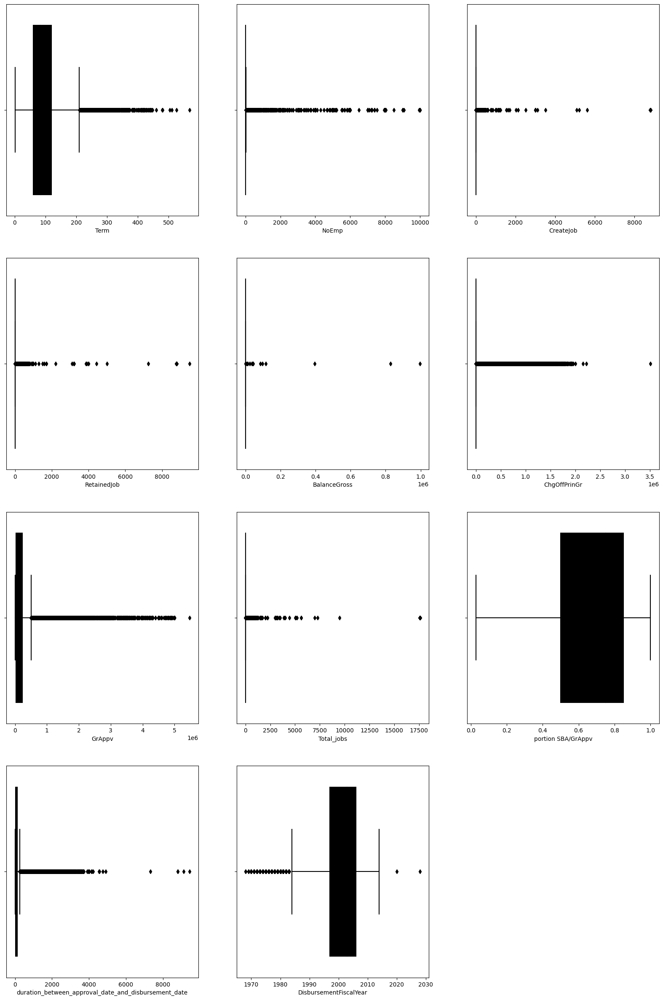

In [ ]:
k=1
plt.figure(figsize=(20,30))
for feature in numerical_features:
    plt.subplot(4,3,k)
    sns.boxplot(data=credit_data_original,x=credit_data_original[feature],color='black')
    k=k+1


In [ ]:
categorical_features

['NewExist',
 'UrbanRural',
 'RevLineCr',
 'LowDoc',
 'MIS_Status',
 'Crisis',
 'Loans_Backed_by_Real_Estate',
 'The_same_state_or_not',
 'Has_Franchise_code?']

In [ ]:
credit_datadoc=credit_data_original.loc[credit_data_original['LowDoc']=='N',:]
credit_datadoc2=credit_data_original.loc[credit_data_original['LowDoc']=='Y',:]
credit3 = pd.concat([credit_datadoc, credit_datadoc2], axis=0)
credit_data_original=credit_data_original[credit_data_original.isin(credit3)].dropna(how = 'all')

In [ ]:
credit_data_original.dtypes

LoanNr_ChkDgt                                            object
Name                                                     object
City                                                     object
State                                                    object
Bank                                                     object
BankState                                                object
Term                                                    float64
NoEmp                                                   float64
NewExist                                                 object
CreateJob                                               float64
RetainedJob                                             float64
UrbanRural                                               object
RevLineCr                                                object
LowDoc                                                   object
BalanceGross                                            float64
MIS_Status                              

In [ ]:
credit_data_original.head()

,LoanNr_ChkDgt,Name,City,State,Bank,BankState,Term,NoEmp,NewExist,CreateJob,RetainedJob,UrbanRural,RevLineCr,LowDoc,BalanceGross,MIS_Status,ChgOffPrinGr,GrAppv,Total_jobs,Industry,portion SBA/GrAppv,duration_between_approval_date_and_disbursement_date,Crisis,Loans_Backed_by_Real_Estate,DisbursementFiscalYear,The_same_state_or_not,Has_Franchise_code?
0,1000014003,ABC HOBBYCRAFT,EVANSVILLE,IN,FIFTH THIRD BANK,OH,84.0,4.0,2.0,0.0,0.0,0,N,Y,0.0,P I F,0.0,60000.0,0.0,Retail trade,0.80,730.0,0,0,1999.0,0,0
1,1000024006,LANDMARK BAR GRILLE,NEW PARIS,IN,1ST SOURCE BANK,IN,60.0,2.0,2.0,0.0,0.0,0,N,Y,0.0,P I F,0.0,40000.0,0.0,Accommodation and food services,0.80,92.0,0,0,1997.0,1,0
2,1000034009,"WHITLOCK DDS, TODD M",BLOOMINGTON,IN,GRANT COUNTY STATE BANK,IN,180.0,7.0,1.0,0.0,0.0,0,N,N,0.0,P I F,0.0,287000.0,0.0,Health care and social assistance,0.75,306.0,0,0,1997.0,1,0
3,1000044001,"BIG BUCKS PAWN JEWELRY, LLC",BROKEN ARROW,OK,1ST NATL BK TR CO OF BROKEN,OK,60.0,2.0,1.0,0.0,0.0,0,N,Y,0.0,P I F,0.0,35000.0,0.0,nan,0.80,122.0,0,0,1997.0,1,0
4,1000054004,"ANASTASIA CONFECTIONS, INC",ORLANDO,FL,FLORIDA BUS DEVEL CORP,FL,240.0,14.0,1.0,7.0,7.0,0,N,N,0.0,P I F,0.0,229000.0,14.0,nan,1.00,75.0,0,1,1997.0,1,0


In [ ]:
credit_data_original['LowDoc'].unique()

array(['Y', 'N'], dtype=object)

In [ ]:
credit_data_original['MIS_Status'].unique()

array(['P I F', 'CHGOFF', 'nan'], dtype=object)

In [ ]:
credit_data_original['Industry'].unique()

array(['Retail trade', 'Accommodation and food services',
       'Health care and social assistance', 'nan', 'Manufacturing',
       'Other services (except public administration)', 'Construction',
       'Wholesale trade', 'Educational services',
       'Real estate and rental and leasing',
       'Professional, scientific, and technical services', 'Information',
       'Arts, entertainment, and recreation', 'Finance and insurance',
       'Mining, quarrying, and oil and gas extraction',
       'Administrative and support and waste management and remediation services',
       'Transportation and warehousing',
       'Agriculture, forestry, fishing and hunting',
       'Public administration', 'Utilities',
       'Management of companies and enterprises'], dtype=object)

In [ ]:
credit_data_original.isnull().sum()

LoanNr_ChkDgt                                           0
Name                                                    0
City                                                    0
State                                                   0
Bank                                                    0
BankState                                               0
Term                                                    0
NoEmp                                                   0
NewExist                                                0
CreateJob                                               0
RetainedJob                                             0
UrbanRural                                              0
RevLineCr                                               0
LowDoc                                                  0
BalanceGross                                            0
MIS_Status                                              0
ChgOffPrinGr                                            0
GrAppv        

In [ ]:
credit_data_original.drop(credit_data_original[credit_data_original.MIS_Status=='nan'].index,inplace=True)

In [ ]:
credit_data_original['MIS_Status'].unique()

array(['P I F', 'CHGOFF'], dtype=object)

In [ ]:
credit_data_original['NewExist'].unique()

array(['2.0', '1.0', '0.0', 'nan'], dtype=object)

In [ ]:
credit_data_original.drop(credit_data_original[credit_data_original.NewExist=='nan'].index,inplace=True)

In [ ]:
credit_data_original.drop(credit_data_original[credit_data_original.NewExist=='0.0'].index,inplace=True)

In [ ]:
credit_data_original.drop(credit_data_original[credit_data_original.UrbanRural=='0'].index,inplace=True)

In [ ]:
credit_data_original.shape

(567073, 27)

In [ ]:
credit_data_original['RevLineCr'].unique()

array(['N', 'Y', '0', 'T', 'nan', '1', 'C', '3', '2', 'R', '7', 'A'],
      dtype=object)

In [ ]:
credit_data_original.drop(credit_data_original[credit_data_original.Industry=='nan'].index,inplace=True)

In [ ]:
credit_data_original.shape

(544278, 27)

In [ ]:
credit_data_original.drop('RevLineCr',axis=1,inplace=True)

In [ ]:
# association_dictionary = associations(credit_data_original[categorical_features], nominal_columns = categorical_features, mark_columns = True,
#                 nom_nom_assoc = 'theil', nan_strategy = 'drop_samples', figsize= (15, 15), vmin = 0, vmax=0.8, compute_only = False,cmap='BrBG',title='Correlation Heatmap for Categorical Features')

In [ ]:
credit_data_original['Total_jobs'].median()

4.0

In [ ]:
credit_data_original['Total_jobs']=np.where(credit_data_original['Total_jobs']==0,credit_data_original['Total_jobs'].median(),credit_data_original['Total_jobs'])

In [ ]:
credit_data_original.describe()

,Term,NoEmp,CreateJob,RetainedJob,BalanceGross,ChgOffPrinGr,GrAppv,Total_jobs,portion SBA/GrAppv,duration_between_approval_date_and_disbursement_date,DisbursementFiscalYear
count,544278.000000,544278.000000,544278.000000,544278.000000,544278.000000,5.442780e+05,5.442780e+05,544278.000000,544278.000000,544278.000000,544278.000000
mean,95.569220,8.721082,2.381640,5.981403,4.935263,1.700162e+04,1.763994e+05,9.087826,0.644880,93.481814,2004.999289
std,69.843485,44.517479,13.232899,22.290832,1853.626708,7.321001e+04,3.033701e+05,26.963603,0.172815,171.157525,2.822945
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,1.000000e+03,1.000000,0.028140,0.000000,1994.000000
25%,60.000000,2.000000,0.000000,1.000000,0.000000,0.000000e+00,2.500000e+04,3.000000,0.500000,24.000000,2003.000000
50%,84.000000,4.000000,0.000000,2.000000,0.000000,0.000000e+00,5.550000e+04,4.000000,0.500000,43.000000,2005.000000
75%,96.000000,8.000000,2.000000,6.000000,0.000000,0.000000e+00,1.750000e+05,8.000000,0.800000,89.000000,2007.000000
max,569.000000,8000.000000,5085.000000,9500.000000,996262.000000,2.157499e+06,5.472000e+06,9500.000000,1.000000,9132.000000,2028.000000


In [ ]:
credit_data_original.drop(columns=['CreateJob','RetainedJob','NoEmp'],inplace=True)

In [ ]:
credit_data=credit_data_original.copy()

In [ ]:
credit_data.dtypes

LoanNr_ChkDgt                                            object
Name                                                     object
City                                                     object
State                                                    object
Bank                                                     object
BankState                                                object
Term                                                    float64
NewExist                                                 object
UrbanRural                                               object
LowDoc                                                   object
BalanceGross                                            float64
MIS_Status                                               object
ChgOffPrinGr                                            float64
GrAppv                                                  float64
Total_jobs                                              float64
Industry                                

In [ ]:
# credit_data['RevLineCr'].unique()

In [ ]:
credit_data.shape

(544278, 23)

In [ ]:
credit_data['UrbanRural'].unique()

array(['1', '2'], dtype=object)

In [ ]:
credit_data['NewExist'].unique()

array(['2.0', '1.0'], dtype=object)

In [ ]:
credit_data['LowDoc'].unique()

array(['N', 'Y'], dtype=object)

In [ ]:
from google.colab import files           # to export from google
credit_data.to_csv('SBA_Data_Draft.csv')
files.download('SBA_Data_Draft.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# credit_data.to_excel('SBA_Data_Draft.xlsx')

In [ ]:
credit_data.drop(columns=['Name','LoanNr_ChkDgt','City','State','Bank','BankState'],inplace=True)

In [ ]:
credit_data.head()

,Term,NewExist,UrbanRural,LowDoc,BalanceGross,MIS_Status,ChgOffPrinGr,GrAppv,Total_jobs,Industry,portion SBA/GrAppv,duration_between_approval_date_and_disbursement_date,Crisis,Loans_Backed_by_Real_Estate,The_same_state_or_not,Has_Franchise_code?
12,162.0,2.0,1,N,0.0,P I F,0.0,253400.0,4.0,Retail trade,0.75,52.0,0,0,0,1
24,126.0,1.0,1,N,0.0,P I F,0.0,137300.0,4.0,Accommodation and food services,0.85,82.0,0,0,0,0
28,83.0,2.0,1,N,0.0,P I F,0.0,100000.0,28.0,Educational services,0.50,21.0,0,0,0,0
30,84.0,1.0,1,N,0.0,P I F,0.0,35000.0,4.0,Construction,0.50,21.0,0,0,1,0
32,60.0,1.0,1,N,0.0,P I F,0.0,50000.0,4.0,Real estate and rental and leasing,0.85,113.0,0,0,1,0


In [ ]:
credit_data['MIS_Status'].value_counts()

P I F     414614
CHGOFF    129664
Name: MIS_Status, dtype: int64

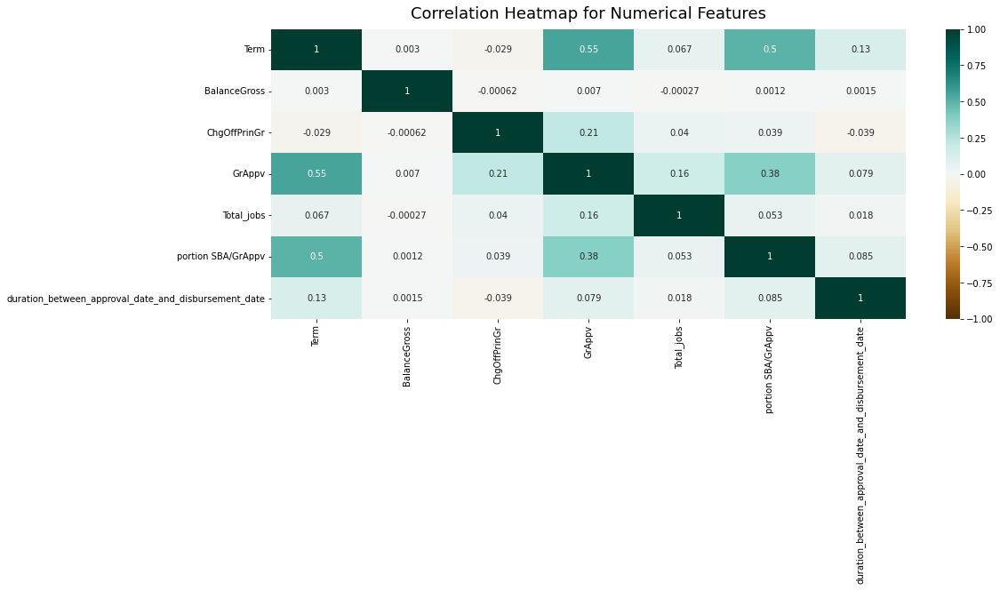

In [ ]:
plt.figure(figsize=(16, 6))
heatmap = sns.heatmap(credit_data.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap for Numerical Features', fontdict={'fontsize':18}, pad=12)
plt.show()

In [ ]:
numerical_features1 = credit_data.select_dtypes(include=np.number).columns.tolist()

categorical_features1 = credit_data.select_dtypes(include='object').columns.tolist()

In [ ]:
numerical_features1

['Term',
 'BalanceGross',
 'ChgOffPrinGr',
 'GrAppv',
 'Total_jobs',
 'portion SBA/GrAppv',
 'duration_between_approval_date_and_disbursement_date']

In [ ]:
categorical_features1

['NewExist',
 'UrbanRural',
 'LowDoc',
 'MIS_Status',
 'Industry',
 'Crisis',
 'Loans_Backed_by_Real_Estate',
 'The_same_state_or_not',
 'Has_Franchise_code?']

In [ ]:
def z_score(dataframe, threshold=3):
    mean, std = np.mean(dataframe), np.std(dataframe)
    z_score = np.abs((dataframe - mean) / std)
    good = z_score < threshold
    print(f"z-score of {threshold} corresponds to a prob of {100 * 2 * norm.sf(3):0.2f}%")
    print(f"Rejection {(~good).sum()} points")
    return good

In [ ]:
for feature in numerical_features1:
    z_score(credit_data[feature])

z-score of 3 corresponds to a prob of 0.27%
Rejection 898 points
z-score of 3 corresponds to a prob of 0.27%
Rejection 12 points
z-score of 3 corresponds to a prob of 0.27%
Rejection 7928 points
z-score of 3 corresponds to a prob of 0.27%
Rejection 14245 points
z-score of 3 corresponds to a prob of 0.27%
Rejection 3959 points
z-score of 3 corresponds to a prob of 0.27%
Rejection 11 points
z-score of 3 corresponds to a prob of 0.27%
Rejection 10817 points


/opt/conda/lib/python3.7/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/opt/conda/lib/python3.7/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/opt/conda/lib/python3.7/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function 

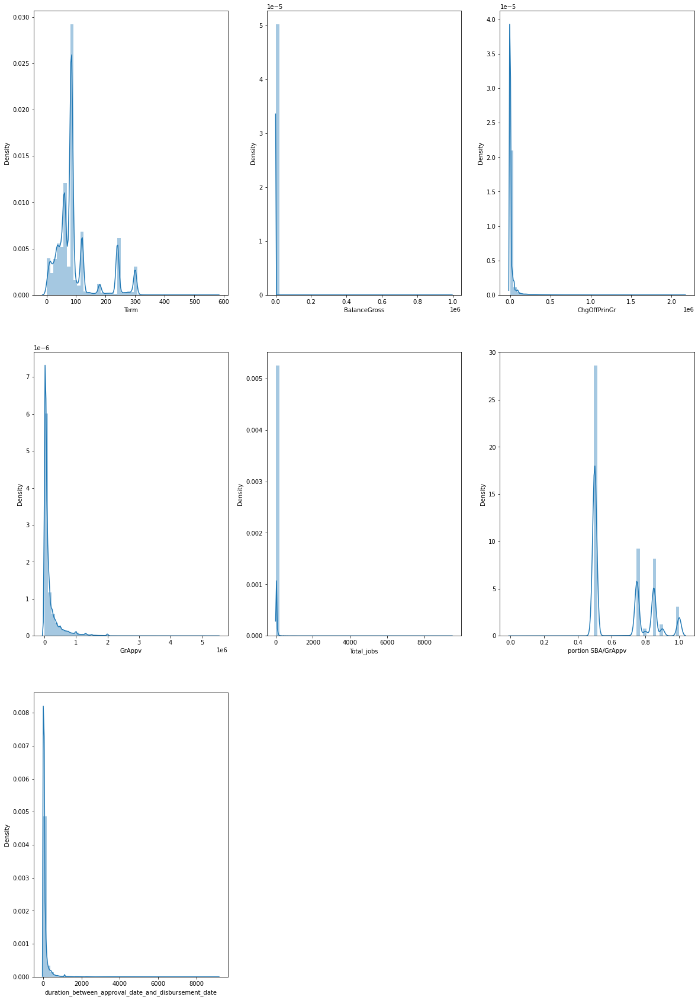

In [ ]:
k=1
plt.figure(figsize=(20,30))


for feature in numerical_features1:
    plt.subplot(3,3,k)
    sns.distplot(credit_data[feature])
    k=k+1

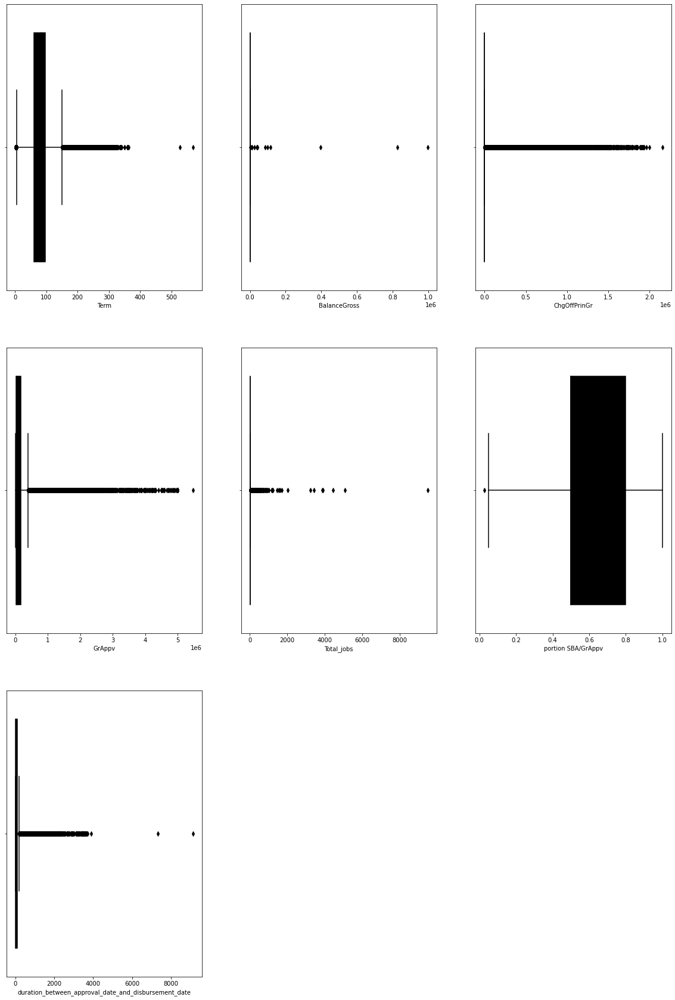

In [ ]:
k=1
plt.figure(figsize=(20,30))
for feature in numerical_features1:
    plt.subplot(3,3,k)
    sns.boxplot(data=credit_data,x=credit_data[feature],color='black')
    k=k+1

In [ ]:
categorical_features1

['NewExist',
 'UrbanRural',
 'LowDoc',
 'MIS_Status',
 'Industry',
 'Crisis',
 'Loans_Backed_by_Real_Estate',
 'The_same_state_or_not',
 'Has_Franchise_code?']

In [ ]:
credit_data['Has_Franchise_code?'].value_counts()

0    514808
1     29470
Name: Has_Franchise_code?, dtype: int64

In [ ]:
categorical_features1

['NewExist',
 'UrbanRural',
 'LowDoc',
 'MIS_Status',
 'Industry',
 'Crisis',
 'Loans_Backed_by_Real_Estate',
 'The_same_state_or_not',
 'Has_Franchise_code?']

In [ ]:
categorical_features1=['NewExist',
 'UrbanRural',
 'LowDoc',
 'MIS_Status',
 'Crisis',
 'Loans_Backed_by_Real_Estate',
 'The_same_state_or_not',
 'Has_Franchise_code?']

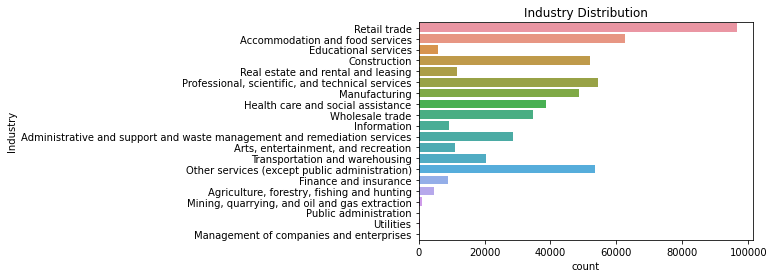

In [ ]:
sns.countplot(data=credit_data, y=credit_data['Industry'])
plt.title('Industry Distribution')
plt.show()

In [ ]:
credit_data['Has_Franchise_code?'].value_counts()

0    514808
1     29470
Name: Has_Franchise_code?, dtype: int64

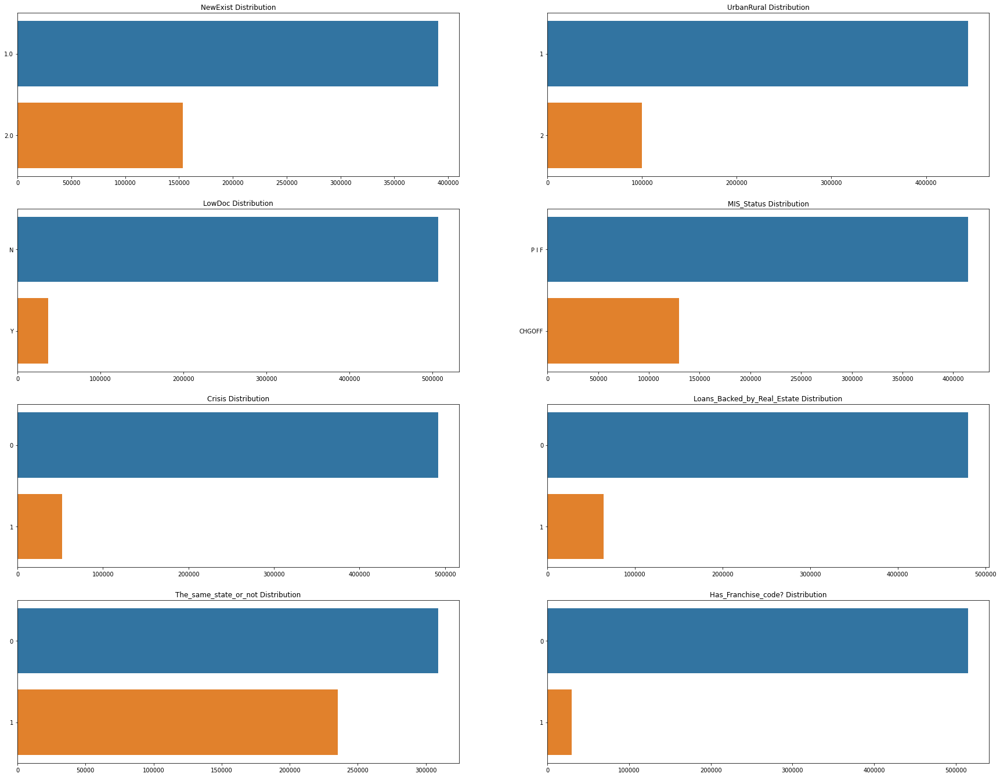

In [ ]:
k=1
plt.figure(figsize=(30,30))

for feature in categorical_features1:
    x = credit_data[feature].value_counts().index
    y = list(map(lambda value:value, credit_data[feature].value_counts()))
    plt.subplot(5,2,k)

    sns.barplot(data=credit_data, x=y, y=x)
    plt.title(f'{feature} Distribution')
    k+=1

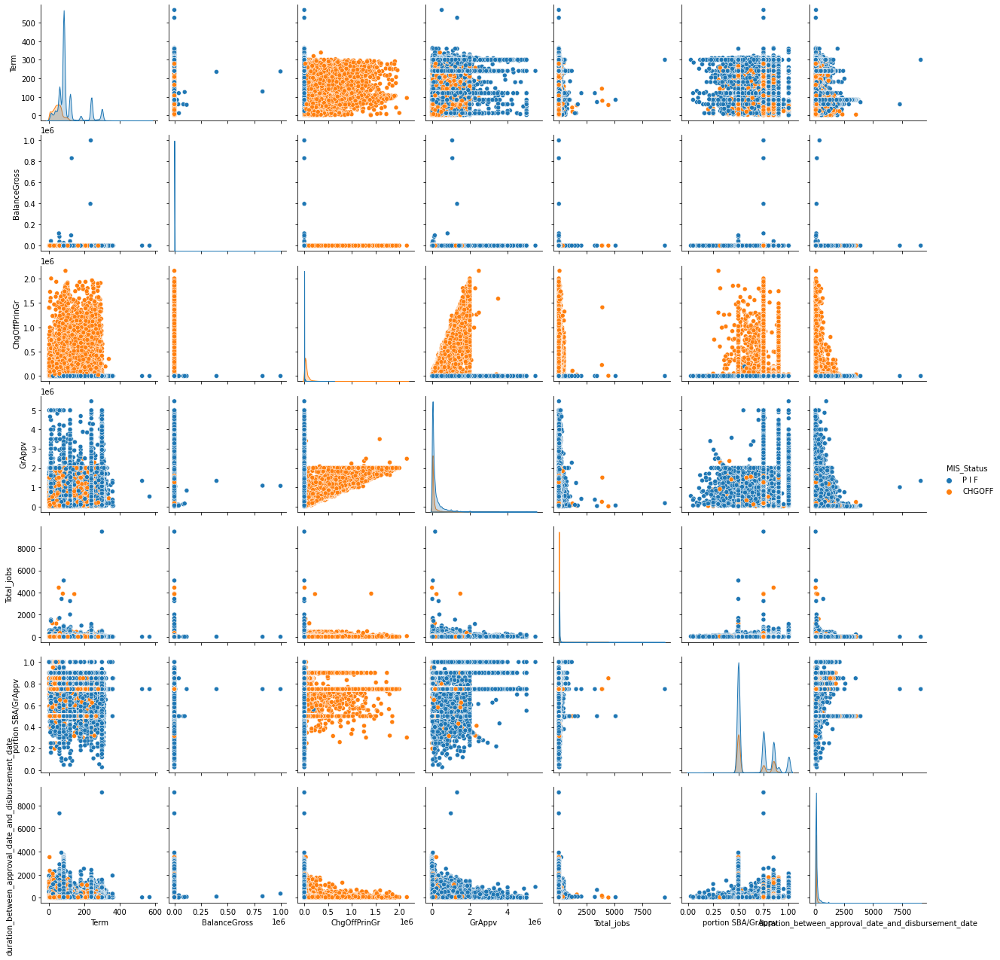

In [ ]:
sns.pairplot(credit_data,hue='MIS_Status')
plt.show()

In [ ]:
credit_data.head()

,Term,NewExist,UrbanRural,LowDoc,BalanceGross,MIS_Status,ChgOffPrinGr,GrAppv,Total_jobs,Industry,portion SBA/GrAppv,duration_between_approval_date_and_disbursement_date,Crisis,Loans_Backed_by_Real_Estate,The_same_state_or_not,Has_Franchise_code?
12,162.0,2.0,1,N,0.0,P I F,0.0,253400.0,4.0,Retail trade,0.75,52.0,0,0,0,1
24,126.0,1.0,1,N,0.0,P I F,0.0,137300.0,4.0,Accommodation and food services,0.85,82.0,0,0,0,0
28,83.0,2.0,1,N,0.0,P I F,0.0,100000.0,28.0,Educational services,0.50,21.0,0,0,0,0
30,84.0,1.0,1,N,0.0,P I F,0.0,35000.0,4.0,Construction,0.50,21.0,0,0,1,0
32,60.0,1.0,1,N,0.0,P I F,0.0,50000.0,4.0,Real estate and rental and leasing,0.85,113.0,0,0,1,0


In [ ]:
credit_data.shape

(544278, 16)

In [ ]:
zero_chgoff=credit_data.loc[credit_data['ChgOffPrinGr']==0,:]

In [ ]:
credit_data.loc[credit_data['ChgOffPrinGr']==0,:].shape

(410741, 16)

In [ ]:
zero_chgoff['MIS_Status'].value_counts()

P I F     410735
CHGOFF         6
Name: MIS_Status, dtype: int64

In [ ]:
credit_data.drop('ChgOffPrinGr',axis=1,inplace=True)

# Models and NN

In [ ]:
y=credit_data['MIS_Status']
x=credit_data.drop('MIS_Status',axis=1)

In [ ]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.20,random_state=42)

In [ ]:
x_train.head()

,Term,NewExist,UrbanRural,LowDoc,BalanceGross,GrAppv,Total_jobs,Industry,portion SBA/GrAppv,duration_between_approval_date_and_disbursement_date,Crisis,Loans_Backed_by_Real_Estate,The_same_state_or_not,Has_Franchise_code?
290667,240.0,2.0,2,N,0.0,108000.0,5.0,Health care and social assistance,1.0,91.0,0,1,1,0
514277,240.0,1.0,1,N,0.0,1300000.0,20.0,Accommodation and food services,1.0,797.0,0,1,1,1
801556,240.0,1.0,1,N,0.0,206000.0,7.0,Wholesale trade,1.0,93.0,0,1,1,0
128088,55.0,1.0,1,N,0.0,50000.0,8.0,Retail trade,0.5,7.0,0,0,0,0
234040,51.0,1.0,1,N,0.0,50000.0,9.0,Retail trade,0.5,8.0,0,0,0,0


In [ ]:
x_train.shape

(435422, 14)

In [ ]:
y_train.head()

290667     P I F
514277     P I F
801556     P I F
128088    CHGOFF
234040    CHGOFF
Name: MIS_Status, dtype: object

In [ ]:
def y_status(U):
  if U=='P I F':
    return 1
  elif U=='CHGOFF':
    return 0
y_train=y_train.apply(y_status)
y_test=y_test.apply(y_status)

In [ ]:
y_train.value_counts()

1    331633
0    103789
Name: MIS_Status, dtype: int64

In [ ]:
x_train['NewExist'].unique()

array(['2.0', '1.0'], dtype=object)

In [ ]:
OHE_encoder1= OneHotEncoder(handle_unknown='ignore', sparse=False)
OHE_cols_train1 = pd.DataFrame(OHE_encoder1.fit_transform(x_train['NewExist'].values.reshape(-1,1)))
OHE_cols_test1 = pd.DataFrame(OHE_encoder1.transform(x_test['NewExist'].values.reshape(-1,1)))
OHE_cols_train1.index = x_train.index
OHE_cols_test1.index = x_test.index
num_X_train1 = x_train.drop('NewExist', axis=1)
num_X_test1 = x_test.drop('NewExist', axis=1)
OHE_X_train1 = pd.concat([num_X_train1, OHE_cols_train1], axis=1)
OHE_X_test1 = pd.concat([num_X_test1, OHE_cols_test1], axis=1)

In [ ]:
column_name1 = OHE_encoder1.get_feature_names_out(['NewExist'])
column_name1

array(['NewExist_1.0', 'NewExist_2.0'], dtype=object)

In [ ]:
OHE_X_train1.head()

,Term,UrbanRural,LowDoc,BalanceGross,GrAppv,Total_jobs,Industry,portion SBA/GrAppv,duration_between_approval_date_and_disbursement_date,Crisis,Loans_Backed_by_Real_Estate,The_same_state_or_not,Has_Franchise_code?,0,1
290667,240.0,2,N,0.0,108000.0,5.0,Health care and social assistance,1.0,91.0,0,1,1,0,0.0,1.0
514277,240.0,1,N,0.0,1300000.0,20.0,Accommodation and food services,1.0,797.0,0,1,1,1,1.0,0.0
801556,240.0,1,N,0.0,206000.0,7.0,Wholesale trade,1.0,93.0,0,1,1,0,1.0,0.0
128088,55.0,1,N,0.0,50000.0,8.0,Retail trade,0.5,7.0,0,0,0,0,1.0,0.0
234040,51.0,1,N,0.0,50000.0,9.0,Retail trade,0.5,8.0,0,0,0,0,1.0,0.0


In [ ]:
OHE_X_train1.rename(columns={0: "NewExist_1.0", 1: "NewExist_2.0"},inplace = True)
OHE_X_test1.rename(columns={0: "NewExist_1.0", 1: "NewExist_2.0"},inplace = True)

In [ ]:
OHE_X_test1.head()

,Term,UrbanRural,LowDoc,BalanceGross,GrAppv,Total_jobs,Industry,portion SBA/GrAppv,duration_between_approval_date_and_disbursement_date,Crisis,Loans_Backed_by_Real_Estate,The_same_state_or_not,Has_Franchise_code?,NewExist_1.0,NewExist_2.0
870003,84.0,1,N,0.0,5000.0,2.0,Information,0.85,24.0,0,0,1,0,0.0,1.0
535814,120.0,1,N,0.0,480000.0,4.0,Other services (except public administration),0.75,63.0,0,0,1,0,0.0,1.0
469876,60.0,2,N,0.0,27000.0,1.0,Health care and social assistance,0.50,21.0,0,0,1,0,0.0,1.0
161236,120.0,1,N,0.0,180000.0,3.0,"Professional, scientific, and technical services",0.75,54.0,0,0,1,0,0.0,1.0
503548,60.0,1,Y,0.0,50000.0,4.0,Manufacturing,0.85,92.0,0,0,0,0,0.0,1.0


In [ ]:
OHE_encoder2= OneHotEncoder(handle_unknown='ignore', sparse=False)
OHE_cols_train2 = pd.DataFrame(OHE_encoder2.fit_transform(OHE_X_train1['UrbanRural'].values.reshape(-1,1)))
OHE_cols_test2 = pd.DataFrame(OHE_encoder2.transform(OHE_X_test1['UrbanRural'].values.reshape(-1,1)))
OHE_cols_train2.index = OHE_X_train1.index
OHE_cols_test2.index = OHE_X_test1.index
num_X_train2 = OHE_X_train1.drop('UrbanRural', axis=1)
num_X_test2 = OHE_X_test1.drop('UrbanRural', axis=1)
OHE_X_train2 = pd.concat([num_X_train2, OHE_cols_train2], axis=1)
OHE_X_test2 = pd.concat([num_X_test2, OHE_cols_test2], axis=1)

In [ ]:
OHE_X_train2.head()

,Term,LowDoc,BalanceGross,GrAppv,Total_jobs,Industry,portion SBA/GrAppv,duration_between_approval_date_and_disbursement_date,Crisis,Loans_Backed_by_Real_Estate,The_same_state_or_not,Has_Franchise_code?,NewExist_1.0,NewExist_2.0,0,1
290667,240.0,N,0.0,108000.0,5.0,Health care and social assistance,1.0,91.0,0,1,1,0,0.0,1.0,0.0,1.0
514277,240.0,N,0.0,1300000.0,20.0,Accommodation and food services,1.0,797.0,0,1,1,1,1.0,0.0,1.0,0.0
801556,240.0,N,0.0,206000.0,7.0,Wholesale trade,1.0,93.0,0,1,1,0,1.0,0.0,1.0,0.0
128088,55.0,N,0.0,50000.0,8.0,Retail trade,0.5,7.0,0,0,0,0,1.0,0.0,1.0,0.0
234040,51.0,N,0.0,50000.0,9.0,Retail trade,0.5,8.0,0,0,0,0,1.0,0.0,1.0,0.0


In [ ]:
column_name2 = OHE_encoder2.get_feature_names_out(['UrbanRural'])
column_name2

array(['UrbanRural_1', 'UrbanRural_2'], dtype=object)

In [ ]:
OHE_X_train2.rename(columns={0: "UrbanRural_1", 1: "UrbanRural_2"},inplace = True)
OHE_X_test2.rename(columns={0: "UrbanRural_1", 1: "UrbanRural_2"},inplace = True)

In [ ]:
OHE_encoder3= OneHotEncoder(handle_unknown='ignore', sparse=False)
OHE_cols_train3 = pd.DataFrame(OHE_encoder3.fit_transform(OHE_X_train2['LowDoc'].values.reshape(-1,1)))
OHE_cols_test3 = pd.DataFrame(OHE_encoder3.transform(OHE_X_test2['LowDoc'].values.reshape(-1,1)))
OHE_cols_train3.index = OHE_X_train2.index
OHE_cols_test3.index = OHE_X_test2.index
num_X_train3 = OHE_X_train2.drop('LowDoc', axis=1)
num_X_test3 = OHE_X_test2.drop('LowDoc', axis=1)
OHE_X_train3 = pd.concat([num_X_train3, OHE_cols_train3], axis=1)
OHE_X_test3 = pd.concat([num_X_test3, OHE_cols_test3], axis=1)

In [ ]:
OHE_X_train3.head()

,Term,BalanceGross,GrAppv,Total_jobs,Industry,portion SBA/GrAppv,duration_between_approval_date_and_disbursement_date,Crisis,Loans_Backed_by_Real_Estate,The_same_state_or_not,Has_Franchise_code?,NewExist_1.0,NewExist_2.0,UrbanRural_1,UrbanRural_2,0,1
290667,240.0,0.0,108000.0,5.0,Health care and social assistance,1.0,91.0,0,1,1,0,0.0,1.0,0.0,1.0,1.0,0.0
514277,240.0,0.0,1300000.0,20.0,Accommodation and food services,1.0,797.0,0,1,1,1,1.0,0.0,1.0,0.0,1.0,0.0
801556,240.0,0.0,206000.0,7.0,Wholesale trade,1.0,93.0,0,1,1,0,1.0,0.0,1.0,0.0,1.0,0.0
128088,55.0,0.0,50000.0,8.0,Retail trade,0.5,7.0,0,0,0,0,1.0,0.0,1.0,0.0,1.0,0.0
234040,51.0,0.0,50000.0,9.0,Retail trade,0.5,8.0,0,0,0,0,1.0,0.0,1.0,0.0,1.0,0.0


In [ ]:
column_name3 = OHE_encoder3.get_feature_names_out(['LowDoc'])
column_name3

array(['LowDoc_N', 'LowDoc_Y'], dtype=object)

In [ ]:
OHE_X_train3.rename(columns={0: "LowDoc_N", 1: "LowDoc_Y"},inplace = True)
OHE_X_test3.rename(columns={0: "LowDoc_N", 1: "LowDoc_Y"},inplace = True)

In [ ]:
OHE_encoder4= OneHotEncoder(handle_unknown='ignore', sparse=False)
OHE_cols_train4 = pd.DataFrame(OHE_encoder4.fit_transform(OHE_X_train3['The_same_state_or_not'].values.reshape(-1,1)))
OHE_cols_test4 = pd.DataFrame(OHE_encoder4.transform(OHE_X_test3['The_same_state_or_not'].values.reshape(-1,1)))
OHE_cols_train4.index = OHE_X_train3.index
OHE_cols_test4.index = OHE_X_test3.index
num_X_train4 = OHE_X_train3.drop('The_same_state_or_not', axis=1)
num_X_test4 = OHE_X_test3.drop('The_same_state_or_not', axis=1)
OHE_X_train4 = pd.concat([num_X_train4, OHE_cols_train4], axis=1)
OHE_X_test4 = pd.concat([num_X_test4, OHE_cols_test4], axis=1)

In [ ]:
OHE_X_train4.head()

,Term,BalanceGross,GrAppv,Total_jobs,Industry,portion SBA/GrAppv,duration_between_approval_date_and_disbursement_date,Crisis,Loans_Backed_by_Real_Estate,Has_Franchise_code?,NewExist_1.0,NewExist_2.0,UrbanRural_1,UrbanRural_2,LowDoc_N,LowDoc_Y,0,1
290667,240.0,0.0,108000.0,5.0,Health care and social assistance,1.0,91.0,0,1,0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0
514277,240.0,0.0,1300000.0,20.0,Accommodation and food services,1.0,797.0,0,1,1,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
801556,240.0,0.0,206000.0,7.0,Wholesale trade,1.0,93.0,0,1,0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
128088,55.0,0.0,50000.0,8.0,Retail trade,0.5,7.0,0,0,0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0
234040,51.0,0.0,50000.0,9.0,Retail trade,0.5,8.0,0,0,0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0


In [ ]:
column_name4 = OHE_encoder4.get_feature_names_out(['The_same_state_or_not'])
column_name4

array(['The_same_state_or_not_0', 'The_same_state_or_not_1'], dtype=object)

In [ ]:
OHE_X_train4.rename(columns={0: "The_same_state_or_not_0", 1: "The_same_state_or_not_1"},inplace = True)
OHE_X_test4.rename(columns={0: "The_same_state_or_not_0", 1: "The_same_state_or_not_1"},inplace = True)

In [ ]:
OHE_encoder5= OneHotEncoder(handle_unknown='ignore', sparse=False)
OHE_cols_train5 = pd.DataFrame(OHE_encoder5.fit_transform(OHE_X_train4['Has_Franchise_code?'].values.reshape(-1,1)))
OHE_cols_test5 = pd.DataFrame(OHE_encoder5.transform(OHE_X_test4['Has_Franchise_code?'].values.reshape(-1,1)))
OHE_cols_train5.index = OHE_X_train4.index
OHE_cols_test5.index = OHE_X_test4.index
num_X_train5 = OHE_X_train4.drop('Has_Franchise_code?', axis=1)
num_X_test5 = OHE_X_test4.drop('Has_Franchise_code?', axis=1)
OHE_X_train5 = pd.concat([num_X_train5, OHE_cols_train5], axis=1)
OHE_X_test5 = pd.concat([num_X_test5, OHE_cols_test5], axis=1)

In [ ]:
OHE_X_train5.head()

,Term,BalanceGross,GrAppv,Total_jobs,Industry,portion SBA/GrAppv,duration_between_approval_date_and_disbursement_date,Crisis,Loans_Backed_by_Real_Estate,NewExist_1.0,NewExist_2.0,UrbanRural_1,UrbanRural_2,LowDoc_N,LowDoc_Y,The_same_state_or_not_0,The_same_state_or_not_1,0,1
290667,240.0,0.0,108000.0,5.0,Health care and social assistance,1.0,91.0,0,1,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0
514277,240.0,0.0,1300000.0,20.0,Accommodation and food services,1.0,797.0,0,1,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0
801556,240.0,0.0,206000.0,7.0,Wholesale trade,1.0,93.0,0,1,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0
128088,55.0,0.0,50000.0,8.0,Retail trade,0.5,7.0,0,0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0
234040,51.0,0.0,50000.0,9.0,Retail trade,0.5,8.0,0,0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0


In [ ]:
column_name5 = OHE_encoder5.get_feature_names_out(['Has_Franchise_code'])
column_name5

array(['Has_Franchise_code_0', 'Has_Franchise_code_1'], dtype=object)

In [ ]:
OHE_X_train5.rename(columns={0: "Has_Franchise_code_0", 1: "Has_Franchise_code_1"},inplace = True)
OHE_X_test5.rename(columns={0: "Has_Franchise_code_0", 1: "Has_Franchise_code_1"},inplace = True)

In [ ]:
OHE_encoder6= OneHotEncoder(handle_unknown='ignore', sparse=False)
OHE_cols_train6 = pd.DataFrame(OHE_encoder6.fit_transform(OHE_X_train5['Loans_Backed_by_Real_Estate'].values.reshape(-1,1)))
OHE_cols_test6 = pd.DataFrame(OHE_encoder6.transform(OHE_X_test5['Loans_Backed_by_Real_Estate'].values.reshape(-1,1)))
OHE_cols_train6.index = OHE_X_train5.index
OHE_cols_test6.index = OHE_X_test5.index
num_X_train6 = OHE_X_train5.drop('Loans_Backed_by_Real_Estate', axis=1)
num_X_test6 = OHE_X_test5.drop('Loans_Backed_by_Real_Estate', axis=1)
OHE_X_train6 = pd.concat([num_X_train6, OHE_cols_train6], axis=1)
OHE_X_test6 = pd.concat([num_X_test6, OHE_cols_test6], axis=1)

In [ ]:
OHE_X_train6.head()

,Term,BalanceGross,GrAppv,Total_jobs,Industry,portion SBA/GrAppv,duration_between_approval_date_and_disbursement_date,Crisis,NewExist_1.0,NewExist_2.0,UrbanRural_1,UrbanRural_2,LowDoc_N,LowDoc_Y,The_same_state_or_not_0,The_same_state_or_not_1,Has_Franchise_code_0,Has_Franchise_code_1,0,1
290667,240.0,0.0,108000.0,5.0,Health care and social assistance,1.0,91.0,0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0
514277,240.0,0.0,1300000.0,20.0,Accommodation and food services,1.0,797.0,0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0
801556,240.0,0.0,206000.0,7.0,Wholesale trade,1.0,93.0,0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0
128088,55.0,0.0,50000.0,8.0,Retail trade,0.5,7.0,0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0
234040,51.0,0.0,50000.0,9.0,Retail trade,0.5,8.0,0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0


In [ ]:
column_name6 = OHE_encoder6.get_feature_names_out(['Loans_Backed_by_Real_Estate'])
column_name6

array(['Loans_Backed_by_Real_Estate_0', 'Loans_Backed_by_Real_Estate_1'],
      dtype=object)

In [ ]:
OHE_X_train6.rename(columns={0: "Loans_Backed_by_Real_Estate_0", 1: "Loans_Backed_by_Real_Estate_1"},inplace = True)
OHE_X_test6.rename(columns={0: "Loans_Backed_by_Real_Estate_0", 1: "Loans_Backed_by_Real_Estate_1"},inplace = True)

In [ ]:
OHE_encoder7= OneHotEncoder(handle_unknown='ignore', sparse=False)
OHE_cols_train7 = pd.DataFrame(OHE_encoder7.fit_transform(OHE_X_train6['Crisis'].values.reshape(-1,1)))
OHE_cols_test7 = pd.DataFrame(OHE_encoder6.transform(OHE_X_test6['Crisis'].values.reshape(-1,1)))
OHE_cols_train7.index = OHE_X_train6.index
OHE_cols_test7.index = OHE_X_test6.index
num_X_train7 = OHE_X_train6.drop('Crisis', axis=1)
num_X_test7 = OHE_X_test6.drop('Crisis', axis=1)
OHE_X_train7 = pd.concat([num_X_train7, OHE_cols_train7], axis=1)
OHE_X_test7 = pd.concat([num_X_test7, OHE_cols_test7], axis=1)

In [ ]:
OHE_X_train7.head()

,Term,BalanceGross,GrAppv,Total_jobs,Industry,portion SBA/GrAppv,duration_between_approval_date_and_disbursement_date,NewExist_1.0,NewExist_2.0,UrbanRural_1,UrbanRural_2,LowDoc_N,LowDoc_Y,The_same_state_or_not_0,The_same_state_or_not_1,Has_Franchise_code_0,Has_Franchise_code_1,Loans_Backed_by_Real_Estate_0,Loans_Backed_by_Real_Estate_1,0,1
290667,240.0,0.0,108000.0,5.0,Health care and social assistance,1.0,91.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0
514277,240.0,0.0,1300000.0,20.0,Accommodation and food services,1.0,797.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0
801556,240.0,0.0,206000.0,7.0,Wholesale trade,1.0,93.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0
128088,55.0,0.0,50000.0,8.0,Retail trade,0.5,7.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0
234040,51.0,0.0,50000.0,9.0,Retail trade,0.5,8.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0


In [ ]:
column_name7 = OHE_encoder7.get_feature_names_out(['Crisis'])
column_name7

array(['Crisis_0', 'Crisis_1'], dtype=object)

In [ ]:
OHE_X_train7.rename(columns={0: "Crisis_0", 1: "Crisis_1"},inplace = True)
OHE_X_test7.rename(columns={0: "Crisis_0", 1: "Crisis_1"},inplace = True)

In [ ]:
OHE_X_train7.head()

,Term,BalanceGross,GrAppv,Total_jobs,Industry,portion SBA/GrAppv,duration_between_approval_date_and_disbursement_date,NewExist_1.0,NewExist_2.0,UrbanRural_1,UrbanRural_2,LowDoc_N,LowDoc_Y,The_same_state_or_not_0,The_same_state_or_not_1,Has_Franchise_code_0,Has_Franchise_code_1,Loans_Backed_by_Real_Estate_0,Loans_Backed_by_Real_Estate_1,Crisis_0,Crisis_1
290667,240.0,0.0,108000.0,5.0,Health care and social assistance,1.0,91.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0
514277,240.0,0.0,1300000.0,20.0,Accommodation and food services,1.0,797.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0
801556,240.0,0.0,206000.0,7.0,Wholesale trade,1.0,93.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0
128088,55.0,0.0,50000.0,8.0,Retail trade,0.5,7.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0
234040,51.0,0.0,50000.0,9.0,Retail trade,0.5,8.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0


In [ ]:
OHE_encoder8= OneHotEncoder(handle_unknown='ignore', sparse=False,)
OHE_cols_train8 = pd.DataFrame(OHE_encoder8.fit_transform(OHE_X_train7['Industry'].values.reshape(-1,1)))
OHE_cols_test8 = pd.DataFrame(OHE_encoder8.transform(OHE_X_test7['Industry'].values.reshape(-1,1)))
OHE_cols_train8.index = OHE_X_train7.index
OHE_cols_test8.index = OHE_X_test7.index
num_X_train8 = OHE_X_train7.drop('Industry', axis=1)
num_X_test8 = OHE_X_test7.drop('Industry', axis=1)
OHE_X_train8 = pd.concat([num_X_train8, OHE_cols_train8], axis=1)
OHE_X_test8 = pd.concat([num_X_test8, OHE_cols_test8], axis=1)

In [ ]:
column_name8 = OHE_encoder8.get_feature_names_out(['Industry'])
column_name8

array(['Industry_Accommodation and food services',
       'Industry_Administrative and support and waste management and remediation services',
       'Industry_Agriculture, forestry, fishing and hunting',
       'Industry_Arts, entertainment, and recreation',
       'Industry_Construction', 'Industry_Educational services',
       'Industry_Finance and insurance',
       'Industry_Health care and social assistance',
       'Industry_Information',
       'Industry_Management of companies and enterprises',
       'Industry_Manufacturing',
       'Industry_Mining, quarrying, and oil and gas extraction',
       'Industry_Other services (except public administration)',
       'Industry_Professional, scientific, and technical services',
       'Industry_Public administration',
       'Industry_Real estate and rental and leasing',
       'Industry_Retail trade', 'Industry_Transportation and warehousing',
       'Industry_Utilities', 'Industry_Wholesale trade'], dtype=object)

In [ ]:
OHE_X_train8.rename(columns={0: "Industry_Accommodation and food services", 1: "Industry_Administrative and support and waste management and remediation services",2:"Industry_Agriculture, forestry, fishing and hunting",3:"Industry_Arts, entertainment, and recreation",4:"Industry_Construction",5:"Industry_Educational services",6:"Industry_Finance and insurance",7:"Industry_Health care and social assistance",
8:"Industry_Information",9:"Industry_Management of companies and enterprises",10:"Industry_Manufacturing",11:'Industry_Mining, quarrying, and oil and gas extraction',12:"Industry_Other services (except public administration)",13:"Industry_Professional, scientific, and technical services",14:"Industry_Public administration",15:'Industry_Real estate and rental and leasing',16:"Industry_Retail trade",17:"Industry_Transportation and warehousing",18:"Industry_Utilities",19:'Industry_Wholesale trade'},inplace = True)
OHE_X_test8.rename(columns={0: "Industry_Accommodation and food services", 1: "Industry_Administrative and support and waste management and remediation services",2:"Industry_Agriculture, forestry, fishing and hunting",3:"Industry_Arts, entertainment, and recreation",4:"Industry_Construction",5:"Industry_Educational services",6:"Industry_Finance and insurance",7:"Industry_Health care and social assistance",
8:"Industry_Information",9:"Industry_Management of companies and enterprises",10:"Industry_Manufacturing",11:'Industry_Mining, quarrying, and oil and gas extraction',12:"Industry_Other services (except public administration)",13:"Industry_Professional, scientific, and technical services",14:"Industry_Public administration",15:'Industry_Real estate and rental and leasing',16:"Industry_Retail trade",17:"Industry_Transportation and warehousing",18:"Industry_Utilities",19:'Industry_Wholesale trade'},inplace = True)

In [ ]:
OHE_X_train8.dtypes

Term                                                                                 float64
BalanceGross                                                                         float64
GrAppv                                                                               float64
Total_jobs                                                                           float64
portion SBA/GrAppv                                                                   float64
duration_between_approval_date_and_disbursement_date                                 float64
NewExist_1.0                                                                         float64
NewExist_2.0                                                                         float64
UrbanRural_1                                                                         float64
UrbanRural_2                                                                         float64
LowDoc_N                                                              

In [ ]:
OHE_X_test8.head()

,Term,BalanceGross,GrAppv,Total_jobs,portion SBA/GrAppv,duration_between_approval_date_and_disbursement_date,NewExist_1.0,NewExist_2.0,UrbanRural_1,UrbanRural_2,LowDoc_N,LowDoc_Y,The_same_state_or_not_0,The_same_state_or_not_1,Has_Franchise_code_0,Has_Franchise_code_1,Loans_Backed_by_Real_Estate_0,Loans_Backed_by_Real_Estate_1,Crisis_0,Crisis_1,Industry_Accommodation and food services,Industry_Administrative and support and waste management and remediation services,"Industry_Agriculture, forestry, fishing and hunting","Industry_Arts, entertainment, and recreation",Industry_Construction,Industry_Educational services,Industry_Finance and insurance,Industry_Health care and social assistance,Industry_Information,Industry_Management of companies and enterprises,Industry_Manufacturing,"Industry_Mining, quarrying, and oil and gas extraction",Industry_Other services (except public administration),"Industry_Professional, scientific, and technical services",Industry_Public administration,Industry_Real estate and rental and leasing,Industry_Retail trade,Industry_Transportation and warehousing,Industry_Utilities,Industry_Wholesale trade
870003,84.0,0.0,5000.0,2.0,0.85,24.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
535814,120.0,0.0,480000.0,4.0,0.75,63.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
469876,60.0,0.0,27000.0,1.0,0.50,21.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
161236,120.0,0.0,180000.0,3.0,0.75,54.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
503548,60.0,0.0,50000.0,4.0,0.85,92.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
visualize_1 = TSNE(n_components=2, learning_rate='auto').fit_transform(OHE_X_train8)

In [ ]:
datafr = pd.DataFrame()
datafr["y"] = y_train

datafr["feature-1"] = visualize_1[:,0]
datafr["feature-2"] = visualize_1[:,1]


sns.scatterplot(x="feature-1", y="feature-2", hue=datafr.y.tolist(),
                palette=sns.color_palette("hls", 2),
                data=datafr).set(title="Loan Default Detection data T-SNE projection")
plt.show()

NameError: name 'visualize_1' is not defined

In [ ]:
y_train.value_counts()

1    331633
0    103789
Name: MIS_Status, dtype: int64

In [ ]:
sm1 = SMOTE(random_state=42,sampling_strategy='minority')
X_res1, y_res1 = sm1.fit_resample(OHE_X_train8,y_train)

In [ ]:
X_res1.head()

,Term,BalanceGross,GrAppv,Total_jobs,portion SBA/GrAppv,duration_between_approval_date_and_disbursement_date,NewExist_1.0,NewExist_2.0,UrbanRural_1,UrbanRural_2,LowDoc_N,LowDoc_Y,The_same_state_or_not_0,The_same_state_or_not_1,Has_Franchise_code_0,Has_Franchise_code_1,Loans_Backed_by_Real_Estate_0,Loans_Backed_by_Real_Estate_1,Crisis_0,Crisis_1,Industry_Accommodation and food services,Industry_Administrative and support and waste management and remediation services,"Industry_Agriculture, forestry, fishing and hunting","Industry_Arts, entertainment, and recreation",Industry_Construction,Industry_Educational services,Industry_Finance and insurance,Industry_Health care and social assistance,Industry_Information,Industry_Management of companies and enterprises,Industry_Manufacturing,"Industry_Mining, quarrying, and oil and gas extraction",Industry_Other services (except public administration),"Industry_Professional, scientific, and technical services",Industry_Public administration,Industry_Real estate and rental and leasing,Industry_Retail trade,Industry_Transportation and warehousing,Industry_Utilities,Industry_Wholesale trade
0,240.0,0.0,108000.0,5.0,1.0,91.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,240.0,0.0,1300000.0,20.0,1.0,797.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,240.0,0.0,206000.0,7.0,1.0,93.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,55.0,0.0,50000.0,8.0,0.5,7.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
4,51.0,0.0,50000.0,9.0,0.5,8.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [ ]:
y_res1.value_counts()

1    331633
0    331633
Name: MIS_Status, dtype: int64

In [ ]:
categorical_features1

['NewExist',
 'UrbanRural',
 'LowDoc',
 'MIS_Status',
 'Industry',
 'Crisis',
 'Loans_Backed_by_Real_Estate',
 'The_same_state_or_not',
 'Has_Franchise_code?']

In [ ]:
numerical_features1=['Term',
 'BalanceGross',
 'GrAppv',
 'Total_jobs',
 'portion SBA/GrAppv',
 'duration_between_approval_date_and_disbursement_date']

In [ ]:
robust_scalar1 = RobustScaler()
x__scaled__train=robust_scalar1.fit_transform(X_res1)
x__scaled_test=robust_scalar1.transform(OHE_X_test8)

In [ ]:
type(x__scaled__train)

numpy.ndarray

In [ ]:
x__scaled__train=pd.DataFrame(x__scaled__train)
x__scaled_test=pd.DataFrame(x__scaled_test)

In [ ]:
x__scaled__train.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39
0,4.142857,0.0,0.465490,0.2,2.0,0.992969,-1.264542,1.264542,-1.0,1.0,0.0,0.0,-1.0,1.0,0.0,0.0,-1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,4.142857,0.0,10.032103,3.2,2.0,14.474434,0.000000,0.000000,0.0,0.0,0.0,0.0,-1.0,1.0,-1.0,1.0,-1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,4.142857,0.0,1.252006,0.6,2.0,1.031160,0.000000,0.000000,0.0,0.0,0.0,0.0,-1.0,1.0,0.0,0.0,-1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,-0.261905,0.0,0.000000,0.8,0.0,-0.611058,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
4,-0.357143,0.0,0.000000,1.0,0.0,-0.591962,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


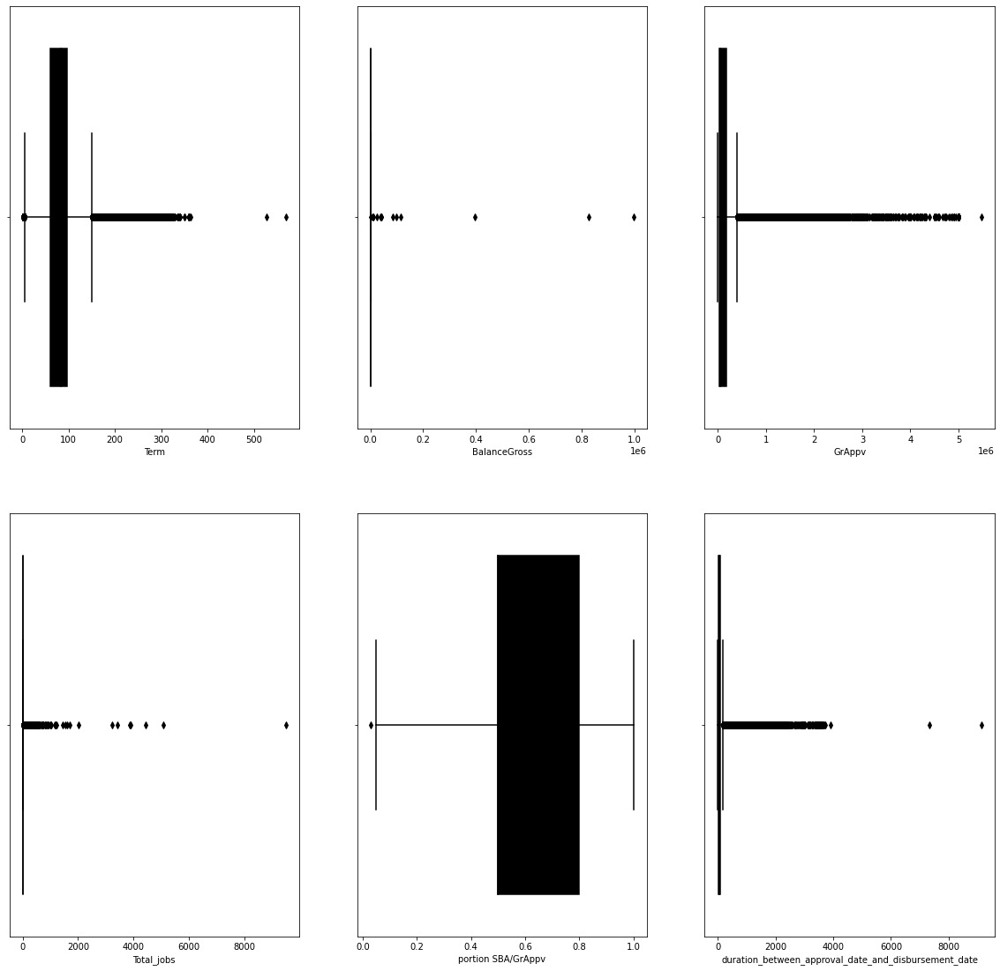

In [ ]:
k=1
plt.figure(figsize=(20,30))
for feature in numerical_features1:
    plt.subplot(3,3,k)
    sns.boxplot(data=credit_data,x=credit_data[feature],color='black')
    k=k+1

In [ ]:
import shap
from catboost import CatBoostClassifier,Pool

cat_classifier=CatBoostClassifier(learning_rate = 0.02,eval_metric = 'F1',verbose=False)
cat_classifier.fit(x__scaled__train, y_res1)

explainer_cat = shap.Explainer(cat_classifier)
shap_values_cat = explainer_cat(x__scaled__train)

Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.


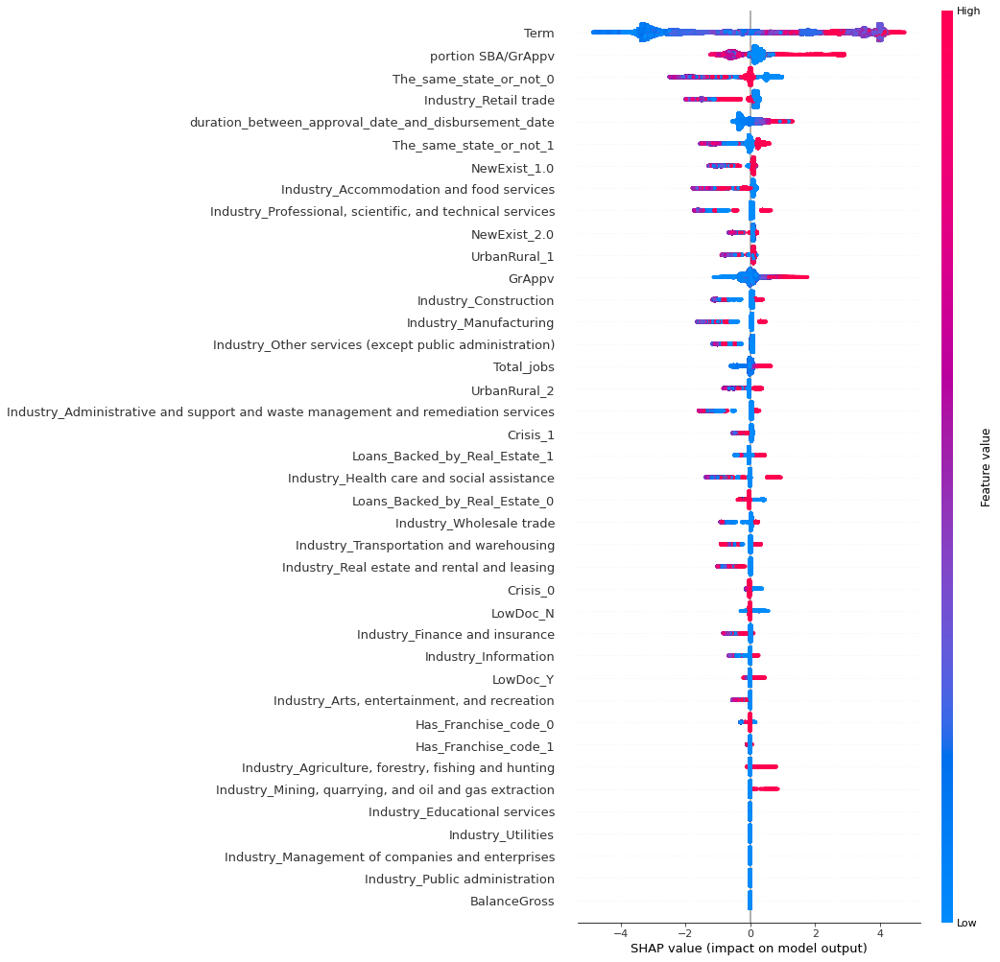

In [ ]:
shap.summary_plot(shap_values_cat, features = x__scaled__train, feature_names = OHE_X_train8.columns, max_display = 90)

In [ ]:
x__scaled__train=pd.DataFrame(x__scaled__train)

In [ ]:
x__scaled__train.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39
0,4.142857,0.0,0.465490,0.2,2.0,0.992969,-1.264542,1.264542,-1.0,1.0,0.0,0.0,-1.0,1.0,0.0,0.0,-1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,4.142857,0.0,10.032103,3.2,2.0,14.474434,0.000000,0.000000,0.0,0.0,0.0,0.0,-1.0,1.0,-1.0,1.0,-1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,4.142857,0.0,1.252006,0.6,2.0,1.031160,0.000000,0.000000,0.0,0.0,0.0,0.0,-1.0,1.0,0.0,0.0,-1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,-0.261905,0.0,0.000000,0.8,0.0,-0.611058,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
4,-0.357143,0.0,0.000000,1.0,0.0,-0.591962,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [ ]:
list_of_numerical=x__scaled__train.loc[:,[0,1,2,3,4,5]]

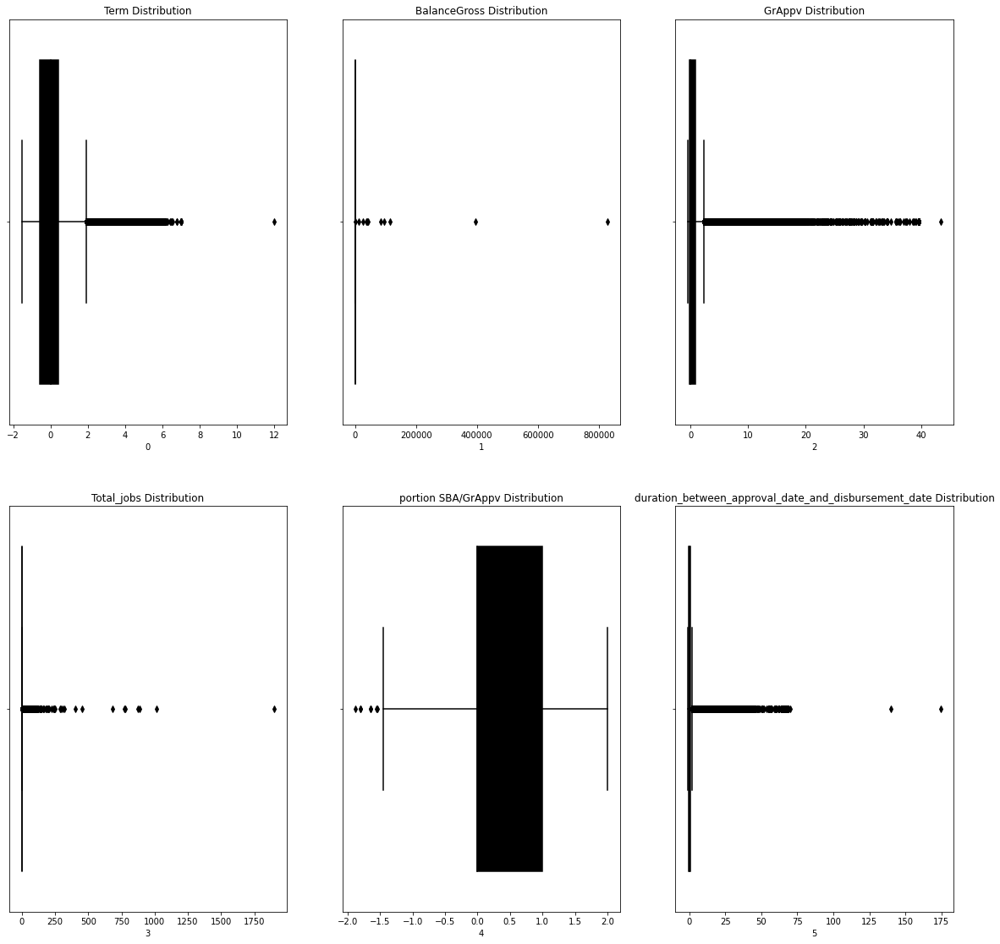

In [ ]:
k=1
plt.figure(figsize=(20,30))
for feature in list_of_numerical:
    plt.subplot(3,3,k)
    sns.boxplot(data=x__scaled__train,x=x__scaled__train[feature],color='black')
    plt.title(f'{X_res1.columns[feature]} Distribution')
    k=k+1

In [ ]:
x__scaled__train.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39
0,4.142857,0.0,0.465490,0.2,2.0,0.992969,-1.264542,1.264542,-1.0,1.0,0.0,0.0,-1.0,1.0,0.0,0.0,-1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,4.142857,0.0,10.032103,3.2,2.0,14.474434,0.000000,0.000000,0.0,0.0,0.0,0.0,-1.0,1.0,-1.0,1.0,-1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,4.142857,0.0,1.252006,0.6,2.0,1.031160,0.000000,0.000000,0.0,0.0,0.0,0.0,-1.0,1.0,0.0,0.0,-1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,-0.261905,0.0,0.000000,0.8,0.0,-0.611058,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
4,-0.357143,0.0,0.000000,1.0,0.0,-0.591962,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [ ]:
x__scaled__train.shape

(663266, 40)

In [ ]:
mutual_info_1  = mutual_info_classif(x__scaled__train,y_res1)

In [ ]:
mutual_info1 = pd.Series(mutual_info_1)
mutual_info1.index = X_res1.columns
mutual_info1.sort_values(ascending=False)

Term                                                                                 0.532976
duration_between_approval_date_and_disbursement_date                                 0.259478
Total_jobs                                                                           0.220530
The_same_state_or_not_1                                                              0.129125
The_same_state_or_not_0                                                              0.128532
portion SBA/GrAppv                                                                   0.089603
NewExist_2.0                                                                         0.086884
NewExist_1.0                                                                         0.086717
Industry_Retail trade                                                                0.080931
UrbanRural_2                                                                         0.067960
UrbanRural_1                                                

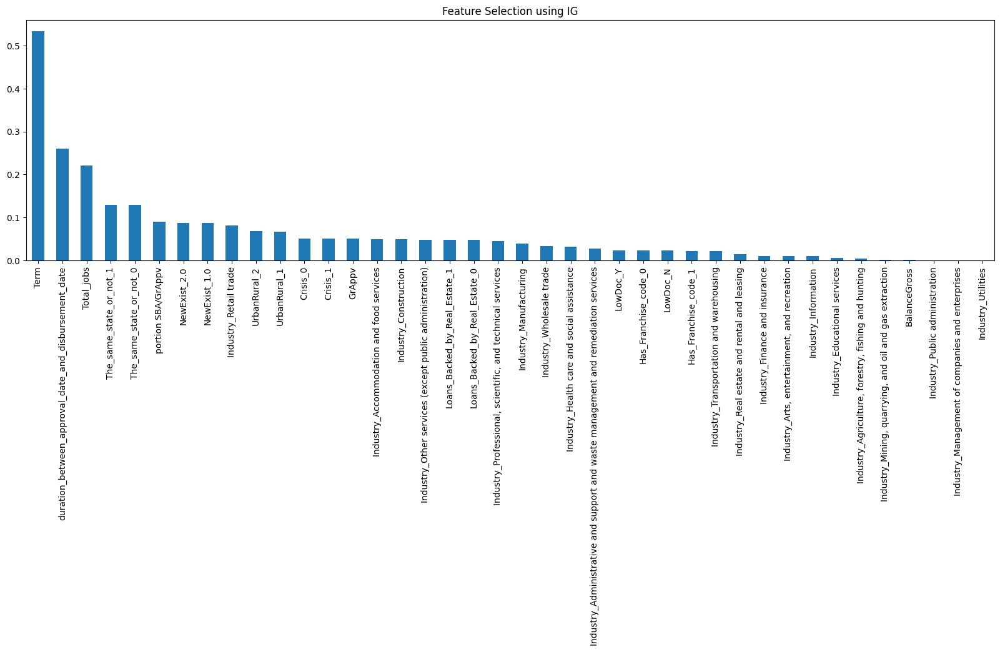

In [ ]:
mutual_info1.sort_values(ascending=False).plot.bar(figsize=(20, 5))
plt.title('Feature Selection using IG')
plt.show()




In [ ]:
from sklearn.feature_selection import SelectKBest
import sklearn.feature_selection as fs
# apply SelectKBest class to extract top 10 best features
bestfeatures = SelectKBest(fs.f_classif, k=10)
fit = bestfeatures.fit(x__scaled__train, y_res1)
dfscores = pd.DataFrame(fit.scores_) #getting scores
dfcolumns = pd.DataFrame(X_res1.columns) #getting columns
featureScores = pd.concat([dfcolumns, dfscores], axis=1)
featureScores.columns = ['Specs', 'Score']


In [ ]:
featureScores.sort_values("Score", ascending = False, inplace = True)

In [ ]:
import plotly.express as px

fig = px.bar(featureScores, x='Specs', y='Score',title="Anova Scores",width=1000)
fig.show()

In [ ]:
x__scaled__train_df=pd.DataFrame(x__scaled__train)
x__scaled__test_df=pd.DataFrame(x__scaled_test)

In [ ]:
x__scaled__train_df.shape

(663266, 40)

In [ ]:
x__scaled__train_df.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39
0,4.142857,0.0,0.465490,0.2,2.0,0.992969,-1.264542,1.264542,-1.0,1.0,0.0,0.0,-1.0,1.0,0.0,0.0,-1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,4.142857,0.0,10.032103,3.2,2.0,14.474434,0.000000,0.000000,0.0,0.0,0.0,0.0,-1.0,1.0,-1.0,1.0,-1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,4.142857,0.0,1.252006,0.6,2.0,1.031160,0.000000,0.000000,0.0,0.0,0.0,0.0,-1.0,1.0,0.0,0.0,-1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,-0.261905,0.0,0.000000,0.8,0.0,-0.611058,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
4,-0.357143,0.0,0.000000,1.0,0.0,-0.591962,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=3)
X_train_transformed2 = pca.fit_transform(x__scaled__train_df)
X_test_transformed2 = pca.transform(x__scaled__test_df)

In [ ]:
cdict = {0:'C',1:'P'}
label = {0:'CHOFF',1:'Pay In Full'}
y__ = y_res1

In [ ]:
from sklearn.decomposition import PCA

pca2 = PCA(n_components=0.95)
X_train_transformed_2 = pca2.fit_transform(x__scaled__train_df)
X_test_transformed_2 = pca2.transform(x__scaled__test_df)

In [ ]:
import plotly.express as px



pca1 = PCA(n_components=3)
components = pca1.fit_transform(x__scaled__train_df)
total_var = pca1.explained_variance_ratio_.sum() * 100

fig = px.scatter_3d(
    components, x=0, y=1, z=2, color=y_res1,
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'})

fig.show()

# fig = plt.figure(figsize=(14,9))
# ax = fig.add_subplot(111,
#                      projection='3d')

# for l in np.unique(y):
#  ix=np.where(y==l)
#  ax.scatter(components[:,0],
#             components[:,1],
#             components[:,2],
#             # c=cdict[l],
#             s=60,
#            label=label[l])

# ax.set_xlabel("PC1",
#               fontsize=12)
# ax.set_ylabel("PC2",
#               fontsize=12)
# ax.set_zlabel("PC3",
#               fontsize=12)

# ax.view_init(30, 125)
# ax.legend()
# plt.title("3D PCA plot")
# plt.show()

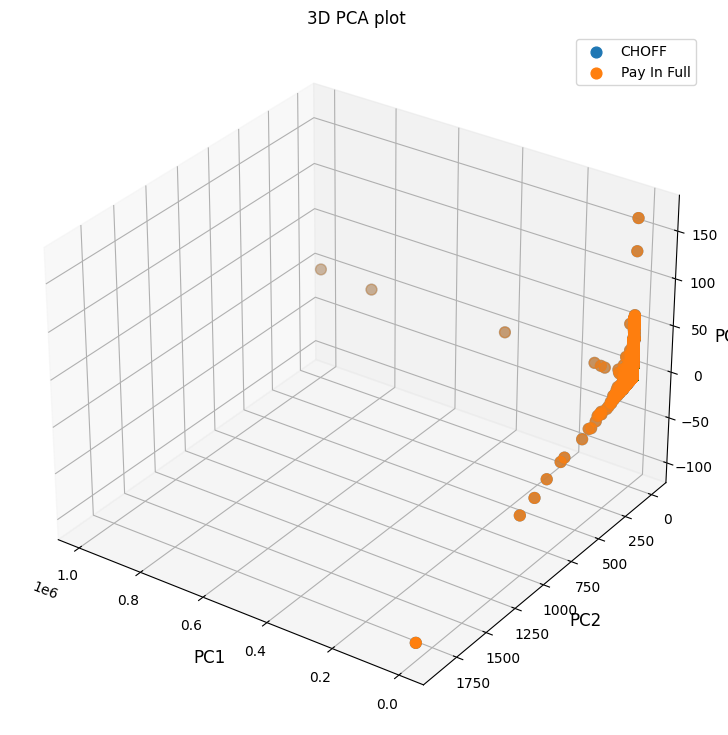

In [ ]:
pca1 = PCA(n_components=3)
components = pca1.fit_transform(x__scaled__train_df)
total_var = pca1.explained_variance_ratio_.sum() * 100

fig = plt.figure(figsize=(14,9))
ax = fig.add_subplot(111,
                     projection='3d')

for l in np.unique(y__):
 ix=np.where(y__==l)
 ax.scatter(components[:,0],
            components[:,1],
            components[:,2],
            # c=cdict[l],
            s=60,
           label=label[l])

ax.set_xlabel("PC1",
              fontsize=12)
ax.set_ylabel("PC2",
              fontsize=12)
ax.set_zlabel("PC3",
              fontsize=12)

ax.view_init(30, 125)
ax.legend()
plt.title("3D PCA plot")
plt.show()

Selected By IG

In [ ]:
IG_train_features=x__scaled__train_df.loc[:,[0,3,5,4,6,12]]

In [ ]:
IG_test_features=x__scaled__test_df.loc[:,[0,3,5,4,6,12]]

Select Features by Anova

In [ ]:
X_train_features=x__scaled__train_df.loc[:,[0,2,12,5,4,16]]

In [ ]:
X_test_features=x__scaled__test_df.loc[:,[0,2,12,5,4,16]]

# Random Forest Tree

Random Forest Tree with All features

In [ ]:
from sklearn.ensemble import RandomForestClassifier


forest_classifier_all=RandomForestClassifier(n_estimators=7,
    min_samples_split=13,max_depth=11, random_state=42)

forest_classifier_all.fit(x__scaled__train_df, y_res1)

forest_pred_all=forest_classifier_all.predict(x__scaled__test_df)
forest_train_all=forest_classifier_all.predict(x__scaled__train_df)


In [ ]:
importances = forest_classifier_all.feature_importances_

In [ ]:
# Set the threshold
threshold = 0.0356

# Get the indices of the features with importance scores greater than the threshold
indices = np.where(importances > threshold)[0]
indices

array([ 0, 12, 13], dtype=int64)

In [ ]:
X_selected_train_selected = x__scaled__train_df.iloc[:, indices]
X_selected_test_selected= x__scaled__test_df.iloc[:, indices]

In [ ]:
print(classification_report(y_res1,forest_train_all))

              precision    recall  f1-score   support

           0       0.92      0.90      0.91    331633
           1       0.90      0.92      0.91    331633

    accuracy                           0.91    663266
   macro avg       0.91      0.91      0.91    663266
weighted avg       0.91      0.91      0.91    663266



In [ ]:
print(classification_report(y_test,forest_pred_all))
print('Accuracy for training data: % {0:.2f} '.format(forest_classifier_all.score(x__scaled__train_df, y_res1)*100),end='\n' )
accuracy=accuracy_score(y_test,forest_pred_all)
print('Test Accuracy is: % {0:.2f}'.format(accuracy*100))

              precision    recall  f1-score   support

           0       0.73      0.74      0.73     25875
           1       0.92      0.92      0.92     82981

    accuracy                           0.87    108856
   macro avg       0.83      0.83      0.83    108856
weighted avg       0.87      0.87      0.87    108856

Accuracy for training data: % 90.86 
Test Accuracy is: % 87.36


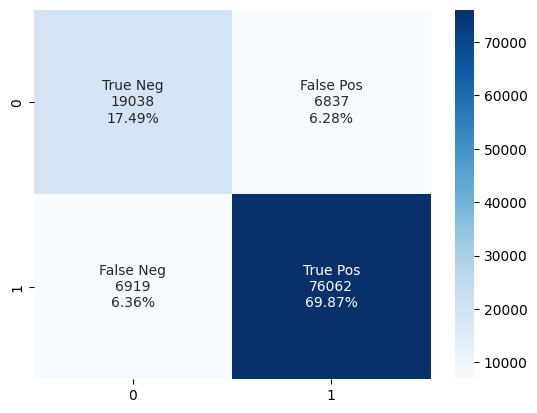

In [ ]:
cm11=confusion_matrix(y_test,forest_pred_all)
group_names = ['True Neg','False Pos','False Neg','True Pos']
group_counts = ['{0:0.0f}'.format(value) for value in
                cm11.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     cm11.flatten()/np.sum(cm11)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cm11, annot=labels, fmt='', cmap='Blues')
plt.show()

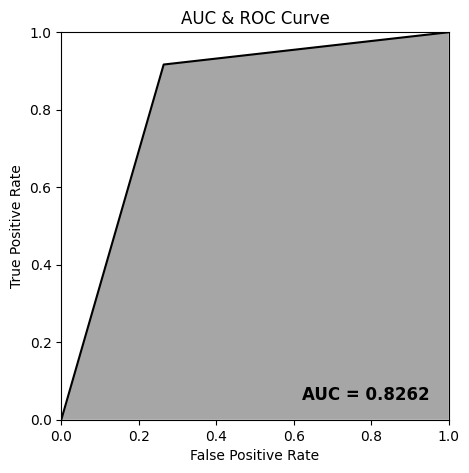

In [ ]:
AUC1 = metrics.roc_auc_score(y_test, forest_pred_all)

false_positive_rate, true_positive_rate, thresolds = metrics.roc_curve(y_test, forest_pred_all)

plt.figure(figsize=(5, 8), dpi=100)
plt.axis('scaled')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.title("AUC & ROC Curve")
plt.plot(false_positive_rate, true_positive_rate, 'black')
plt.fill_between(false_positive_rate, true_positive_rate, facecolor='grey', alpha=0.7)
plt.text(0.95, 0.05, 'AUC = %0.4f' % AUC1, ha='right', fontsize=12, weight='bold', color='black')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.show()

In [ ]:
from sklearn.metrics import matthews_corrcoef
matthews_corrcoef(y_test, forest_pred_all)

0.6516783653589103

In [ ]:
import pickle
filenametree='Random Forest Tree with all'
pickle.dump(forest_classifier_all,open(filenametree,'wb'))

Using features that selected by Feature Importance (Random Forest Tree)

In [ ]:
forest_classifier_all.fit(X_selected_train_selected, y_res1)

forest_pred_all_selected=forest_classifier_all.predict(X_selected_test_selected)
forest_train_all_selected=forest_classifier_all.predict(X_selected_train_selected)

In [ ]:
print(classification_report(y_res1,forest_train_all_selected))

              precision    recall  f1-score   support

           0       0.93      0.94      0.94    331633
           1       0.94      0.93      0.94    331633

    accuracy                           0.94    663266
   macro avg       0.94      0.94      0.94    663266
weighted avg       0.94      0.94      0.94    663266



In [ ]:
print(classification_report(y_test,forest_pred_all_selected))
print('Accuracy for training data: % {0:.2f} '.format(forest_classifier_all.score(X_selected_train_selected, y_res1)*100),end='\n' )
accuracy=accuracy_score(y_test,forest_pred_all_selected)
print('Test Accuracy is: % {0:.2f}'.format(accuracy*100))

              precision    recall  f1-score   support

           0       0.79      0.87      0.83     25875
           1       0.96      0.93      0.94     82981

    accuracy                           0.91    108856
   macro avg       0.87      0.90      0.89    108856
weighted avg       0.92      0.91      0.92    108856

Accuracy for training data: % 93.71 
Test Accuracy is: % 91.41


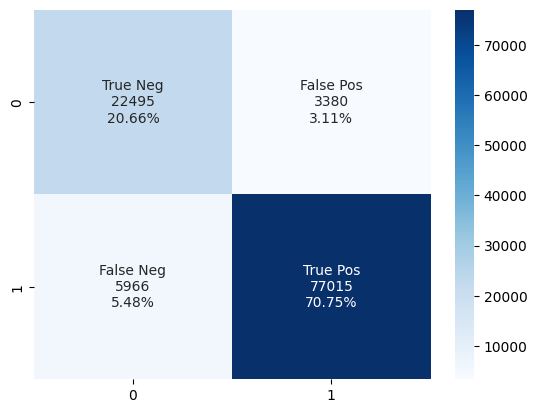

In [ ]:
cm_features=confusion_matrix(y_test,forest_pred_all_selected)
group_names = ['True Neg','False Pos','False Neg','True Pos']
group_counts = ['{0:0.0f}'.format(value) for value in
                cm_features.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     cm_features.flatten()/np.sum(cm_features)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cm_features, annot=labels, fmt='', cmap='Blues')
plt.show()

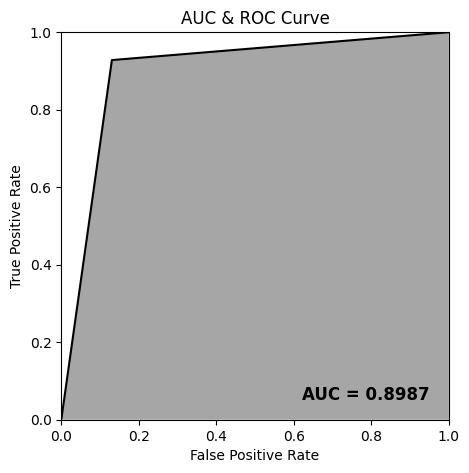

In [ ]:
AUC_tree = metrics.roc_auc_score(y_test, forest_pred_all_selected)

false_positive_rate, true_positive_rate, thresolds = metrics.roc_curve(y_test, forest_pred_all_selected)

plt.figure(figsize=(5, 8), dpi=100)
plt.axis('scaled')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.title("AUC & ROC Curve")
plt.plot(false_positive_rate, true_positive_rate, 'black')
plt.fill_between(false_positive_rate, true_positive_rate, facecolor='grey', alpha=0.7)
plt.text(0.95, 0.05, 'AUC = %0.4f' % AUC_tree, ha='right', fontsize=12, weight='bold', color='black')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.show()

In [ ]:
matthews_corrcoef(y_test, forest_pred_all_selected)

0.7725160980163037

In [ ]:
import pickle
filename_tree='Random Forest Tree with specific features'
pickle.dump(forest_classifier_all,open(filename_tree,'wb'))

Random Forest Tree with PCA

In [ ]:
PCA_trial = RandomForestClassifier(max_depth=7, random_state=42)


PCA_trial.fit(X_train_transformed2, y_res1)
y_pca_predicted = PCA_trial.predict(X_test_transformed2)
forest_train_pca=PCA_trial.predict(X_train_transformed2)

In [ ]:
print(classification_report(y_res1,forest_train_pca))

              precision    recall  f1-score   support

           0       0.76      0.61      0.68    331633
           1       0.68      0.81      0.74    331633

    accuracy                           0.71    663266
   macro avg       0.72      0.71      0.71    663266
weighted avg       0.72      0.71      0.71    663266



In [ ]:
print(classification_report(y_test,y_pca_predicted))
print('Accuracy for training data: % {0:.2f} '.format(PCA_trial.score(X_train_transformed2, y_res1)*100),end='\n' )
accuracy=accuracy_score(y_test,y_pca_predicted)
print('Test Accuracy is: % {0:.2f}'.format(accuracy*100))

              precision    recall  f1-score   support

           0       0.49      0.59      0.53     25875
           1       0.86      0.81      0.83     82981

    accuracy                           0.76    108856
   macro avg       0.68      0.70      0.68    108856
weighted avg       0.77      0.76      0.76    108856

Accuracy for training data: % 71.03 
Test Accuracy is: % 75.57


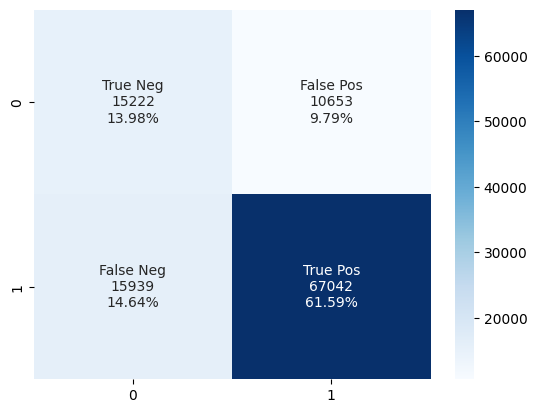

In [ ]:
cm_14=confusion_matrix(y_test,y_pca_predicted)
group_names = ['True Neg','False Pos','False Neg','True Pos']
group_counts = ['{0:0.0f}'.format(value) for value in
                cm_14.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     cm_14.flatten()/np.sum(cm_14)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cm_14, annot=labels, fmt='', cmap='Blues')
plt.show()

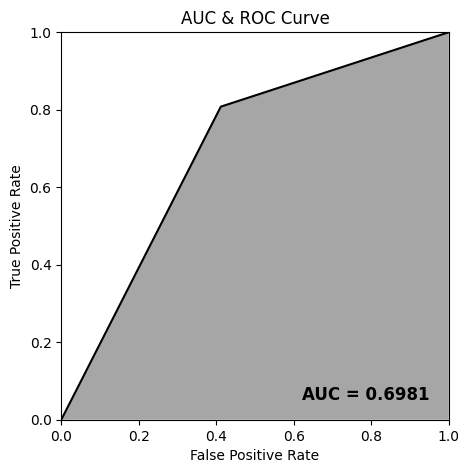

In [ ]:
AUC_2 = metrics.roc_auc_score(y_test, y_pca_predicted)

false_positive_rate, true_positive_rate, thresolds = metrics.roc_curve(y_test, y_pca_predicted)

plt.figure(figsize=(5, 8), dpi=100)
plt.axis('scaled')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.title("AUC & ROC Curve")
plt.plot(false_positive_rate, true_positive_rate, 'black')
plt.fill_between(false_positive_rate, true_positive_rate, facecolor='grey', alpha=0.7)
plt.text(0.95, 0.05, 'AUC = %0.4f' % AUC_2, ha='right', fontsize=12, weight='bold', color='black')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.show()

In [ ]:
matthews_corrcoef(y_test, y_pca_predicted)

0.37312335225259696

In [ ]:
import pickle
filenametree1='Random Forest Tree with pca'
pickle.dump(PCA_trial,open(filenametree1,'wb'))

PCA with 95 % variance

In [ ]:
PCA_trial = RandomForestClassifier(max_depth=7,random_state=42)


PCA_trial.fit(X_train_transformed_2, y_res1)
y_pca_predicted_2 = PCA_trial.predict(X_test_transformed_2)
forest_train_pca_2=PCA_trial.predict(X_train_transformed_2)

In [ ]:
print(classification_report(y_res1,forest_train_pca_2))

              precision    recall  f1-score   support

           0       0.74      0.58      0.65    331633
           1       0.66      0.80      0.72    331633

    accuracy                           0.69    663266
   macro avg       0.70      0.69      0.69    663266
weighted avg       0.70      0.69      0.69    663266



In [ ]:
print(classification_report(y_test,y_pca_predicted_2))
print('Accuracy for training data: % {0:.2f} '.format(PCA_trial.score(X_train_transformed_2, y_res1)*100),end='\n' )
accuracy=accuracy_score(y_test,y_pca_predicted_2)
print('Test Accuracy is: % {0:.2f}'.format(accuracy*100))

              precision    recall  f1-score   support

           0       0.47      0.58      0.52     25875
           1       0.86      0.80      0.83     82981

    accuracy                           0.74    108856
   macro avg       0.66      0.69      0.67    108856
weighted avg       0.77      0.74      0.75    108856

Accuracy for training data: % 68.97 
Test Accuracy is: % 74.44


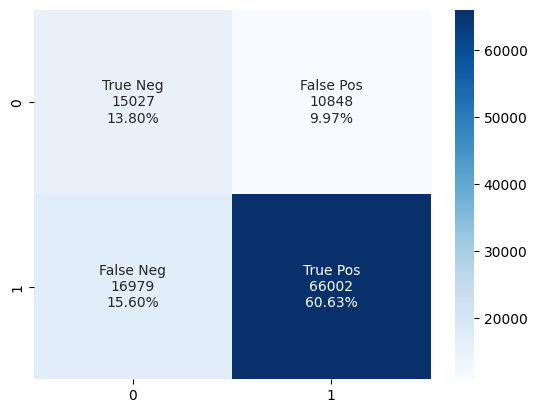

In [ ]:
cm_features_pca=confusion_matrix(y_test,y_pca_predicted_2)
group_names = ['True Neg','False Pos','False Neg','True Pos']
group_counts = ['{0:0.0f}'.format(value) for value in
                cm_features_pca.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     cm_features_pca.flatten()/np.sum(cm_features_pca)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cm_features_pca, annot=labels, fmt='', cmap='Blues')
plt.show()

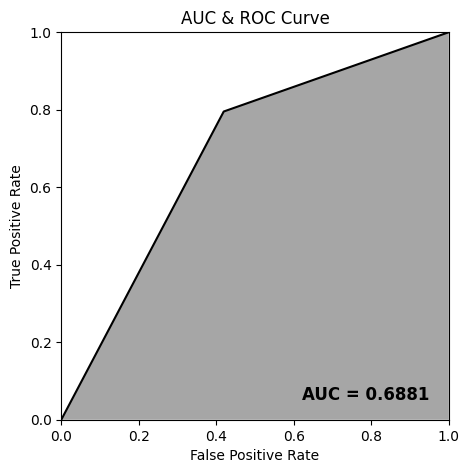

In [ ]:
AUC_2 = metrics.roc_auc_score(y_test, y_pca_predicted_2)

false_positive_rate, true_positive_rate, thresolds = metrics.roc_curve(y_test, y_pca_predicted_2)

plt.figure(figsize=(5, 8), dpi=100)
plt.axis('scaled')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.title("AUC & ROC Curve")
plt.plot(false_positive_rate, true_positive_rate, 'black')
plt.fill_between(false_positive_rate, true_positive_rate, facecolor='grey', alpha=0.7)
plt.text(0.95, 0.05, 'AUC = %0.4f' % AUC_2, ha='right', fontsize=12, weight='bold', color='black')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.show()

In [ ]:
matthews_corrcoef(y_test, y_pca_predicted_2)

0.3514325586041585

In [ ]:
import pickle
filenametree2='Random Forest Tree with pca 95 %'
pickle.dump(PCA_trial,open(filenametree2,'wb'))

Random Forest Tree With ANOVA

In [ ]:
forest_classifier_annova=RandomForestClassifier(n_estimators=7,
min_samples_split=13,max_depth=11,random_state=42)

forest_classifier_annova.fit(X_train_features, y_res1)

forest_pred_annova=forest_classifier_annova.predict(X_test_features)

forest_train_anova=forest_classifier_annova.predict(X_train_features)


In [ ]:
print(classification_report(y_res1,forest_train_anova))

              precision    recall  f1-score   support

           0       0.92      0.93      0.92    331633
           1       0.93      0.92      0.92    331633

    accuracy                           0.92    663266
   macro avg       0.92      0.92      0.92    663266
weighted avg       0.92      0.92      0.92    663266



              precision    recall  f1-score   support

           0       0.76      0.86      0.81     25875
           1       0.95      0.92      0.93     82981

    accuracy                           0.90    108856
   macro avg       0.86      0.89      0.87    108856
weighted avg       0.91      0.90      0.90    108856

Accuracy for training data: % 92.44 
Test Accuracy is: % 90.21


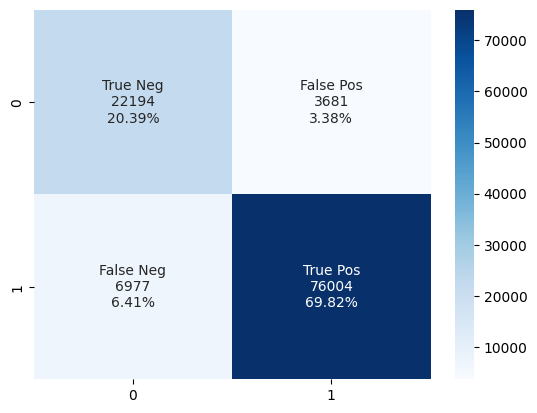

In [ ]:
print(classification_report(y_test,forest_pred_annova))
print('Accuracy for training data: % {0:.2f} '.format(forest_classifier_annova.score(X_train_features, y_res1)*100),end='\n' )
accuracy=accuracy_score(y_test,forest_pred_annova)
print('Test Accuracy is: % {0:.2f}'.format(accuracy*100))

cm12=confusion_matrix(y_test,forest_pred_annova)
group_names = ['True Neg','False Pos','False Neg','True Pos']
group_counts = ['{0:0.0f}'.format(value) for value in
                cm12.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     cm12.flatten()/np.sum(cm12)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cm12, annot=labels, fmt='', cmap='Blues')
plt.show()

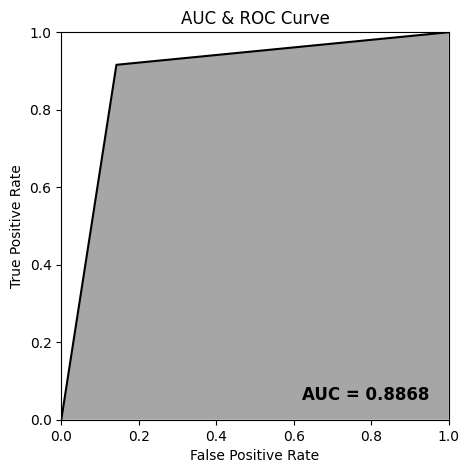

In [ ]:
AUC3 = metrics.roc_auc_score(y_test, forest_pred_annova)

false_positive_rate, true_positive_rate, thresolds = metrics.roc_curve(y_test, forest_pred_annova)

plt.figure(figsize=(5, 8), dpi=100)
plt.axis('scaled')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.title("AUC & ROC Curve")
plt.plot(false_positive_rate, true_positive_rate, 'black')
plt.fill_between(false_positive_rate, true_positive_rate, facecolor='grey', alpha=0.7)
plt.text(0.95, 0.05, 'AUC = %0.4f' % AUC3, ha='right', fontsize=12, weight='bold', color='black')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.show()

In [ ]:
matthews_corrcoef(y_test, forest_pred_annova)

0.7435591235965171

In [ ]:
import pickle
filenametree3='Random Forest Tree with ANOVA'
pickle.dump(forest_classifier_annova,open(filenametree3,'wb'))

Random Forest Tree with IG

In [ ]:
forest_classifier_IG=RandomForestClassifier(n_estimators=7,
min_samples_split=13,max_depth=11,random_state=42)

forest_classifier_IG.fit(IG_train_features, y_res1)

forest_pred_IG=forest_classifier_IG.predict(IG_test_features)
forest_train_IG=forest_classifier_IG.predict(IG_train_features)


In [ ]:
print(classification_report(y_res1,forest_train_IG))

              precision    recall  f1-score   support

           0       0.92      0.94      0.93    331633
           1       0.94      0.92      0.93    331633

    accuracy                           0.93    663266
   macro avg       0.93      0.93      0.93    663266
weighted avg       0.93      0.93      0.93    663266



In [ ]:
print(classification_report(y_test,forest_pred_IG))
print('Accuracy for training data: % {0:.2f} '.format(forest_classifier_IG.score(IG_train_features, y_res1)*100),end='\n' )
accuracy=accuracy_score(y_test,forest_pred_IG)
print('Test Accuracy is: % {0:.2f}'.format(accuracy*100))

              precision    recall  f1-score   support

           0       0.76      0.85      0.80     25875
           1       0.95      0.92      0.93     82981

    accuracy                           0.90    108856
   macro avg       0.85      0.88      0.87    108856
weighted avg       0.90      0.90      0.90    108856

Accuracy for training data: % 92.66 
Test Accuracy is: % 89.86


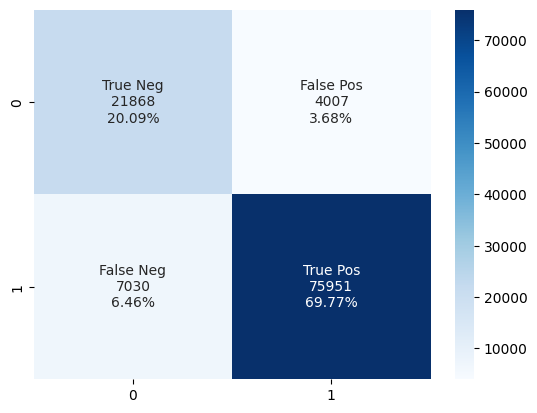

In [ ]:
cm18=confusion_matrix(y_test,forest_pred_IG)
group_names = ['True Neg','False Pos','False Neg','True Pos']
group_counts = ['{0:0.0f}'.format(value) for value in
                cm18.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     cm18.flatten()/np.sum(cm18)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cm18, annot=labels, fmt='', cmap='Blues')
plt.show()

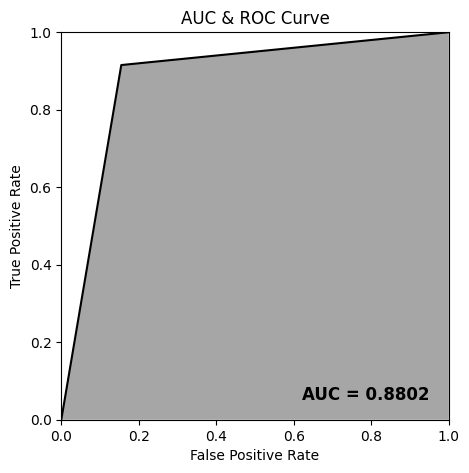

In [ ]:
AUC4 = metrics.roc_auc_score(y_test, forest_pred_IG)

false_positive_rate, true_positive_rate, thresolds = metrics.roc_curve(y_test, forest_pred_IG)

plt.figure(figsize=(5, 8), dpi=100)
plt.axis('scaled')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.title("AUC & ROC Curve")
plt.plot(false_positive_rate, true_positive_rate, 'black')
plt.fill_between(false_positive_rate, true_positive_rate, facecolor='grey', alpha=0.7)
plt.text(0.95, 0.05, 'AUC = %0.4f' % AUC4, ha='right', fontsize=12, weight='bold', color='black')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.show()

In [ ]:
matthews_corrcoef(y_test, forest_pred_IG)

0.7330258282112907

In [ ]:
import pickle
filenametree4='Random Forest Tree with IG'
pickle.dump(forest_classifier_IG,open(filenametree4,'wb'))

# Adaboost

Adaboost With All Features

In [ ]:
from sklearn.ensemble import AdaBoostClassifier
first_trial = AdaBoostClassifier(n_estimators=7,learning_rate=0.2,random_state=42)


first_trial.fit(x__scaled__train_df, y_res1)
y_predicted = first_trial.predict(x__scaled__test_df)
ada_train_all=first_trial.predict(x__scaled__train_df)

In [ ]:
print(classification_report(y_res1,ada_train_all))

              precision    recall  f1-score   support

           0       0.83      0.84      0.83    331633
           1       0.84      0.82      0.83    331633

    accuracy                           0.83    663266
   macro avg       0.83      0.83      0.83    663266
weighted avg       0.83      0.83      0.83    663266



In [ ]:
print(classification_report(y_test,y_predicted))
print('Accuracy for training data: % {0:.2f} '.format(first_trial.score(x__scaled__train_df, y_res1)*100),end='\n' )
accuracy=accuracy_score(y_test,y_predicted)
print('Test Accuracy is: % {0:.2f}'.format(accuracy*100))

              precision    recall  f1-score   support

           0       0.59      0.82      0.68     25875
           1       0.94      0.82      0.87     82981

    accuracy                           0.82    108856
   macro avg       0.76      0.82      0.78    108856
weighted avg       0.85      0.82      0.83    108856

Accuracy for training data: % 83.24 
Test Accuracy is: % 82.00


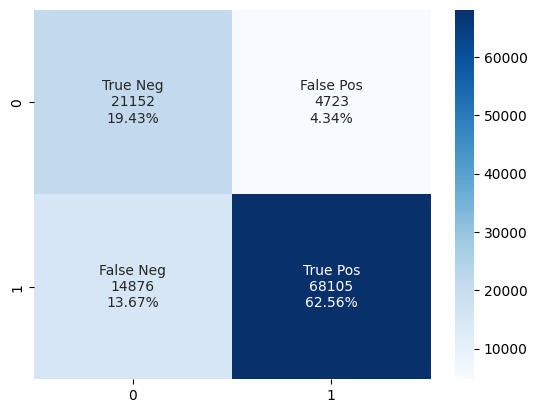

In [ ]:
cm1=confusion_matrix(y_test,y_predicted)
group_names = ['True Neg','False Pos','False Neg','True Pos']
group_counts = ['{0:0.0f}'.format(value) for value in
                cm1.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     cm1.flatten()/np.sum(cm1)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cm1, annot=labels, fmt='', cmap='Blues')
plt.show()

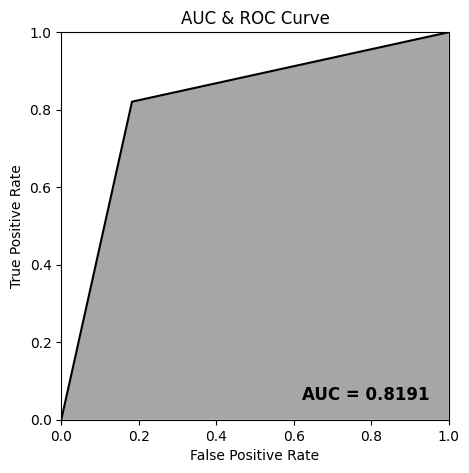

In [ ]:
AUC5 = metrics.roc_auc_score(y_test, y_predicted)

false_positive_rate, true_positive_rate, thresolds = metrics.roc_curve(y_test, y_predicted)

plt.figure(figsize=(5, 8), dpi=100)
plt.axis('scaled')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.title("AUC & ROC Curve")
plt.plot(false_positive_rate, true_positive_rate, 'black')
plt.fill_between(false_positive_rate, true_positive_rate, facecolor='grey', alpha=0.7)
plt.text(0.95, 0.05, 'AUC = %0.4f' % AUC5, ha='right', fontsize=12, weight='bold', color='black')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.show()

In [ ]:
matthews_corrcoef(y_test, y_predicted)

0.5773193590080649

In [ ]:
filenameada='adaboost with all features'
pickle.dump(first_trial,open(filenameada,'wb'))

Adaboost with PCA

In [ ]:
PCA_adatrial = AdaBoostClassifier(n_estimators=7,learning_rate=0.2,random_state=42)


PCA_adatrial.fit(X_train_transformed2, y_res1)
y_pca_adapredicted = PCA_adatrial.predict(X_test_transformed2)
train_pca_adapredicted = PCA_adatrial.predict(X_train_transformed2)

print(classification_report(y_res1,train_pca_adapredicted))

              precision    recall  f1-score   support

           0       0.74      0.58      0.65    331633
           1       0.66      0.79      0.72    331633

    accuracy                           0.69    663266
   macro avg       0.70      0.69      0.69    663266
weighted avg       0.70      0.69      0.69    663266



In [ ]:
print(classification_report(y_test,y_pca_adapredicted))
print('Accuracy for training data: % {0:.2f} '.format(PCA_adatrial.score(X_train_transformed2, y_res1)*100),end='\n' )
accuracy=accuracy_score(y_test,y_pca_adapredicted)
print('Test Accuracy is: % {0:.2f}'.format(accuracy*100))

              precision    recall  f1-score   support

           0       0.47      0.58      0.52     25875
           1       0.86      0.79      0.83     82981

    accuracy                           0.74    108856
   macro avg       0.66      0.69      0.67    108856
weighted avg       0.77      0.74      0.75    108856

Accuracy for training data: % 68.96 
Test Accuracy is: % 74.40


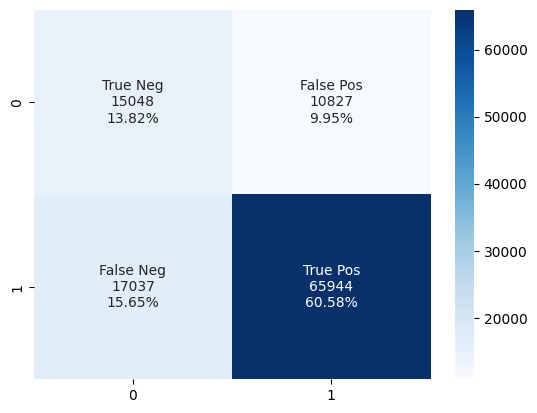

In [ ]:
cm19=confusion_matrix(y_test,y_pca_adapredicted)
group_names = ['True Neg','False Pos','False Neg','True Pos']
group_counts = ['{0:0.0f}'.format(value) for value in
                cm19.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     cm19.flatten()/np.sum(cm19)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cm19, annot=labels, fmt='', cmap='Blues')
plt.show()


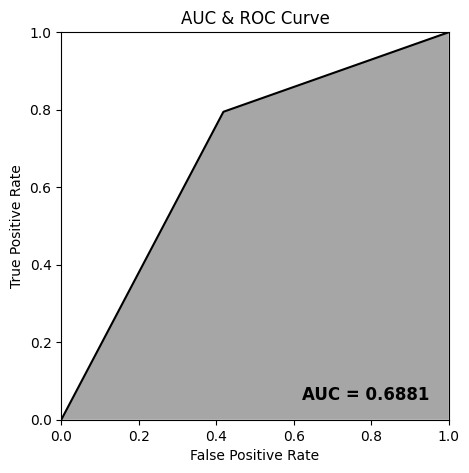

In [ ]:
AUC6 = metrics.roc_auc_score(y_test, y_pca_adapredicted)

false_positive_rate, true_positive_rate, thresolds = metrics.roc_curve(y_test, y_pca_adapredicted)

plt.figure(figsize=(5, 8), dpi=100)
plt.axis('scaled')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.title("AUC & ROC Curve")
plt.plot(false_positive_rate, true_positive_rate, 'black')
plt.fill_between(false_positive_rate, true_positive_rate, facecolor='grey', alpha=0.7)
plt.text(0.95, 0.05, 'AUC = %0.4f' % AUC6, ha='right', fontsize=12, weight='bold', color='black')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.show()

In [ ]:
matthews_corrcoef(y_test, y_pca_adapredicted)

0.3512853549386324

In [ ]:
filenameada2='adaboost with pca'
pickle.dump(PCA_adatrial,open(filenameada2,'wb'))

Adaboost with 95% variance

In [ ]:
PCA_adatrial.fit(X_train_transformed_2, y_res1)
y_pca_adapredicted2 = PCA_adatrial.predict(X_test_transformed_2)
train_pca_adapredicted2 = PCA_adatrial.predict(X_train_transformed_2)

print(classification_report(y_res1,train_pca_adapredicted2))

              precision    recall  f1-score   support

           0       0.74      0.58      0.65    331633
           1       0.66      0.79      0.72    331633

    accuracy                           0.69    663266
   macro avg       0.70      0.69      0.69    663266
weighted avg       0.70      0.69      0.69    663266



In [ ]:
print(classification_report(y_test,y_pca_adapredicted2))
print('Accuracy for training data: % {0:.2f} '.format(PCA_adatrial.score(X_train_transformed_2, y_res1)*100),end='\n' )
accuracy=accuracy_score(y_test,y_pca_adapredicted2)
print('Test Accuracy is: % {0:.2f}'.format(accuracy*100))

              precision    recall  f1-score   support

           0       0.47      0.58      0.52     25875
           1       0.86      0.79      0.83     82981

    accuracy                           0.74    108856
   macro avg       0.66      0.69      0.67    108856
weighted avg       0.77      0.74      0.75    108856

Accuracy for training data: % 68.96 
Test Accuracy is: % 74.40


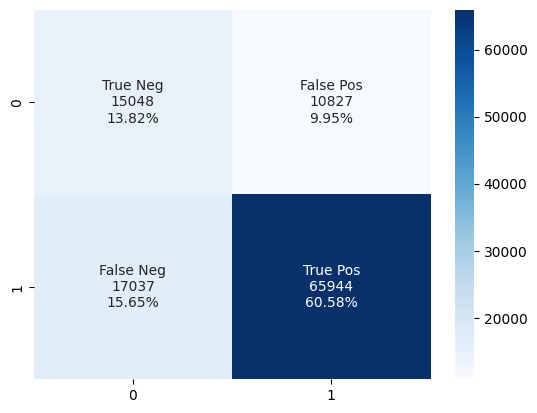

In [ ]:
cm_19=confusion_matrix(y_test,y_pca_adapredicted2)
group_names = ['True Neg','False Pos','False Neg','True Pos']
group_counts = ['{0:0.0f}'.format(value) for value in
                cm_19.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     cm_19.flatten()/np.sum(cm_19)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cm_19, annot=labels, fmt='', cmap='Blues')
plt.show()

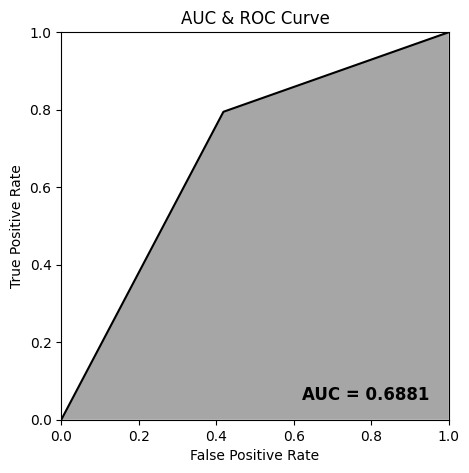

In [ ]:
AUC_6 = metrics.roc_auc_score(y_test, y_pca_adapredicted2)

false_positive_rate, true_positive_rate, thresolds = metrics.roc_curve(y_test, y_pca_adapredicted2)

plt.figure(figsize=(5, 8), dpi=100)
plt.axis('scaled')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.title("AUC & ROC Curve")
plt.plot(false_positive_rate, true_positive_rate, 'black')
plt.fill_between(false_positive_rate, true_positive_rate, facecolor='grey', alpha=0.7)
plt.text(0.95, 0.05, 'AUC = %0.4f' % AUC_6, ha='right', fontsize=12, weight='bold', color='black')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.show()

In [ ]:
matthews_corrcoef(y_test, y_pca_adapredicted2)

0.3512853549386324

In [ ]:
filenameada3='adaboost with pca 95 % variance'
pickle.dump(PCA_adatrial,open(filenameada3,'wb'))

Adaboost features selected by ANOVA

In [ ]:
from sklearn.ensemble import AdaBoostClassifier

f_trial = AdaBoostClassifier(n_estimators=7,learning_rate=0.2,random_state=42)


f_trial.fit(X_train_features, y_res1)
y_anova_predict = f_trial.predict(X_test_features)

y_train_anova=f_trial.predict(X_train_features)

In [ ]:
print(classification_report(y_res1,y_train_anova))

              precision    recall  f1-score   support

           0       0.83      0.84      0.83    331633
           1       0.84      0.82      0.83    331633

    accuracy                           0.83    663266
   macro avg       0.83      0.83      0.83    663266
weighted avg       0.83      0.83      0.83    663266



In [ ]:
# print(predicted_value)
print(classification_report(y_test,y_anova_predict))
print('Accuracy for training data: % {0:.2f} '.format(f_trial.score(X_train_features, y_res1)*100),end='\n' )
accuracy=accuracy_score(y_test,y_anova_predict)
print('Test Accuracy is: % {0:.2f}'.format(accuracy*100))

              precision    recall  f1-score   support

           0       0.59      0.82      0.68     25875
           1       0.94      0.82      0.87     82981

    accuracy                           0.82    108856
   macro avg       0.76      0.82      0.78    108856
weighted avg       0.85      0.82      0.83    108856

Accuracy for training data: % 83.24 
Test Accuracy is: % 82.00


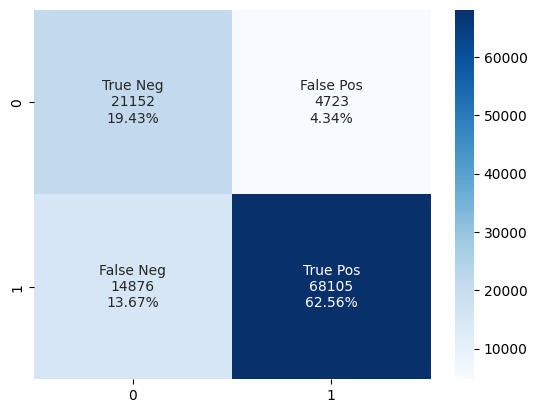

In [ ]:
cm4=confusion_matrix(y_test,y_anova_predict)
group_names = ['True Neg','False Pos','False Neg','True Pos']
group_counts = ['{0:0.0f}'.format(value) for value in
                cm4.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     cm4.flatten()/np.sum(cm4)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cm4, annot=labels, fmt='', cmap='Blues')
plt.show()


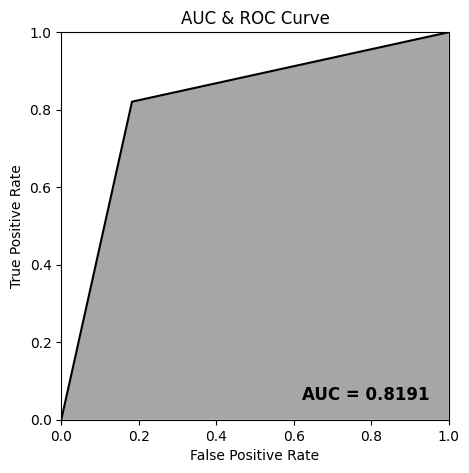

In [ ]:
AUC7 = metrics.roc_auc_score(y_test, y_anova_predict)

false_positive_rate, true_positive_rate, thresolds = metrics.roc_curve(y_test, y_anova_predict)

plt.figure(figsize=(5, 8), dpi=100)
plt.axis('scaled')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.title("AUC & ROC Curve")
plt.plot(false_positive_rate, true_positive_rate, 'black')
plt.fill_between(false_positive_rate, true_positive_rate, facecolor='grey', alpha=0.7)
plt.text(0.95, 0.05, 'AUC = %0.4f' % AUC7, ha='right', fontsize=12, weight='bold', color='black')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.show()

In [ ]:
matthews_corrcoef(y_test, y_anova_predict)

0.5773193590080649

In [ ]:
import pickle
filenameada4='adaboost with  Anova'
pickle.dump(f_trial,open(filenameada4,'wb'))

Adaboost features Selected by IG

In [ ]:
from sklearn.ensemble import AdaBoostClassifier
IG_trial = AdaBoostClassifier(n_estimators=7,learning_rate=0.2,random_state=42)


IG_trial.fit(IG_train_features, y_res1)
IGY_predict = IG_trial.predict(IG_test_features)

In [ ]:
IG_train_predict = IG_trial.predict(IG_train_features)

In [ ]:
print(classification_report(y_res1,IG_train_predict))

              precision    recall  f1-score   support

           0       0.83      0.84      0.83    331633
           1       0.84      0.82      0.83    331633

    accuracy                           0.83    663266
   macro avg       0.83      0.83      0.83    663266
weighted avg       0.83      0.83      0.83    663266



              precision    recall  f1-score   support

           0       0.59      0.82      0.68     25875
           1       0.94      0.82      0.87     82981

    accuracy                           0.82    108856
   macro avg       0.76      0.82      0.78    108856
weighted avg       0.85      0.82      0.83    108856

Accuracy for training data: % 83.24 
Test Accuracy is: % 82.00


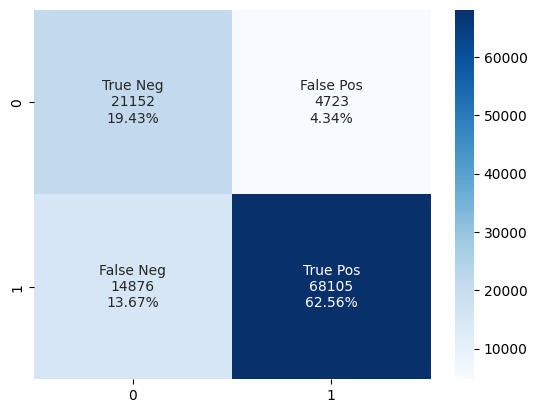

In [ ]:
print(classification_report(y_test,IGY_predict))
print('Accuracy for training data: % {0:.2f} '.format(IG_trial.score(IG_train_features, y_res1)*100),end='\n' )
accuracy=accuracy_score(y_test,IGY_predict)
print('Test Accuracy is: % {0:.2f}'.format(accuracy*100))


cm5=confusion_matrix(y_test,IGY_predict)
group_names = ['True Neg','False Pos','False Neg','True Pos']
group_counts = ['{0:0.0f}'.format(value) for value in
                cm5.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     cm5.flatten()/np.sum(cm5)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cm5, annot=labels, fmt='', cmap='Blues')
plt.show()

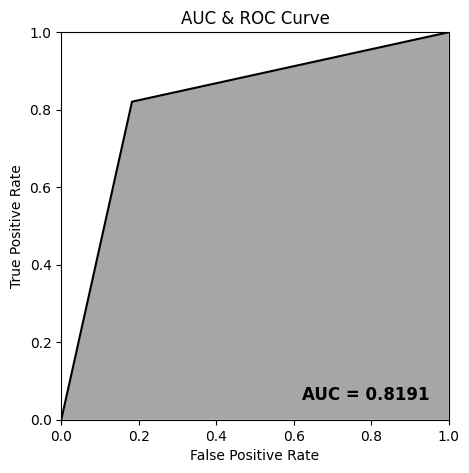

In [ ]:
AUC8 = metrics.roc_auc_score(y_test, IGY_predict)

false_positive_rate, true_positive_rate, thresolds = metrics.roc_curve(y_test, IGY_predict)

plt.figure(figsize=(5, 8), dpi=100)
plt.axis('scaled')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.title("AUC & ROC Curve")
plt.plot(false_positive_rate, true_positive_rate, 'black')
plt.fill_between(false_positive_rate, true_positive_rate, facecolor='grey', alpha=0.7)
plt.text(0.95, 0.05, 'AUC = %0.4f' % AUC8, ha='right', fontsize=12, weight='bold', color='black')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.show()

In [ ]:
matthews_corrcoef(y_test, IGY_predict)

0.5773193590080649

In [ ]:
import pickle
filenameada5='adaboost with IG'
pickle.dump(IG_trial,open(filenameada5,'wb'))

# Xgboost

All Features

In [ ]:
# from sklearn.feature_selection import RFE
from xgboost import XGBClassifier
second_trial=XGBClassifier(n_estimators=11,random_state=42,max_depth =5)

second_trial.fit(x__scaled__train_df, y_res1)
y_hat = second_trial.predict(x__scaled__test_df)

In [ ]:
importances_xg = second_trial.feature_importances_

In [ ]:
threshold = 0.0356
indices_xg = np.where(importances_xg > threshold)[0]

In [ ]:
indices_xg

array([ 0,  8, 12, 16, 20, 27, 30, 36], dtype=int64)

In [ ]:
X_selected_trainxg = x__scaled__train_df.iloc[:, indices_xg]

X_selected_testxg = x__scaled__test_df.iloc[:, indices_xg]


In [ ]:
y_train_hat = second_trial.predict(x__scaled__train_df)

In [ ]:
print(classification_report(y_res1,y_train_hat))

              precision    recall  f1-score   support

           0       0.91      0.95      0.93    331633
           1       0.95      0.91      0.93    331633

    accuracy                           0.93    663266
   macro avg       0.93      0.93      0.93    663266
weighted avg       0.93      0.93      0.93    663266



In [ ]:
print(classification_report(y_test,y_hat))
print('Accuracy for training data: % {0:.2f} '.format(second_trial.score(x__scaled__train_df, y_res1)*100),end='\n' )
accuracy=accuracy_score(y_test,y_hat)
print('Test Accuracy is: % {0:.2f}'.format(accuracy*100))

              precision    recall  f1-score   support

           0       0.75      0.89      0.81     25875
           1       0.96      0.91      0.93     82981

    accuracy                           0.90    108856
   macro avg       0.86      0.90      0.87    108856
weighted avg       0.91      0.90      0.91    108856

Accuracy for training data: % 93.09 
Test Accuracy is: % 90.34


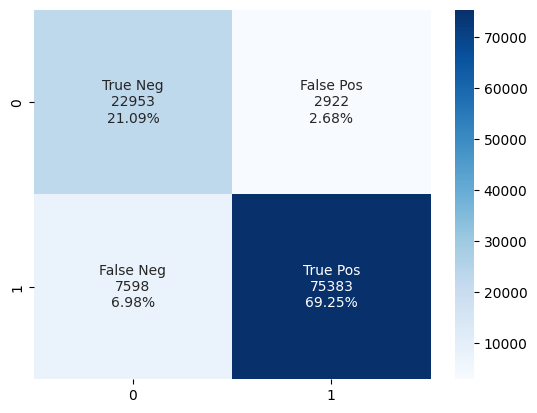

In [ ]:
cm8=confusion_matrix(y_test,y_hat)
group_names = ['True Neg','False Pos','False Neg','True Pos']
group_counts = ['{0:0.0f}'.format(value) for value in
                cm8.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     cm8.flatten()/np.sum(cm8)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cm8, annot=labels, fmt='', cmap='Blues')
plt.show()

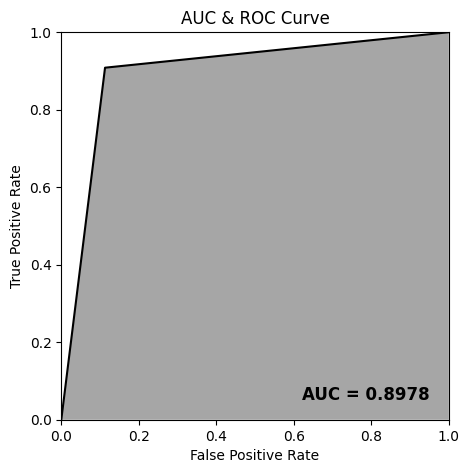

In [ ]:
AUC9 = metrics.roc_auc_score(y_test, y_hat)

false_positive_rate, true_positive_rate, thresolds = metrics.roc_curve(y_test, y_hat)

plt.figure(figsize=(5, 8), dpi=100)
plt.axis('scaled')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.title("AUC & ROC Curve")
plt.plot(false_positive_rate, true_positive_rate, 'black')
plt.fill_between(false_positive_rate, true_positive_rate, facecolor='grey', alpha=0.7)
plt.text(0.95, 0.05, 'AUC = %0.4f' % AUC9, ha='right', fontsize=12, weight='bold', color='black')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.show()

In [ ]:
matthews_corrcoef(y_test, y_hat)

0.7536458803178544

In [ ]:
import pickle
filenamexg='Xgboost all'
pickle.dump(second_trial,open(filenamexg,'wb'))

XGBoost with feature selected

In [ ]:
second_trial.fit(X_selected_trainxg, y_res1)

y_hatxg=second_trial.predict(X_selected_testxg)
y_train_hatxg=second_trial.predict(X_selected_trainxg)

In [ ]:
print(classification_report(y_res1,y_train_hatxg))

              precision    recall  f1-score   support

           0       0.91      0.95      0.93    331633
           1       0.94      0.91      0.93    331633

    accuracy                           0.93    663266
   macro avg       0.93      0.93      0.93    663266
weighted avg       0.93      0.93      0.93    663266



In [ ]:
print(classification_report(y_test,y_hatxg))

              precision    recall  f1-score   support

           0       0.75      0.87      0.80     25875
           1       0.96      0.91      0.93     82981

    accuracy                           0.90    108856
   macro avg       0.85      0.89      0.87    108856
weighted avg       0.91      0.90      0.90    108856



Accuracy for training data: % 92.86 
Test Accuracy is: % 89.92


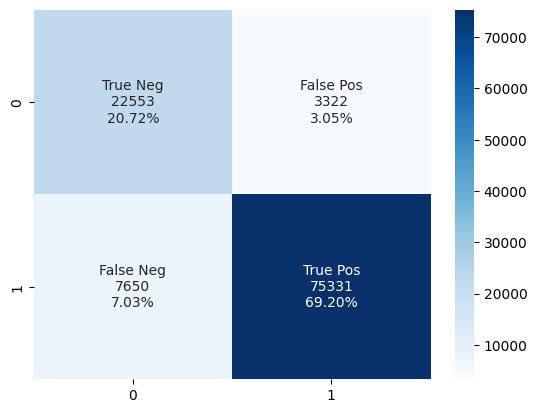

In [ ]:
print('Accuracy for training data: % {0:.2f} '.format(second_trial.score(X_selected_trainxg, y_res1)*100),end='\n' )
accuracy=accuracy_score(y_test,y_hatxg)
print('Test Accuracy is: % {0:.2f}'.format(accuracy*100))

cm_8=confusion_matrix(y_test,y_hatxg)
group_names = ['True Neg','False Pos','False Neg','True Pos']
group_counts = ['{0:0.0f}'.format(value) for value in
                cm_8.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     cm_8.flatten()/np.sum(cm_8)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cm_8, annot=labels, fmt='', cmap='Blues')
plt.show()

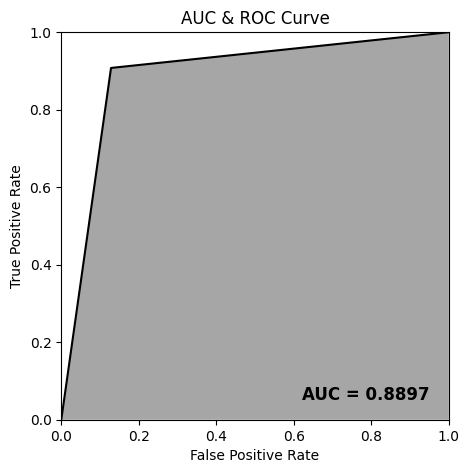

In [ ]:
AUC_9 = metrics.roc_auc_score(y_test, y_hatxg)

false_positive_rate, true_positive_rate, thresolds = metrics.roc_curve(y_test, y_hatxg)

plt.figure(figsize=(5, 8), dpi=100)
plt.axis('scaled')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.title("AUC & ROC Curve")
plt.plot(false_positive_rate, true_positive_rate, 'black')
plt.fill_between(false_positive_rate, true_positive_rate, facecolor='grey', alpha=0.7)
plt.text(0.95, 0.05, 'AUC = %0.4f' % AUC_9, ha='right', fontsize=12, weight='bold', color='black')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.show()

In [ ]:
matthews_corrcoef(y_test, y_hatxg)

0.7410038390642767

In [ ]:
filenamexg1='xgboost with specific Features'
pickle.dump(second_trial,open(filenamexg1,'wb'))

Xgboost with PCA

In [ ]:
PCA_xgtrial = XGBClassifier(random_state=42)


PCA_xgtrial.fit(X_train_transformed2, y_res1)
y_pca_xgpredicted = PCA_xgtrial.predict(X_test_transformed2)
y_trainpca_xgpredicted = PCA_xgtrial.predict(X_train_transformed2)
print(classification_report(y_res1,y_trainpca_xgpredicted))

              precision    recall  f1-score   support

           0       0.82      0.66      0.73    331633
           1       0.72      0.85      0.78    331633

    accuracy                           0.76    663266
   macro avg       0.77      0.76      0.76    663266
weighted avg       0.77      0.76      0.76    663266



In [ ]:
X_train_transformed2.shape

(663266, 3)

In [ ]:
print(classification_report(y_test,y_pca_xgpredicted))
print('Accuracy for training data: % {0:.2f} '.format(PCA_xgtrial.score(X_train_transformed2, y_res1)*100),end='\n' )
accuracy=accuracy_score(y_test,y_pca_xgpredicted)
print('Test Accuracy is: % {0:.2f}'.format(accuracy*100))

              precision    recall  f1-score   support

           0       0.53      0.55      0.54     25875
           1       0.86      0.85      0.85     82981

    accuracy                           0.78    108856
   macro avg       0.70      0.70      0.70    108856
weighted avg       0.78      0.78      0.78    108856

Accuracy for training data: % 75.87 
Test Accuracy is: % 77.86


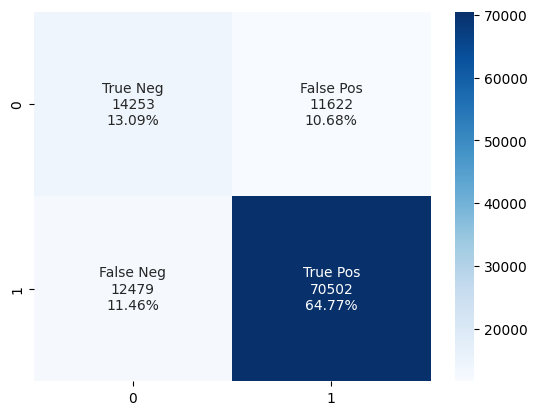

In [ ]:
cm20=confusion_matrix(y_test,y_pca_xgpredicted)
group_names = ['True Neg','False Pos','False Neg','True Pos']
group_counts = ['{0:0.0f}'.format(value) for value in
                cm20.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     cm20.flatten()/np.sum(cm20)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cm20, annot=labels, fmt='', cmap='Blues')
plt.show()

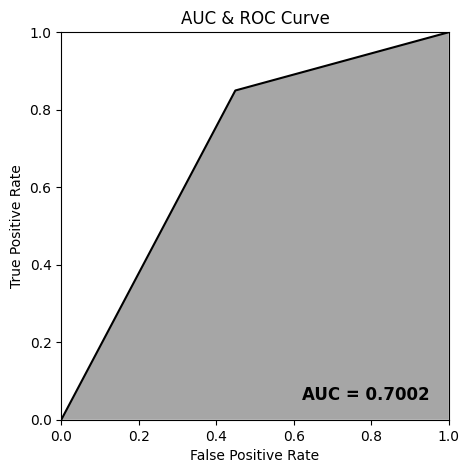

In [ ]:
AUC10 = metrics.roc_auc_score(y_test, y_pca_xgpredicted)

false_positive_rate, true_positive_rate, thresolds = metrics.roc_curve(y_test, y_pca_xgpredicted)

plt.figure(figsize=(5, 8), dpi=100)
plt.axis('scaled')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.title("AUC & ROC Curve")
plt.plot(false_positive_rate, true_positive_rate, 'black')
plt.fill_between(false_positive_rate, true_positive_rate, facecolor='grey', alpha=0.7)
plt.text(0.95, 0.05, 'AUC = %0.4f' % AUC10, ha='right', fontsize=12, weight='bold', color='black')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.show()

In [ ]:
matthews_corrcoef(y_test, y_pca_xgpredicted)

0.39603572497182404

In [ ]:
filenamexg2='xgboost with pca'
pickle.dump(PCA_xgtrial,open(filenamexg2,'wb'))

XGBoost with PCA 95 % variance

In [ ]:
PCA_xgtrial.fit(X_train_transformed_2, y_res1)
y_pca_xgpredicted2 = PCA_xgtrial.predict(X_test_transformed_2)
train_pca_xgpredicted2 = PCA_xgtrial.predict(X_train_transformed_2)

print(classification_report(y_res1,train_pca_xgpredicted2))

              precision    recall  f1-score   support

           0       0.74      0.58      0.65    331633
           1       0.66      0.80      0.72    331633

    accuracy                           0.69    663266
   macro avg       0.70      0.69      0.69    663266
weighted avg       0.70      0.69      0.69    663266



In [ ]:
print(classification_report(y_test,y_pca_xgpredicted2))
print('Accuracy for training data: % {0:.2f} '.format(PCA_xgtrial.score(X_train_transformed_2, y_res1)*100),end='\n' )
accuracy=accuracy_score(y_test,y_pca_xgpredicted2)
print('Test Accuracy is: % {0:.2f}'.format(accuracy*100))

              precision    recall  f1-score   support

           0       0.47      0.58      0.52     25875
           1       0.86      0.80      0.83     82981

    accuracy                           0.74    108856
   macro avg       0.66      0.69      0.67    108856
weighted avg       0.77      0.74      0.75    108856

Accuracy for training data: % 68.98 
Test Accuracy is: % 74.43


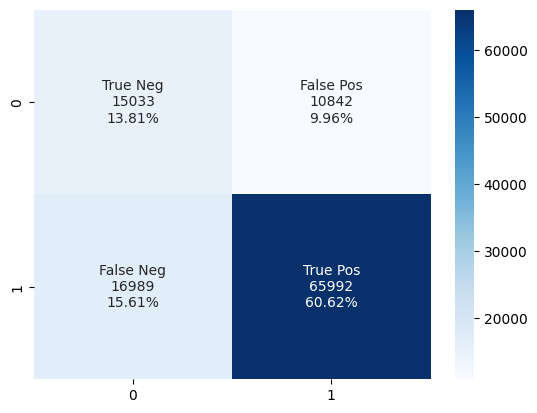

In [ ]:
cm_20=confusion_matrix(y_test,y_pca_xgpredicted2)
group_names = ['True Neg','False Pos','False Neg','True Pos']
group_counts = ['{0:0.0f}'.format(value) for value in
                cm_20.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     cm_20.flatten()/np.sum(cm_20)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cm_20, annot=labels, fmt='', cmap='Blues')
plt.show()

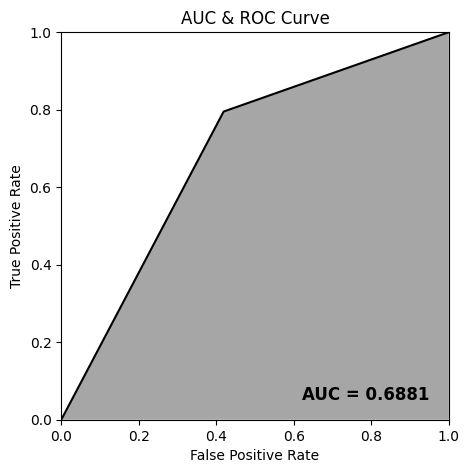

In [ ]:
AUC_10 = metrics.roc_auc_score(y_test, y_pca_xgpredicted2)

false_positive_rate, true_positive_rate, thresolds = metrics.roc_curve(y_test, y_pca_xgpredicted2)

plt.figure(figsize=(5, 8), dpi=100)
plt.axis('scaled')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.title("AUC & ROC Curve")
plt.plot(false_positive_rate, true_positive_rate, 'black')
plt.fill_between(false_positive_rate, true_positive_rate, facecolor='grey', alpha=0.7)
plt.text(0.95, 0.05, 'AUC = %0.4f' % AUC_10, ha='right', fontsize=12, weight='bold', color='black')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.show()

In [ ]:
matthews_corrcoef(y_test, y_pca_xgpredicted2)

0.3514853735591049

In [ ]:
filenamexg3='xgboost with pca 95 % variance'
pickle.dump(PCA_xgtrial,open(filenamexg3,'wb'))

selected features by ANOVA

In [ ]:
from xgboost import XGBClassifier

s_trial=XGBClassifier(n_estimators=6,random_state=42,max_depth =9)


s_trial.fit(X_train_features, y_res1)
y__hat = s_trial.predict(X_test_features)
y__trainhat = s_trial.predict(X_train_features)
print(classification_report(y_res1,y__trainhat))

              precision    recall  f1-score   support

           0       0.94      0.95      0.95    331633
           1       0.95      0.94      0.94    331633

    accuracy                           0.95    663266
   macro avg       0.95      0.95      0.95    663266
weighted avg       0.95      0.95      0.95    663266



              precision    recall  f1-score   support

           0       0.82      0.88      0.85     25875
           1       0.96      0.94      0.95     82981

    accuracy                           0.92    108856
   macro avg       0.89      0.91      0.90    108856
weighted avg       0.93      0.92      0.93    108856

Accuracy for training data: % 94.51 
Test Accuracy is: % 92.43


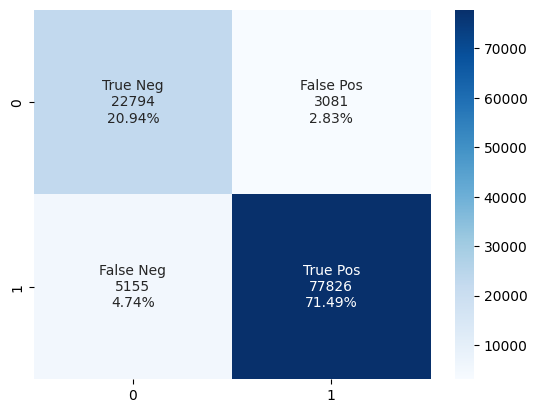

In [ ]:
print(classification_report(y_test,y__hat))
print('Accuracy for training data: % {0:.2f} '.format(s_trial.score(X_train_features, y_res1)*100),end='\n' )
accuracy=accuracy_score(y_test,y__hat)
print('Test Accuracy is: % {0:.2f}'.format(accuracy*100))

cm9=confusion_matrix(y_test,y__hat)
group_names = ['True Neg','False Pos','False Neg','True Pos']
group_counts = ['{0:0.0f}'.format(value) for value in
                cm9.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     cm9.flatten()/np.sum(cm9)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cm9, annot=labels, fmt='', cmap='Blues')
plt.show()

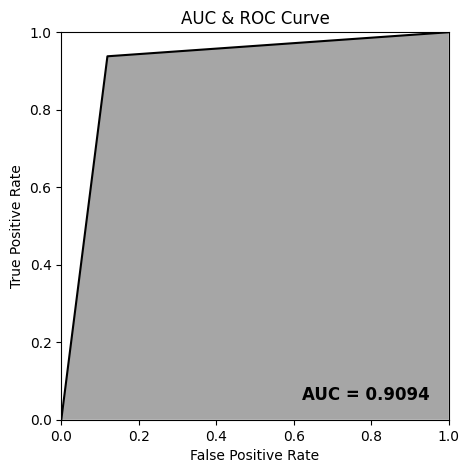

In [ ]:
AUC11 = metrics.roc_auc_score(y_test, y__hat)

false_positive_rate, true_positive_rate, thresolds = metrics.roc_curve(y_test, y__hat)

plt.figure(figsize=(5, 8), dpi=100)
plt.axis('scaled')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.title("AUC & ROC Curve")
plt.plot(false_positive_rate, true_positive_rate, 'black')
plt.fill_between(false_positive_rate, true_positive_rate, facecolor='grey', alpha=0.7)
plt.text(0.95, 0.05, 'AUC = %0.4f' % AUC11, ha='right', fontsize=12, weight='bold', color='black')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.show()

In [ ]:
matthews_corrcoef(y_test, y__hat)

0.7978729630781812

In [ ]:
filenamexg4='xgboost with Anova'
pickle.dump(s_trial,open(filenamexg4,'wb'))

Selected Features By IG

In [ ]:
IG_XG_trial = XGBClassifier(n_estimators=6,random_state=42,max_depth =9)


IG_XG_trial.fit(IG_train_features, y_res1)
IGY_XG_predict = IG_XG_trial.predict(IG_test_features)
IGY_trainXG_predict = IG_XG_trial.predict(IG_train_features)

print(classification_report(y_res1,IGY_trainXG_predict))

              precision    recall  f1-score   support

           0       0.94      0.95      0.94    331633
           1       0.95      0.94      0.94    331633

    accuracy                           0.94    663266
   macro avg       0.94      0.94      0.94    663266
weighted avg       0.94      0.94      0.94    663266



In [ ]:
print(classification_report(y_test,IGY_XG_predict))
print('Accuracy for training data: % {0:.2f} '.format(IG_XG_trial.score(IG_train_features, y_res1)*100),end='\n' )
accuracy=accuracy_score(y_test,IGY_XG_predict)
print('Test Accuracy is: % {0:.2f}'.format(accuracy*100))

              precision    recall  f1-score   support

           0       0.82      0.88      0.84     25875
           1       0.96      0.94      0.95     82981

    accuracy                           0.92    108856
   macro avg       0.89      0.91      0.90    108856
weighted avg       0.93      0.92      0.92    108856

Accuracy for training data: % 94.42 
Test Accuracy is: % 92.36


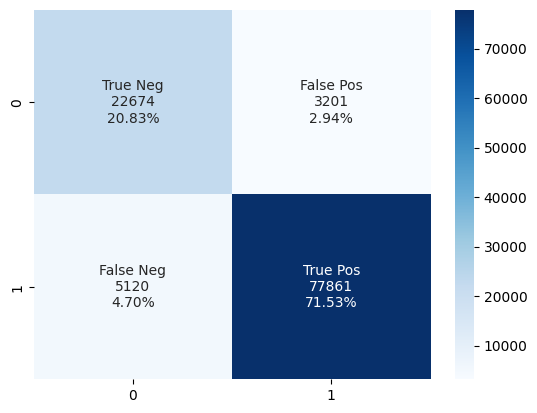

In [ ]:
cm10=confusion_matrix(y_test,IGY_XG_predict)
group_names = ['True Neg','False Pos','False Neg','True Pos']
group_counts = ['{0:0.0f}'.format(value) for value in
                cm10.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     cm10.flatten()/np.sum(cm10)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cm10, annot=labels, fmt='', cmap='Blues')
plt.show()

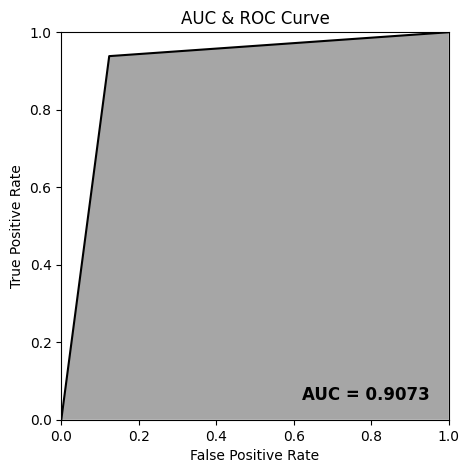

In [ ]:
AUC12 = metrics.roc_auc_score(y_test, IGY_XG_predict)

false_positive_rate, true_positive_rate, thresolds = metrics.roc_curve(y_test, IGY_XG_predict)

plt.figure(figsize=(5, 8), dpi=100)
plt.axis('scaled')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.title("AUC & ROC Curve")
plt.plot(false_positive_rate, true_positive_rate, 'black')
plt.fill_between(false_positive_rate, true_positive_rate, facecolor='grey', alpha=0.7)
plt.text(0.95, 0.05, 'AUC = %0.4f' % AUC12, ha='right', fontsize=12, weight='bold', color='black')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.show()

In [ ]:
matthews_corrcoef(y_test, IGY_XG_predict)

0.7952137117961374

In [ ]:
filenamexg5='xgboost with IG'
pickle.dump(IG_XG_trial,open(filenamexg5,'wb'))

# Logistic Regression

LR with All features

In [ ]:
from sklearn.linear_model import LogisticRegression

classifier__=LogisticRegression(random_state=42)

classifier__.fit(x__scaled__train_df, y_res1)

Y= classifier__.predict(x__scaled__test_df)
Y_train_all= classifier__.predict(x__scaled__train_df)

print(classification_report(y_res1,Y_train_all),end='\n')


c:\Users\Urgent\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


              precision    recall  f1-score   support

           0       0.80      0.82      0.81    331633
           1       0.81      0.79      0.80    331633

    accuracy                           0.80    663266
   macro avg       0.80      0.80      0.80    663266
weighted avg       0.80      0.80      0.80    663266



              precision    recall  f1-score   support

           0       0.54      0.80      0.65     25875
           1       0.93      0.79      0.85     82981

    accuracy                           0.79    108856
   macro avg       0.74      0.80      0.75    108856
weighted avg       0.84      0.79      0.81    108856

Accuracy for training : % 80.43
Accuracy for test % 79.35


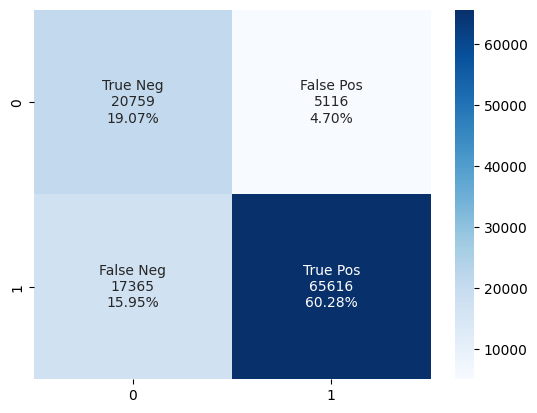

In [ ]:
print(classification_report(y_test,Y),end='\n')

print('Accuracy for training : % {0:.2f}'.format(classifier__.score(x__scaled__train_df, y_res1)*100,end='\n'))
print('Accuracy for test % {0:.2f}'.format(accuracy_score(y_test,Y)*100))

cm13=confusion_matrix(y_test,Y)
group_names = ['True Neg','False Pos','False Neg','True Pos']
group_counts = ['{0:0.0f}'.format(value) for value in
                cm13.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     cm13.flatten()/np.sum(cm13)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cm13, annot=labels, fmt='', cmap='Blues')
plt.show()


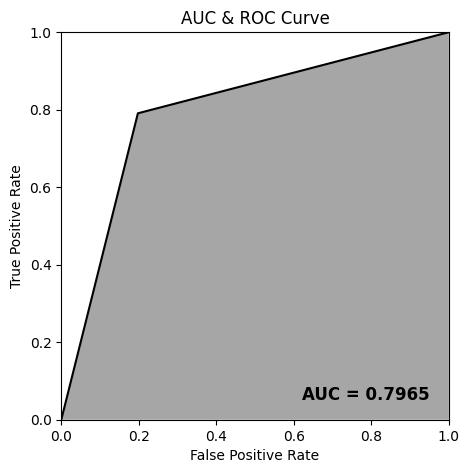

In [ ]:
AUC13 = metrics.roc_auc_score(y_test, Y)

false_positive_rate, true_positive_rate, thresolds = metrics.roc_curve(y_test, Y)

plt.figure(figsize=(5, 8), dpi=100)
plt.axis('scaled')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.title("AUC & ROC Curve")
plt.plot(false_positive_rate, true_positive_rate, 'black')
plt.fill_between(false_positive_rate, true_positive_rate, facecolor='grey', alpha=0.7)
plt.text(0.95, 0.05, 'AUC = %0.4f' % AUC13, ha='right', fontsize=12, weight='bold', color='black')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.show()

In [ ]:
matthews_corrcoef(y_test, Y)

0.5291615737601196

In [ ]:
filenamLR='LR with all Features'
pickle.dump(classifier__,open(filenamLR,'wb'))

LR with PCA

In [ ]:
LR_pca_trial = LogisticRegression(random_state=42)

LR_pca_trial.fit(X_train_transformed2, y_res1)
y_LR_pca_predicted = LR_pca_trial.predict(X_test_transformed2)
y_trainLR_pca_predicted = LR_pca_trial.predict(X_train_transformed2)


print(classification_report(y_res1,y_trainLR_pca_predicted))


              precision    recall  f1-score   support

           0       0.59      0.80      0.68    331633
           1       0.69      0.45      0.55    331633

    accuracy                           0.63    663266
   macro avg       0.64      0.63      0.61    663266
weighted avg       0.64      0.63      0.61    663266



In [ ]:
print(classification_report(y_test,y_LR_pca_predicted))
print('Accuracy for training data: % {0:.2f} '.format(LR_pca_trial.score(X_train_transformed2, y_res1)*100),end='\n' )
accuracy=accuracy_score(y_test,y_LR_pca_predicted)
print('Test Accuracy is: % {0:.2f}'.format(accuracy*100))


              precision    recall  f1-score   support

           0       0.31      0.79      0.45     25875
           1       0.88      0.45      0.60     82981

    accuracy                           0.54    108856
   macro avg       0.59      0.62      0.52    108856
weighted avg       0.74      0.54      0.56    108856

Accuracy for training data: % 62.52 
Test Accuracy is: % 53.51


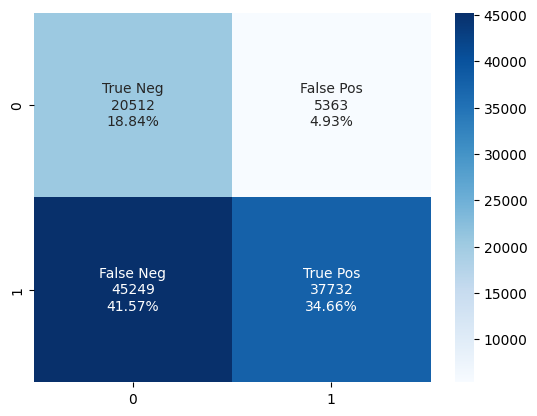

In [ ]:
cm15=confusion_matrix(y_test,y_LR_pca_predicted)
group_names = ['True Neg','False Pos','False Neg','True Pos']
group_counts = ['{0:0.0f}'.format(value) for value in
                cm15.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     cm15.flatten()/np.sum(cm15)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cm15, annot=labels, fmt='', cmap='Blues')
plt.show()

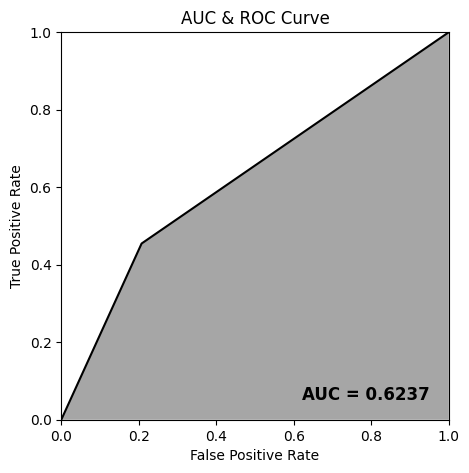

In [ ]:
AUC14 = metrics.roc_auc_score(y_test, y_LR_pca_predicted)

false_positive_rate, true_positive_rate, thresolds = metrics.roc_curve(y_test, y_LR_pca_predicted)

plt.figure(figsize=(5, 8), dpi=100)
plt.axis('scaled')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.title("AUC & ROC Curve")
plt.plot(false_positive_rate, true_positive_rate, 'black')
plt.fill_between(false_positive_rate, true_positive_rate, facecolor='grey', alpha=0.7)
plt.text(0.95, 0.05, 'AUC = %0.4f' % AUC14, ha='right', fontsize=12, weight='bold', color='black')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.show()

In [ ]:
matthews_corrcoef(y_test, y_LR_pca_predicted)

0.2153789091859345

In [ ]:
filenamLRpca='LR with pca'
pickle.dump(LR_pca_trial,open(filenamLRpca,'wb'))

LR with PCA 95 % variance

In [ ]:
LR_pca_trial.fit(X_train_transformed_2, y_res1)
y_pca_LRpredicted2 = LR_pca_trial.predict(X_test_transformed_2)
train_pca_LRpredicted2 = LR_pca_trial.predict(X_train_transformed_2)

print(classification_report(y_res1,train_pca_LRpredicted2))

c:\Users\Urgent\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.00      0.00      0.00    331633
           1       0.50      1.00      0.67    331633

    accuracy                           0.50    663266
   macro avg       0.25      0.50      0.33    663266
weighted avg       0.25      0.50      0.33    663266



c:\Users\Urgent\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Urgent\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
print(classification_report(y_test,y_pca_LRpredicted2))
print('Accuracy for training data: % {0:.2f} '.format(LR_pca_trial.score(X_train_transformed_2, y_res1)*100),end='\n' )
accuracy=accuracy_score(y_test,y_pca_LRpredicted2)
print('Test Accuracy is: % {0:.2f}'.format(accuracy*100))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00     25875
           1       0.76      1.00      0.87     82981

    accuracy                           0.76    108856
   macro avg       0.38      0.50      0.43    108856
weighted avg       0.58      0.76      0.66    108856

Accuracy for training data: % 50.00 
Test Accuracy is: % 76.23


c:\Users\Urgent\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Urgent\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Urgent\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average,

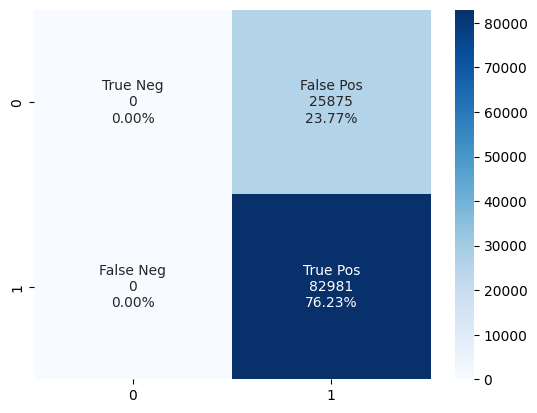

In [ ]:
cm_15=confusion_matrix(y_test,y_pca_LRpredicted2)
group_names = ['True Neg','False Pos','False Neg','True Pos']
group_counts = ['{0:0.0f}'.format(value) for value in
                cm_15.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     cm_15.flatten()/np.sum(cm_15)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cm_15, annot=labels, fmt='', cmap='Blues')
plt.show()

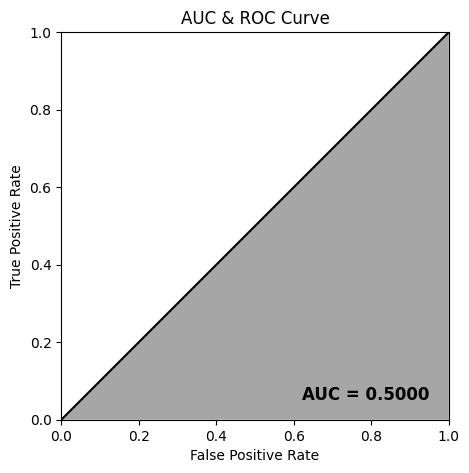

In [ ]:
AUC_14 = metrics.roc_auc_score(y_test, y_pca_LRpredicted2)

false_positive_rate, true_positive_rate, thresolds = metrics.roc_curve(y_test, y_pca_LRpredicted2)

plt.figure(figsize=(5, 8), dpi=100)
plt.axis('scaled')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.title("AUC & ROC Curve")
plt.plot(false_positive_rate, true_positive_rate, 'black')
plt.fill_between(false_positive_rate, true_positive_rate, facecolor='grey', alpha=0.7)
plt.text(0.95, 0.05, 'AUC = %0.4f' % AUC_14, ha='right', fontsize=12, weight='bold', color='black')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.show()

In [ ]:
matthews_corrcoef(y_test, y_pca_LRpredicted2)

0.0

In [ ]:
filenamLRpca2='LR with pca 95 % variance'
pickle.dump(LR_pca_trial,open(filenamLRpca2,'wb'))

LR With IG

In [ ]:
LR_IG_trial = LogisticRegression(random_state=42)


LR_IG_trial.fit(IG_train_features, y_res1)
IGY_LR_predict = LR_IG_trial.predict(IG_test_features)
IGY_trainLR_predict = LR_IG_trial.predict(IG_train_features)

print(classification_report(y_res1,IGY_trainLR_predict))


              precision    recall  f1-score   support

           0       0.79      0.83      0.81    331633
           1       0.82      0.77      0.80    331633

    accuracy                           0.80    663266
   macro avg       0.80      0.80      0.80    663266
weighted avg       0.80      0.80      0.80    663266



In [ ]:
print(classification_report(y_test,IGY_LR_predict))

print('Accuracy for training data: % {0:.2f} '.format(LR_IG_trial.score(IG_train_features, y_res1)*100),end='\n' )
accuracy=accuracy_score(y_test,IGY_LR_predict)
print('Test Accuracy is: % {0:.2f}'.format(accuracy*100))

              precision    recall  f1-score   support

           0       0.53      0.82      0.64     25875
           1       0.93      0.77      0.85     82981

    accuracy                           0.78    108856
   macro avg       0.73      0.80      0.74    108856
weighted avg       0.84      0.78      0.80    108856

Accuracy for training data: % 80.19 
Test Accuracy is: % 78.45


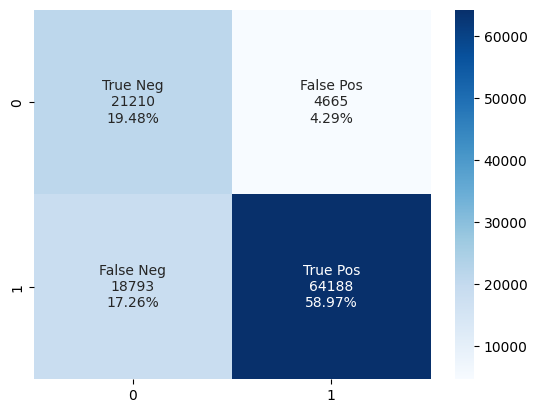

In [ ]:
cm16=confusion_matrix(y_test,IGY_LR_predict)
group_names = ['True Neg','False Pos','False Neg','True Pos']
group_counts = ['{0:0.0f}'.format(value) for value in
                cm16.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     cm16.flatten()/np.sum(cm16)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cm16, annot=labels, fmt='', cmap='Blues')
plt.show()

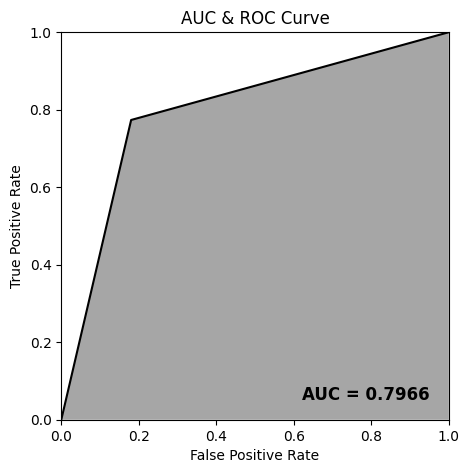

In [ ]:
AUC15 = metrics.roc_auc_score(y_test, IGY_LR_predict)

false_positive_rate, true_positive_rate, thresolds = metrics.roc_curve(y_test, IGY_LR_predict)

plt.figure(figsize=(5, 8), dpi=100)
plt.axis('scaled')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.title("AUC & ROC Curve")
plt.plot(false_positive_rate, true_positive_rate, 'black')
plt.fill_between(false_positive_rate, true_positive_rate, facecolor='grey', alpha=0.7)
plt.text(0.95, 0.05, 'AUC = %0.4f' % AUC15, ha='right', fontsize=12, weight='bold', color='black')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.show()

In [ ]:
matthews_corrcoef(y_test, IGY_LR_predict)

0.5237810047718169

In [ ]:
filenamLR2='LR with IG'
pickle.dump(LR_IG_trial,open(filenamLR2,'wb'))

LR selected features by anova

In [ ]:
from sklearn.linear_model import LogisticRegression

classifier__1=LogisticRegression(random_state=42)

classifier__1.fit(X_train_features, y_res1)

Y_1= classifier__1.predict(X_test_features)
Ytrain_1= classifier__1.predict(X_train_features)


print(classification_report(y_res1,Ytrain_1),end='\n')


              precision    recall  f1-score   support

           0       0.78      0.81      0.80    331633
           1       0.81      0.77      0.79    331633

    accuracy                           0.79    663266
   macro avg       0.79      0.79      0.79    663266
weighted avg       0.79      0.79      0.79    663266



In [ ]:
print(classification_report(y_test,Y_1),end='\n')

print('Accuracy for training : % {0:.2f}'.format(classifier__1.score(X_train_features, y_res1)*100,end='\n'))
print('Accuracy for test % {0:.2f}'.format(accuracy_score(y_test,Y_1)*100))

              precision    recall  f1-score   support

           0       0.53      0.80      0.64     25875
           1       0.93      0.77      0.84     82981

    accuracy                           0.78    108856
   macro avg       0.73      0.79      0.74    108856
weighted avg       0.83      0.78      0.79    108856

Accuracy for training : % 79.37
Accuracy for test % 78.15


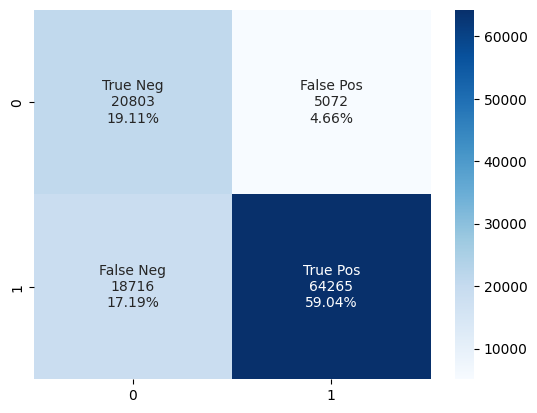

In [ ]:
cm17=confusion_matrix(y_test,Y_1)
group_names = ['True Neg','False Pos','False Neg','True Pos']
group_counts = ['{0:0.0f}'.format(value) for value in
                cm17.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     cm17.flatten()/np.sum(cm17)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cm17, annot=labels, fmt='', cmap='Blues')
plt.show()

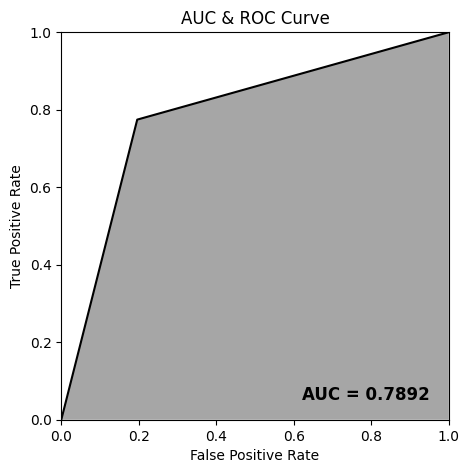

In [ ]:
AUC16 = metrics.roc_auc_score(y_test, Y_1)

false_positive_rate, true_positive_rate, thresolds = metrics.roc_curve(y_test, Y_1)

plt.figure(figsize=(5, 8), dpi=100)
plt.axis('scaled')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.title("AUC & ROC Curve")
plt.plot(false_positive_rate, true_positive_rate, 'black')
plt.fill_between(false_positive_rate, true_positive_rate, facecolor='grey', alpha=0.7)
plt.text(0.95, 0.05, 'AUC = %0.4f' % AUC16, ha='right', fontsize=12, weight='bold', color='black')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.show()

In [ ]:
matthews_corrcoef(y_test, Y_1)

0.5120337998031782

In [ ]:
filenameLR3='LR with Annova'
pickle.dump(classifier__1,open(filenameLR3,'wb'))